In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import sys
import matplotlib as mpl

In [2]:
from IPython.display import display, HTML, Markdown
display(HTML("<style>.container { width:100% !important; }</style>"))
display(HTML("<style>div.output_scroll { height: 44em; }</style>"))

In [3]:
sys.path.append("/home/surajrai1900/Particle_Gun")

In [4]:
import create_file
import watchmal_dependencies.binning as bins
import Classification_model 
import cuts
from utils import classification_metrics, plot

In [5]:
font = {'family' : 'DejaVu Sans',
        'weight' : 'normal',
        'size'   : 28}
mpl.rc('font', **font)
mpl.rcParams['figure.figsize'] = (12, 9)
mpl.rcParams["figure.autolayout"] = True

In [6]:
# Creating relevant features dataframe for e/mu analysis , one has no preselection applied and other has preselection applied

df = create_file.relevant_df(apply_presel=False, select_labels=[1, 2], discriminator=True)
df_base = create_file.relevant_df(apply_presel=True, select_labels=[1, 2], discriminator=True)

cut_nick = ((df['h5_dwall'] > 50) 
            & (df['h5_vetos'] == 0) 
            & (df['h5_nhits'] > 25) 
            & (df['flag_e'] == 0) 
            & (df['flag_mu'] == 0) 
            & (((df['h5_towall']/100) > (0.63*np.log(df['h5_momentum']) - 2)) | ~np.in1d(df['h5_labels'], [0,1]))
           )

cut_base = ((df['reco_electron_dwall'] > 50)
            & (df['reco_electron_towall'] > 100)
            & (df['reco_electron_mom'] > 100)
            & ~((df['h5_labels'] == 2) & ~(df['h5_momentum'] > 2 * df['h5_dwall']))
           )
df_nick = df[cut_nick]


In [7]:
df

,pe,pmu,h5_labels,h5_momentum,h5_towall,h5_dwall,cos_zenith,azimuth,event_index,h5_vetos,...,reco_electron_mom,reco_electron_dwall,reco_electron_towall,pi0_mass,flag_e,flag_mu,flag_pi0,true_sig,fq_discriminator,softmax_discriminator
1182377,1.000000e+00,1.021306e-10,1,245.001085,190.761574,64.608521,-0.723887,-115.434723,0,False,...,206.956848,78.522018,180.486992,7.229472,0,0,1,1,13.992118,0.354346
1182378,9.999999e-01,9.966448e-08,1,855.768398,337.385819,67.418274,0.391861,146.188995,1,False,...,842.675598,75.189301,348.900632,79.580574,0,0,0,1,600.142578,0.354346
1182379,9.999872e-01,1.277478e-05,1,597.023336,138.040446,60.461700,-0.892171,-123.714195,2,False,...,233.178909,77.010956,151.587330,1.507910,1,1,0,1,41.082775,0.354333
1182380,9.999959e-01,4.041329e-06,1,402.785832,251.795181,176.367126,0.700439,-35.238598,3,False,...,382.876282,176.663071,251.733536,6.669949,0,0,0,1,192.432541,0.354342
1182381,9.999942e-01,5.822238e-06,1,830.345780,267.159357,187.088364,0.467167,162.244781,4,False,...,906.258545,188.501816,259.277523,10.406991,0,0,0,1,1209.833496,0.354340
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3524477,5.142843e-19,1.000000e+00,2,579.695268,491.248047,31.538849,-0.064201,119.118027,7064962,False,...,328.118530,47.647659,286.661499,24.705700,0,0,0,0,-308.275787,-0.645654
3524478,4.464603e-27,1.000000e+00,2,1001.043398,178.580150,129.652344,-0.635664,-128.650803,7064963,True,...,400.317322,138.309235,175.155650,13.315305,1,0,2,0,-231.610352,-0.645654
3524479,6.590432e-01,3.409568e-01,2,945.693831,33.418060,31.273712,0.305655,81.230019,7064964,True,...,18.327209,9.576324,597.651026,41.853645,0,0,1,0,120.456078,0.013389
3524480,2.498987e-09,1.000000e+00,2,889.349346,372.878450,298.996674,0.294807,-82.344650,7064965,False,...,771.922607,280.669922,326.482257,8.297816,0,0,2,0,-318.540100,-0.645654


In [8]:
df_base

,pe,pmu,h5_labels,h5_momentum,h5_towall,h5_dwall,cos_zenith,azimuth,event_index,h5_vetos,...,reco_electron_mom,reco_electron_dwall,reco_electron_towall,pi0_mass,flag_e,flag_mu,flag_pi0,true_sig,fq_discriminator,softmax_discriminator
1182377,1.000000e+00,1.021306e-10,1,245.001085,190.761574,64.608521,-0.723887,-115.434723,0,False,...,206.956848,78.522018,180.486992,7.229472,0,0,1,1,22.948589,0.369043
1182378,9.999999e-01,9.966448e-08,1,855.768398,337.385819,67.418274,0.391861,146.188995,1,False,...,842.675598,75.189301,348.900632,79.580574,0,0,0,1,513.741211,0.369043
1182379,9.999872e-01,1.277478e-05,1,597.023336,138.040446,60.461700,-0.892171,-123.714195,2,False,...,233.178909,77.010956,151.587330,1.507910,1,1,0,1,46.105938,0.369030
1182380,9.999959e-01,4.041329e-06,1,402.785832,251.795181,176.367126,0.700439,-35.238598,3,False,...,382.876282,176.663071,251.733536,6.669949,0,0,0,1,175.001099,0.369039
1182381,9.999942e-01,5.822238e-06,1,830.345780,267.159357,187.088364,0.467167,162.244781,4,False,...,906.258545,188.501816,259.277523,10.406991,0,0,0,1,1113.894775,0.369037
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3524471,9.076331e-16,1.000000e+00,2,709.561183,265.558551,95.014374,0.342564,6.189363,7064956,True,...,558.464844,105.628418,235.168786,43.944153,0,0,0,0,-291.022583,-0.630957
3524474,3.064815e-11,1.000000e+00,2,350.665030,543.774475,77.192368,0.961442,88.804344,7064959,False,...,140.788834,131.853897,481.732300,0.376510,0,0,0,0,-127.121681,-0.630957
3524475,3.261246e-06,9.999967e-01,2,527.210268,135.545402,101.175323,0.447474,-145.831833,7064960,True,...,333.796509,96.432709,120.223535,44.882015,1,0,1,0,-1.294128,-0.630954
3524478,4.464603e-27,1.000000e+00,2,1001.043398,178.580150,129.652344,-0.635664,-128.650803,7064963,True,...,400.317322,138.309235,175.155650,13.315305,1,0,2,0,-251.657959,-0.630957


In [9]:
df_nick

,pe,pmu,h5_labels,h5_momentum,h5_towall,h5_dwall,cos_zenith,azimuth,event_index,h5_vetos,...,reco_electron_mom,reco_electron_dwall,reco_electron_towall,pi0_mass,flag_e,flag_mu,flag_pi0,true_sig,fq_discriminator,softmax_discriminator
1182377,1.000000e+00,1.021306e-10,1,245.001085,190.761574,64.608521,-0.723887,-115.434723,0,False,...,206.956848,78.522018,180.486992,7.229472,0,0,1,1,13.992118,0.354346
1182378,9.999999e-01,9.966448e-08,1,855.768398,337.385819,67.418274,0.391861,146.188995,1,False,...,842.675598,75.189301,348.900632,79.580574,0,0,0,1,600.142578,0.354346
1182380,9.999959e-01,4.041329e-06,1,402.785832,251.795181,176.367126,0.700439,-35.238598,3,False,...,382.876282,176.663071,251.733536,6.669949,0,0,0,1,192.432541,0.354342
1182381,9.999942e-01,5.822238e-06,1,830.345780,267.159357,187.088364,0.467167,162.244781,4,False,...,906.258545,188.501816,259.277523,10.406991,0,0,0,1,1209.833496,0.354340
1182383,1.000000e+00,5.579116e-09,1,110.139975,336.769257,228.221008,0.677678,-83.315208,6,False,...,103.835281,233.385254,385.493256,25.493580,0,0,0,1,290.036255,0.354346
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3524463,1.005716e-10,1.000000e+00,2,734.157943,335.804382,282.255981,-0.946218,-46.001038,7064948,False,...,597.429199,263.426941,271.992249,32.483910,0,0,0,0,-293.930603,-0.645654
3524466,5.587158e-07,9.999995e-01,2,643.504111,334.895630,205.189957,0.612698,-38.103199,7064951,False,...,466.695740,195.590164,304.270508,10.840405,0,0,0,0,-149.386444,-0.645654
3524470,1.830553e-10,1.000000e+00,2,513.414347,423.202271,68.351227,-0.615225,-73.015755,7064955,False,...,308.221466,82.055115,374.291931,17.685396,0,0,0,0,-205.613647,-0.645654
3524474,3.064815e-11,1.000000e+00,2,350.665030,543.774475,77.192368,0.961442,88.804344,7064959,False,...,140.788834,131.853897,481.732300,0.376510,0,0,0,0,-146.003357,-0.645654


In [10]:
df_e = df[df['h5_labels'] == 1]
print(f'The length of Dataframe is: {len(df_e)}')
print('\n')
print(f"The zero muon flag count is {np.sum(df_e['flag_mu'] == 0)}")
print(f"The one muon flag count is {np.sum(df_e['flag_mu'] == 1)}")
print(f"The negative muon flag count is {np.sum(df_e['flag_mu'] < 0)}")
print('\n')
print(f"The zero electron flag count is {np.sum(df_e['flag_e'] == 0)}")
print(f"The one electron flag count is {np.sum(df_e['flag_e'] == 1)}")
print(f"The negative electron flag count is {np.sum(df_e['flag_e'] < 0)}")

df_mu = df[df['h5_labels'] == 2]
print(f'The length of Dataframe is: {len(df_mu)}')
print('\n')
print(f"The zero muon flag count is {np.sum(df_mu['flag_mu'] == 0)}")
print(f"The one muon flag count is {np.sum(df_mu['flag_mu'] == 1)}")
print(f"The negative muon flag count is {np.sum(df_mu['flag_mu'] < 0)}")
print('\n')
print(f"The zero electron flag count is {np.sum(df_mu['flag_e'] == 0)}")
print(f"The one electron flag count is {np.sum(df_mu['flag_e'] == 1)}")
print(f"The negative electron flag count is {np.sum(df_mu['flag_e'] < 0)}")

The length of Dataframe is: 1175265


The zero muon flag count is 977514
The one muon flag count is 196594
The negative muon flag count is 1157


The zero electron flag count is 962134
The one electron flag count is 212758
The negative electron flag count is 373
The length of Dataframe is: 1159710


The zero muon flag count is 1099289
The one muon flag count is 60400
The negative muon flag count is 21


The zero electron flag count is 906425
The one electron flag count is 253270
The negative electron flag count is 15


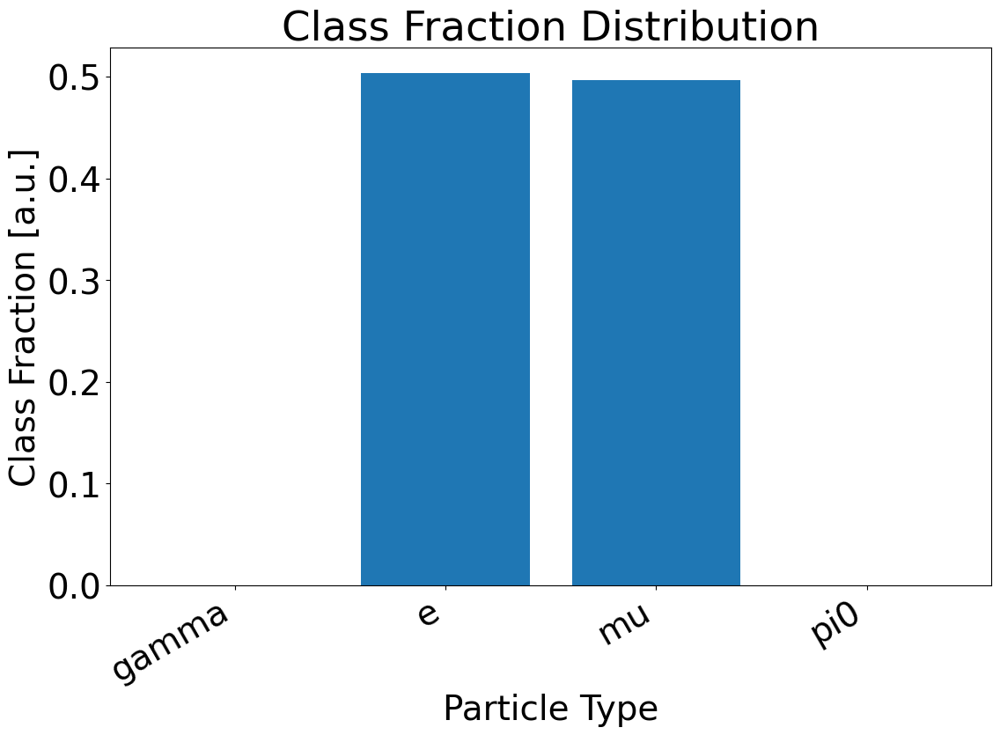

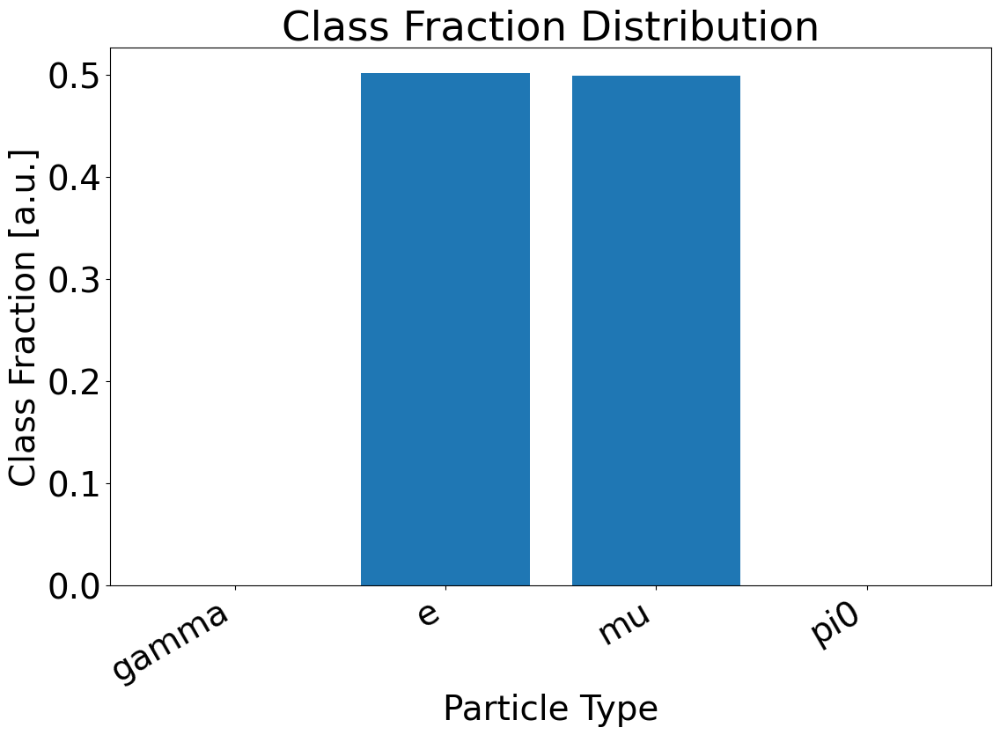

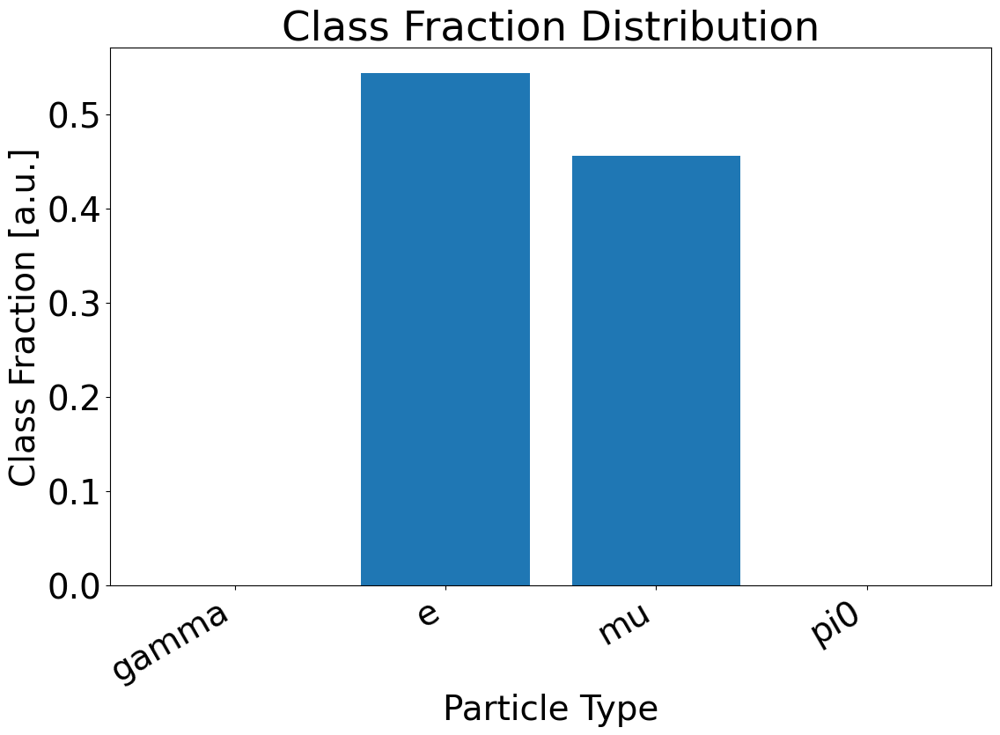

<Figure size 1200x900 with 0 Axes>

In [11]:
#Plotting class fraction for both the dataframes

plot.class_frac(df)
plot.class_frac(df_base)
plot.class_frac(df_nick)

## The true muon count for nicks preselection is lower when compared with no preselection and reco data preselection, this is due to the vetos cut which selects particles which are inside the detector and since relatively more muons exit the detector, their count decreases. Also lets see what the electron containment cut does.

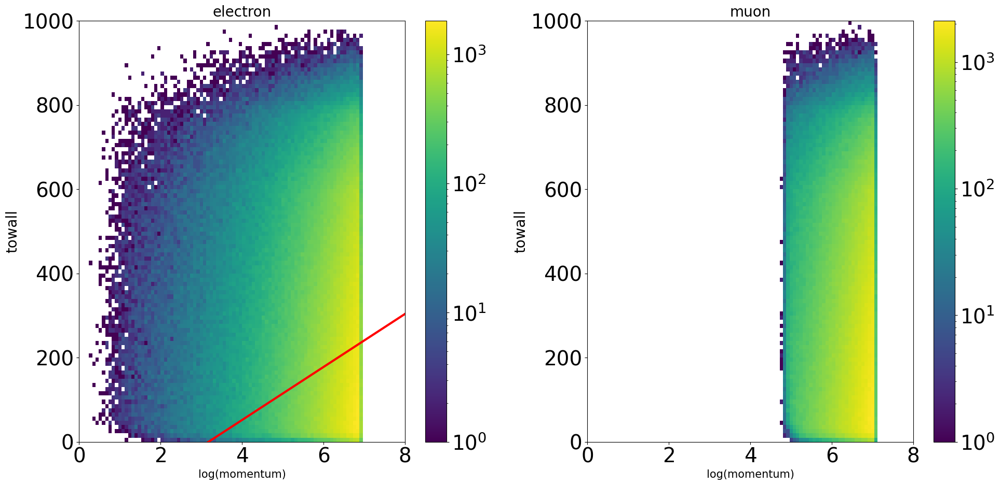

In [12]:
# df['h5_towall']/100) > (0.63*np.log(df['h5_momentum']) - 2)

df_e = df[df['h5_labels'] == 1]
df_mu = df[df['h5_labels'] == 2]

fig, ax = plt.subplots(1, 2, figsize=(20, 10))
im = ax[0].hist2d(np.log(df_e['h5_momentum']), df_e['h5_towall'], bins=[100, 100], range=[[0, 8], [0, 1000]], norm=mpl.colors.LogNorm())
ax[0].set_title('electron', fontsize=20)
ax[0].set_xlabel('log(momentum)', fontsize=15)
ax[0].set_ylabel('towall', fontsize=20)
plt.colorbar(im[3], ax=ax[0])

im = ax[1].hist2d(np.log(df_mu['h5_momentum']), df_mu['h5_towall'], bins=[100, 100], range=[[0, 8], [0, 1000]], norm=mpl.colors.LogNorm())
ax[1].set_title('muon', fontsize=20)
ax[1].set_xlabel('log(momentum)', fontsize=15)
ax[1].set_ylabel('towall', fontsize=20)
plt.colorbar(im[3], ax=ax[1])

x = np.linspace(0, 10, 100)
y = 100*(0.63*x -2)
ax[0].plot(x,y, color = "red", linewidth =3)

plt.show()

## The electron containment cut removes true electrons which reside in the region of high momentum and low towall. This cut might ensure that only electrons which do not leave the detector are considered. A similar muon containment cut could also be applied (which is not applied here, probably because we want electron signal, or muons are largely already removed by the vetos cut), Choosing only particles not exiting the detectors helps ensure clean and properly reconstructed data is obtained.

In [13]:
# Lets see how the actual particle counts are affected for each cut to see their individual effect
cut = ((df['h5_dwall'] > 50) )
df_cut = df[cut]
print(f"The electron and muon fraction before and after cut respectively is: {(np.sum(df['h5_labels'] == 1)/len(df), np.sum(df['h5_labels'] == 2)/len(df))}, {(np.sum(df_cut['h5_labels'] == 1)/len(df_cut), np.sum(df_cut['h5_labels'] == 2)/len(df_cut))}")

cut = ((df['h5_vetos'] == 0) )
df_cut = df[cut]
print(f"The electron and muon fraction before and after cut respectively is: {(np.sum(df['h5_labels'] == 1)/len(df), np.sum(df['h5_labels'] == 2)/len(df))}, {(np.sum(df_cut['h5_labels'] == 1)/len(df_cut), np.sum(df_cut['h5_labels'] == 2)/len(df_cut))}")

cut = ((df['h5_nhits'] > 25))
df_cut = df[cut]
print(f"The electron and muon fraction before and after cut respectively is: {(np.sum(df['h5_labels'] == 1)/len(df), np.sum(df['h5_labels'] == 2)/len(df))}, {(np.sum(df_cut['h5_labels'] == 1)/len(df_cut), np.sum(df_cut['h5_labels'] == 2)/len(df_cut))}")

cut = ((df['flag_e'] == 0))
df_cut = df[cut]
print(f"The electron and muon fraction before and after cut respectively is: {(np.sum(df['h5_labels'] == 1)/len(df), np.sum(df['h5_labels'] == 2)/len(df))}, {(np.sum(df_cut['h5_labels'] == 1)/len(df_cut), np.sum(df_cut['h5_labels'] == 2)/len(df_cut))}")

cut = ((df['flag_mu'] == 0))
df_cut = df[cut]
print(f"The electron and muon fraction before and after cut respectively is: {(np.sum(df['h5_labels'] == 1)/len(df), np.sum(df['h5_labels'] == 2)/len(df))}, {(np.sum(df_cut['h5_labels'] == 1)/len(df_cut), np.sum(df_cut['h5_labels'] == 2)/len(df_cut))}")

cut = ((((df['h5_towall']/100) > (0.63*np.log(df['h5_momentum']) - 2)) | ~np.in1d(df['h5_labels'], [0,1])))
df_cut = df[cut]
print(f"The electron and muon fraction before and after cut respectively is: {(np.sum(df['h5_labels'] == 1)/len(df), np.sum(df['h5_labels'] == 2)/len(df))}, {(np.sum(df_cut['h5_labels'] == 1)/len(df_cut), np.sum(df_cut['h5_labels'] == 2)/len(df_cut))}")

The electron and muon fraction before and after cut respectively is: (0.5033308707802011, 0.49666912921979894), (0.5016286088902808, 0.4983713911097192)
The electron and muon fraction before and after cut respectively is: (0.5033308707802011, 0.49666912921979894), (0.6177126445246336, 0.38228735547536635)
The electron and muon fraction before and after cut respectively is: (0.5033308707802011, 0.49666912921979894), (0.5039516116919815, 0.49604838830801845)
The electron and muon fraction before and after cut respectively is: (0.5033308707802011, 0.49666912921979894), (0.5149069416593214, 0.48509305834067856)
The electron and muon fraction before and after cut respectively is: (0.5033308707802011, 0.49666912921979894), (0.47068210128741145, 0.5293178987125885)
The electron and muon fraction before and after cut respectively is: (0.5033308707802011, 0.49666912921979894), (0.40806720321438633, 0.5919327967856136)


## dwall and n_hits cut dont produce any bias between electron and muons, which is expected. The electron contained cut is there to reduce number of electrons and hence the class fraction for electrons decreases, similarly h5_vetos cut increase class fraction for electrons. Not sure how flag_e and flag_mu cuts give bias.

## e/mu selection comparison between FiTQun, ResNet, and bdt_model using f1 scoring

In [14]:
# Getting Cuts before preselection
fq_emu = cuts.fq_cuts(df)
ml_emu = cuts.ml_cuts(df)

# Getting Cuts after preselection
fq_emu_base = cuts.fq_cuts(df_base)
ml_emu_base = cuts.ml_cuts(df_base)

# Getting Cuts after Nicks preselection
fq_emu_nick = cuts.fq_cuts(df_nick)
ml_emu_nick = cuts.ml_cuts(df_nick)

train features: ['e_likelihood', 'mu_likelihood', 'reco_electron_mom', 'reco_electron_towall', 'reco_electron_dwall', 'true_sig']
train labels: [1, 2]
grid search: False
model name: gbdt
Scoring: f1
Save path: /home/surajrai1900/outputs/gbdt/emu_fq/
The hyperparameters are: n_estimators = 300, max_depth = 13, learning rate = 0.01
Using gbdt model
The train accuracy is:0.9012457306823414
The train f1 score is: 0.9035839482020674


The test accuracy is:0.8959646248889175
The test f1 score is: 0.8988676103247295
The best threshold is : 0.43


e_likelihood : 0.32082925531563705
mu_likelihood : 0.48290513438140154
reco_electron_mom : 0.0583790099202534
reco_electron_towall : 0.06492127902065521
reco_electron_dwall : 0.07296532136205283


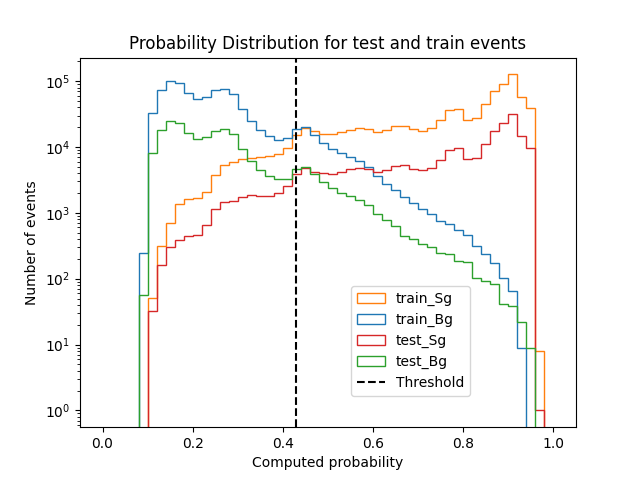

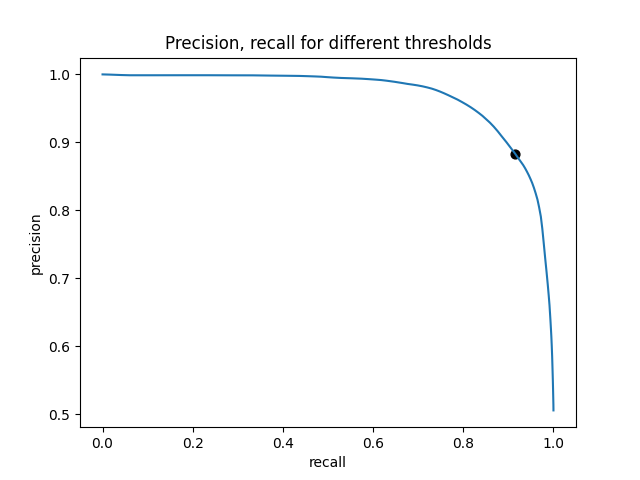

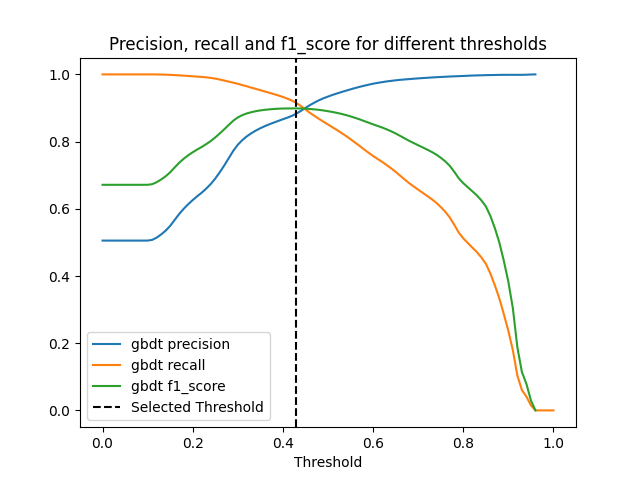

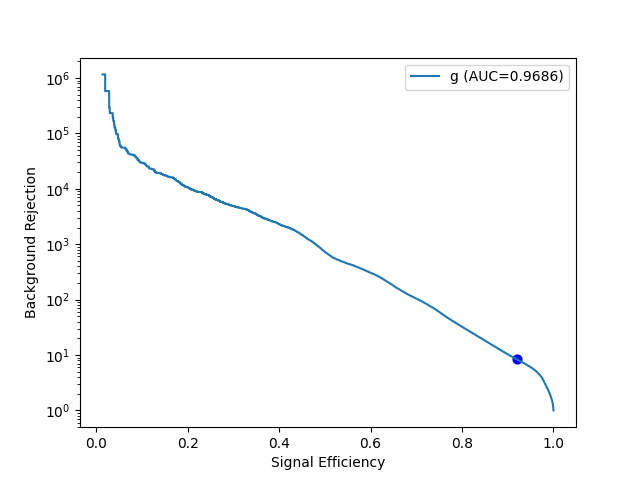

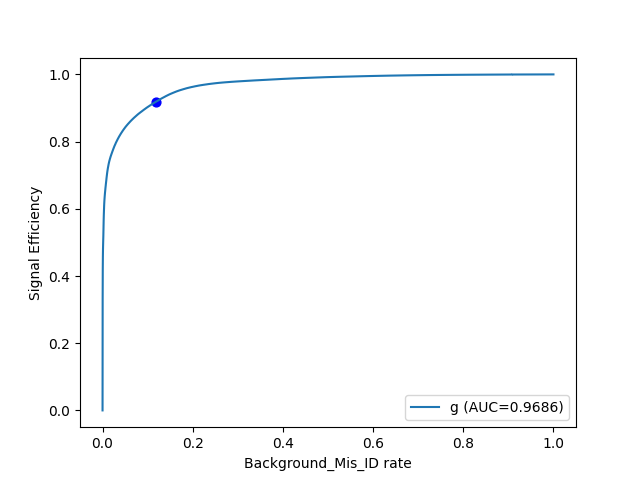

In [15]:
# Using only FiTQun variables for training and testing the model, without applying preselection

bdt_fq_prob, bdt_fq_cut = Classification_model.run_output('/home/surajrai1900/outputs/gbdt/emu_fq/', grid_search=False)

## There are some peaks in background at 0.2, 0.4 which represent sudden increase in particle count at these probabilities, and drops at around 0.8 in signal representing decrease in particle count. Try and understand them using probabilities 2d hists

(<Figure size 2000x1000 with 4 Axes>,
 array([<AxesSubplot: title={'center': 'Signal'}, xlabel='reco_electron_towall', ylabel='bdt_fq_prob'>,
        <AxesSubplot: title={'center': 'Background'}, xlabel='reco_electron_towall', ylabel='bdt_fq_prob'>],
       dtype=object))

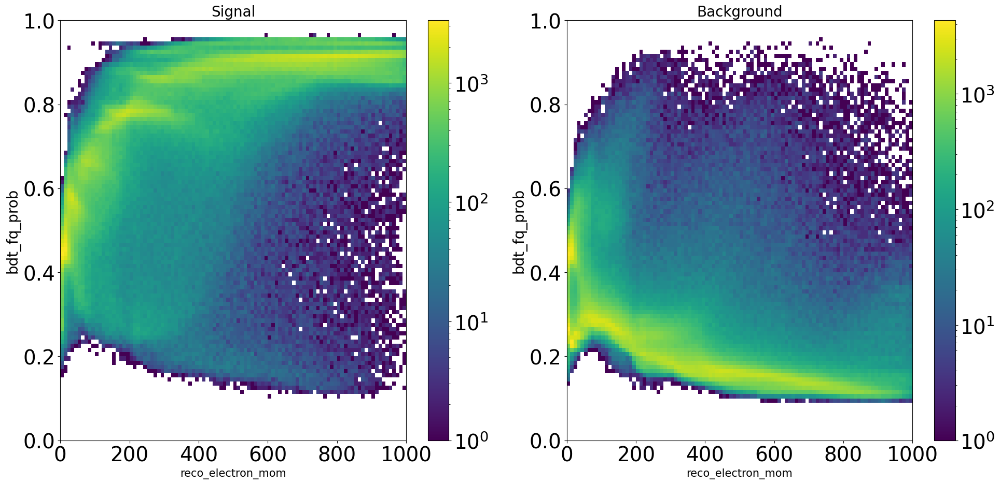

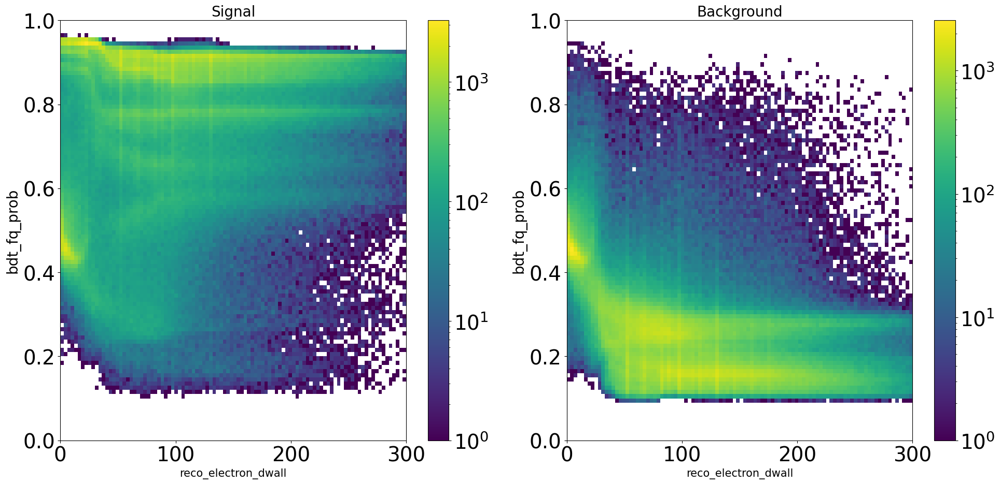

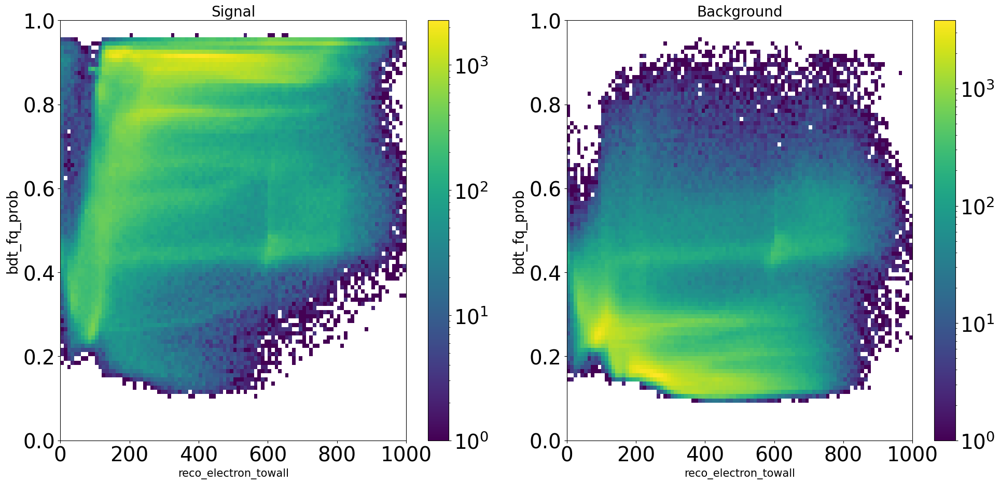

In [16]:
df['bdt_fq_prob'] = bdt_fq_prob
plot.sg_bg_hist2d(df, 'reco_electron_mom', 'bdt_fq_prob', [0, 1000], [0, 1], 100, 100, logbin_y=False, true_sig=True)
plot.sg_bg_hist2d(df, 'reco_electron_dwall', 'bdt_fq_prob', [0, 300], [0, 1], 100, 100, logbin_y=False, true_sig=True)
plot.sg_bg_hist2d(df, 'reco_electron_towall', 'bdt_fq_prob', [0, 1000], [0, 1], 100, 100, logbin_y=False, true_sig=True)

## For Background, particle count should decrease with increasing signal probability, but this is broken at around 0.2 and 0.4

## Around 0.2: There is significantly higher background count for lower towall around 0.2. Also there is slight overlap around 0.2 for low momentum and low towall causing the  slightly higher probability

## Around 0.4: There are greater counts for background at 0.4 for low dwall and low momentum, also since there is significant overlap between signal and background the probability is high for background

## Around 0.8: The signal particle count decreases for all variables

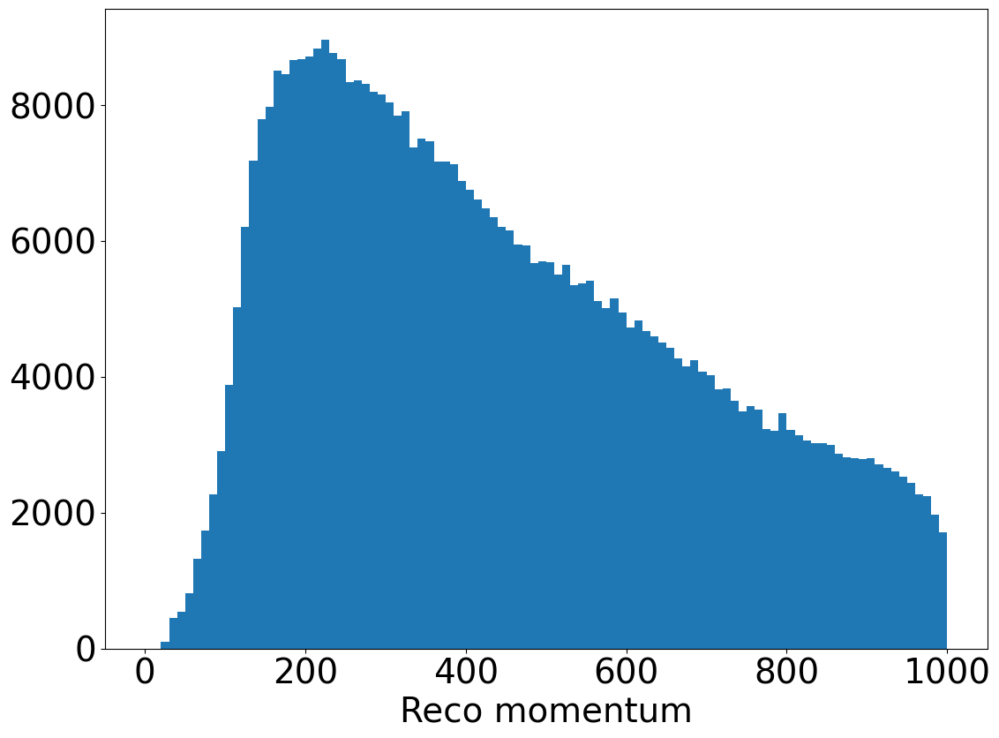

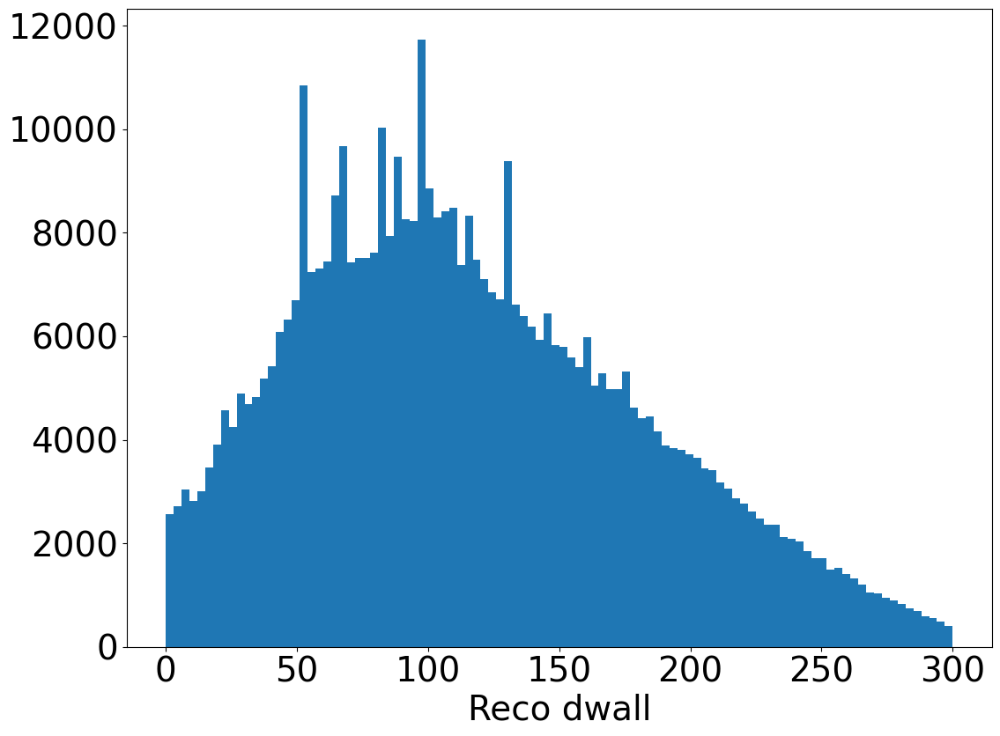

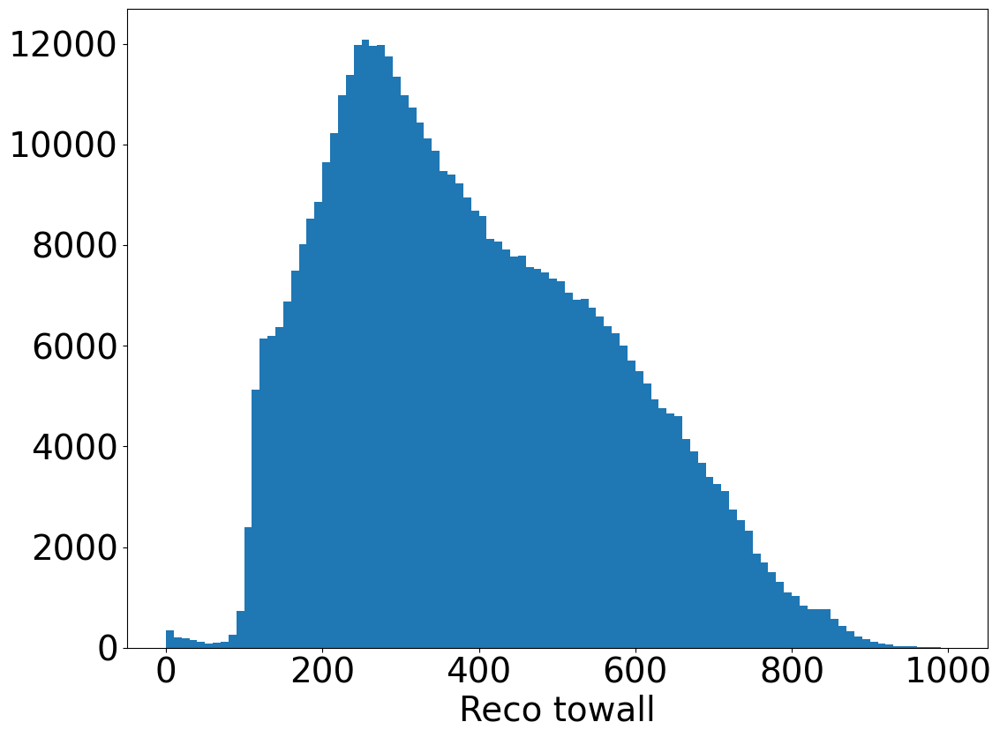

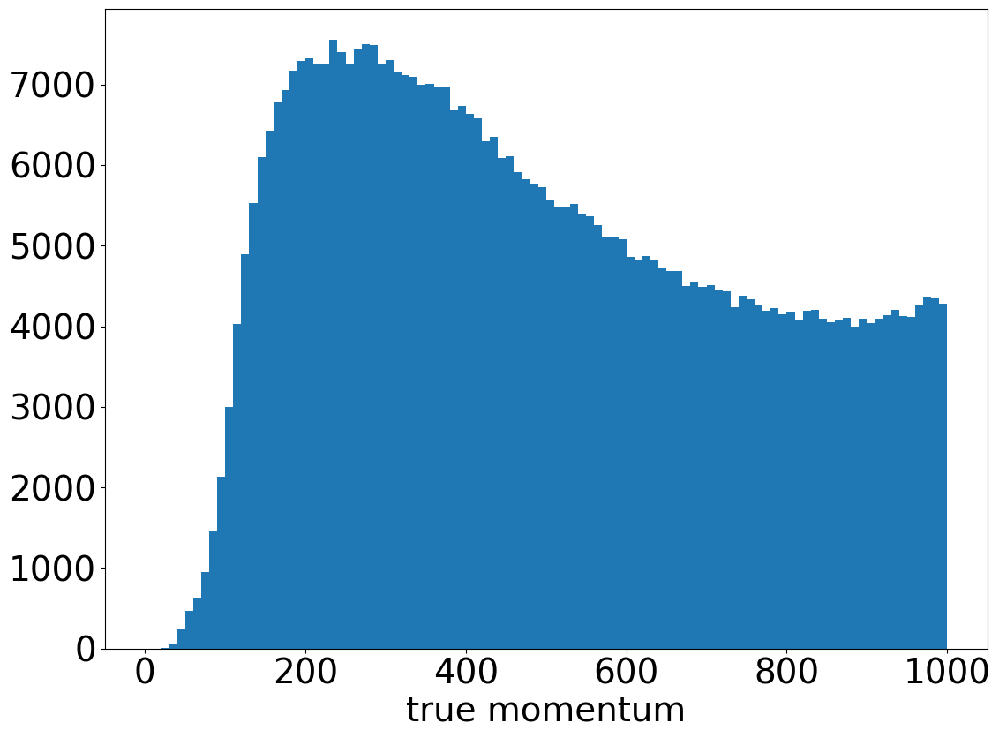

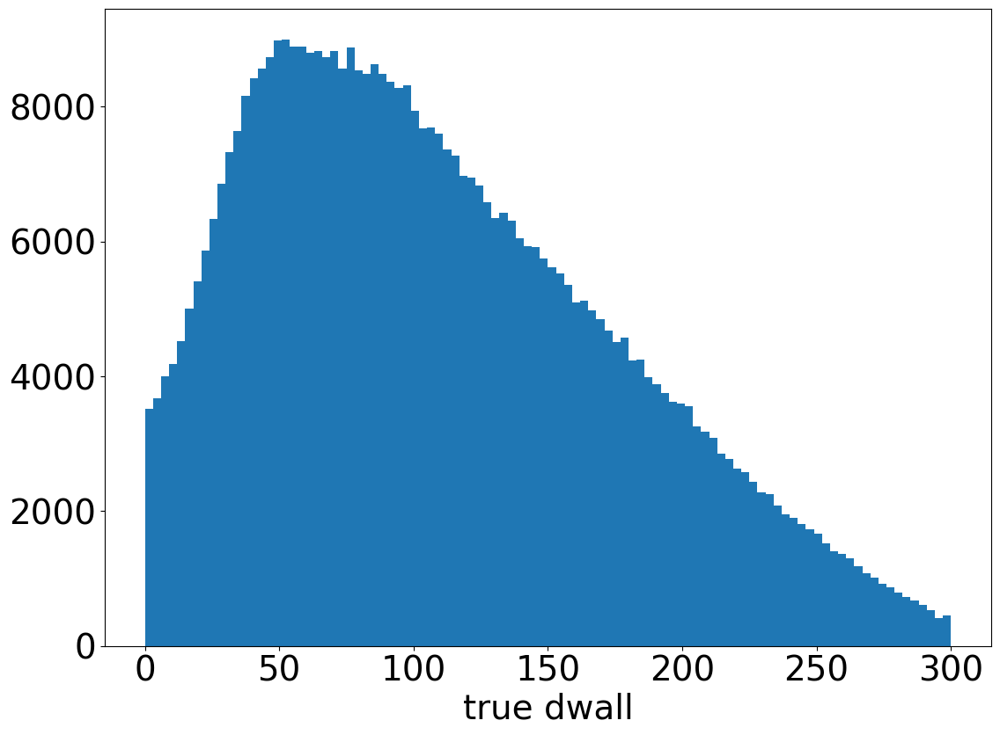

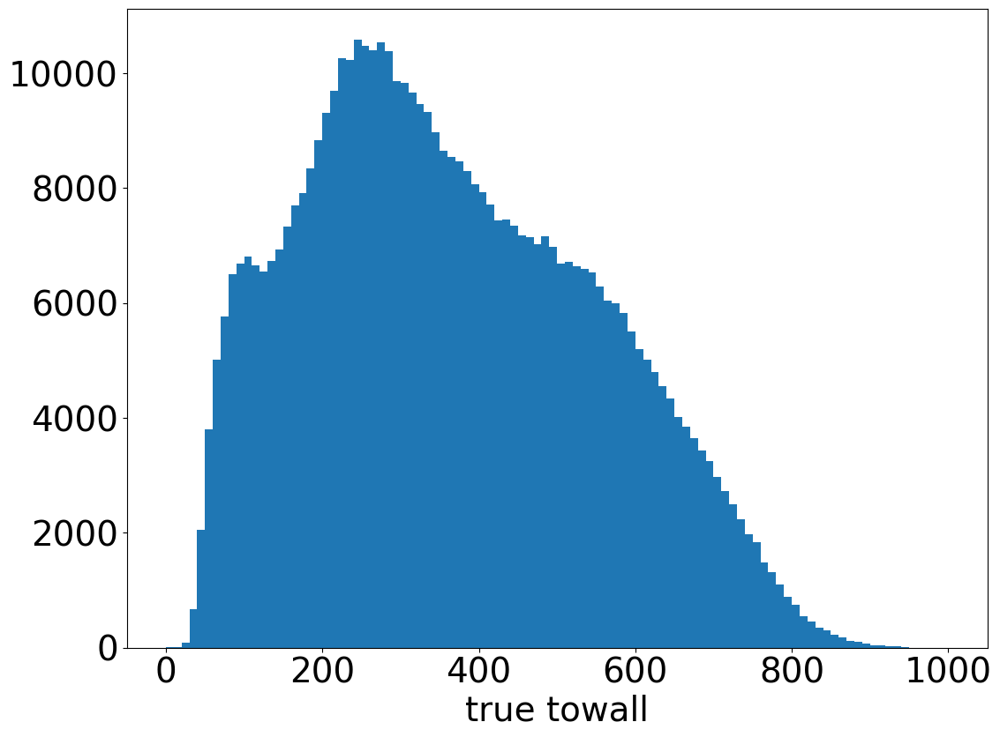

In [17]:
df_spec = df[((df['bdt_fq_prob'] < 0.9) & (df['bdt_fq_prob'] > 0.7) & (df['h5_labels'] ==1 ))]
plt.hist(df_spec['reco_electron_mom'], bins=100, range=(0, 1000))
plt.xlabel('Reco momentum')
plt.show()
plt.hist(df_spec['reco_electron_dwall'], bins=100, range=(0, 300))
plt.xlabel('Reco dwall')
plt.show()
plt.hist(df_spec['reco_electron_towall'], bins=100, range=(0, 1000))
plt.xlabel('Reco towall')
plt.show()
plt.hist(df_spec['h5_momentum'], bins=100, range=(0, 1000))
plt.xlabel('true momentum')
plt.show()
plt.hist(df_spec['h5_dwall'], bins=100, range=(0, 300))
plt.xlabel('true dwall')
plt.show()
plt.hist(df_spec['h5_towall'], bins=100, range=(0, 1000))
plt.xlabel('true towall')
plt.show()

(<Figure size 2000x1000 with 4 Axes>,
 array([<AxesSubplot: title={'center': 'Signal'}, xlabel='h5_towall', ylabel='bdt_fq_prob'>,
        <AxesSubplot: title={'center': 'Background'}, xlabel='h5_towall', ylabel='bdt_fq_prob'>],
       dtype=object))

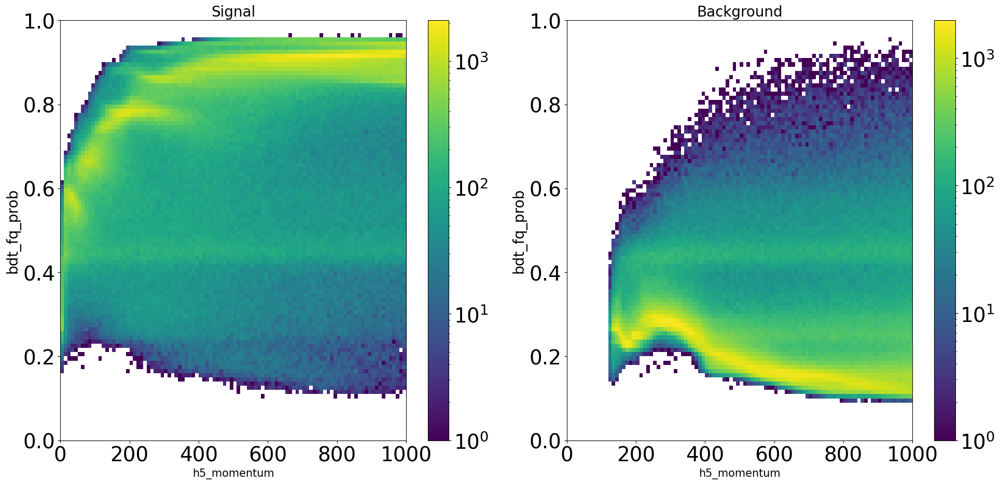

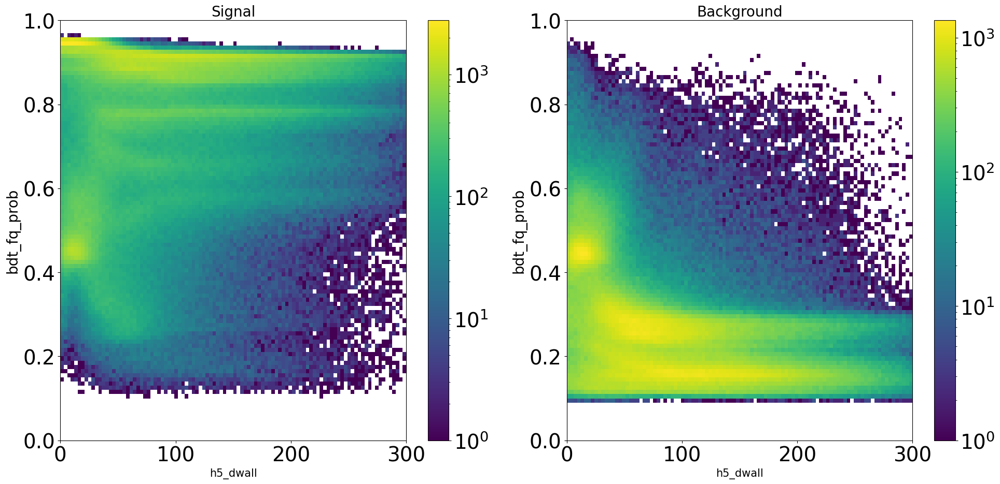

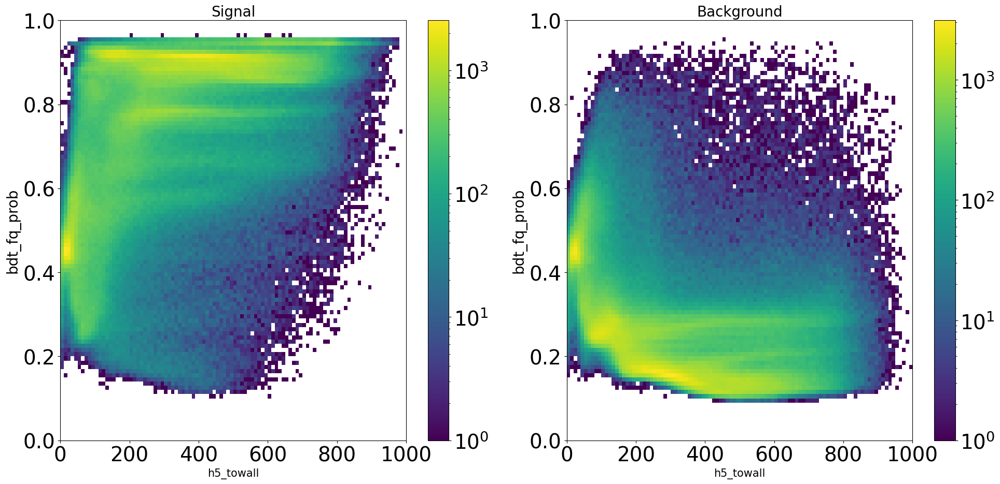

In [18]:
plot.sg_bg_hist2d(df, 'h5_momentum', 'bdt_fq_prob', [0, 1000], [0, 1], 100, 100, logbin_y=False, true_sig=True)
plot.sg_bg_hist2d(df, 'h5_dwall', 'bdt_fq_prob', [0, 300], [0, 1], 100, 100, logbin_y=False, true_sig=True)
plot.sg_bg_hist2d(df, 'h5_towall', 'bdt_fq_prob', [0, 1000], [0, 1], 100, 100, logbin_y=False, true_sig=True)

train features: ['e_likelihood', 'mu_likelihood', 'reco_electron_mom', 'reco_electron_towall', 'reco_electron_dwall', 'true_sig']
train labels: [1, 2]
grid search: False
model name: gbdt
Scoring: f1
Save path: /home/surajrai1900/outputs/gbdt/emu_pre_fq/
The hyperparameters are: n_estimators = 300, max_depth = 13, learning rate = 0.01
Using gbdt model
The train accuracy is:0.9673788598943488
The train f1 score is: 0.9672310062731575


The test accuracy is:0.9648645490201807
The test f1 score is: 0.9646576519985454
The best threshold is : 0.4


e_likelihood : 0.33881808975826305
mu_likelihood : 0.5252374032638862
reco_electron_mom : 0.06569290379987361
reco_electron_towall : 0.0543722415443621
reco_electron_dwall : 0.015879361633614784


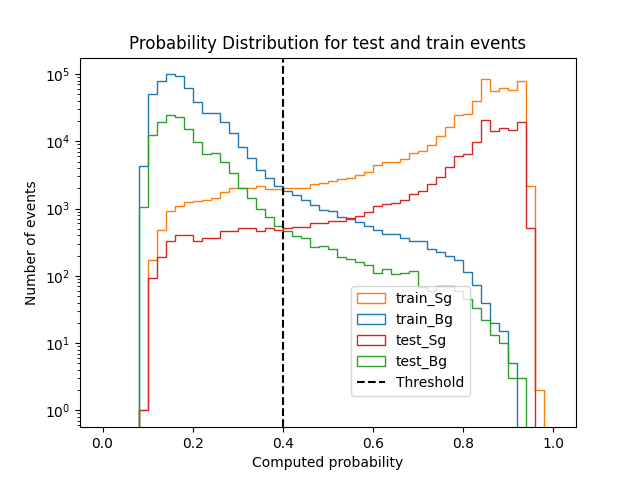

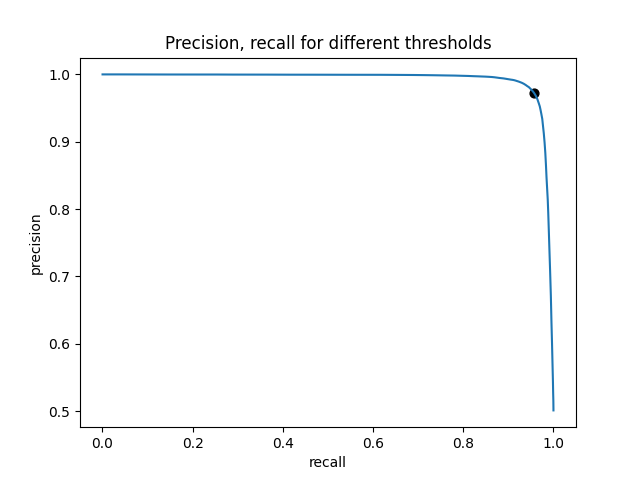

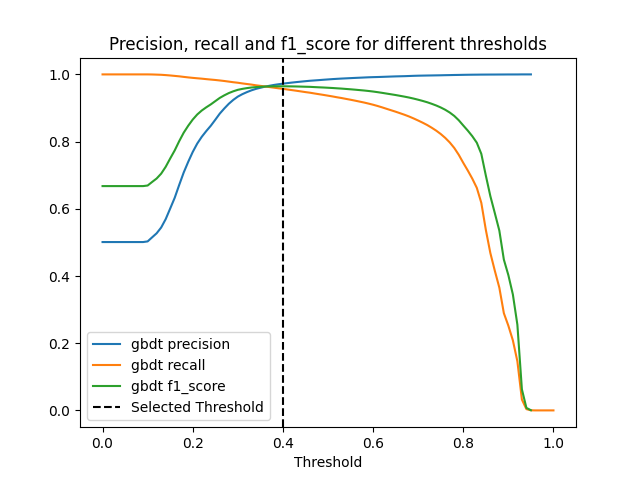

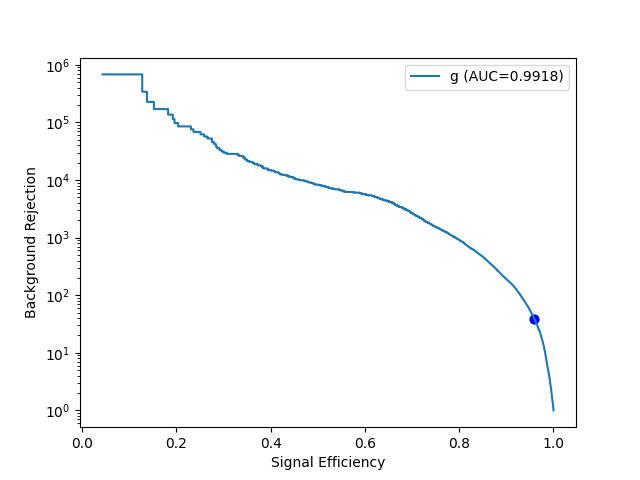

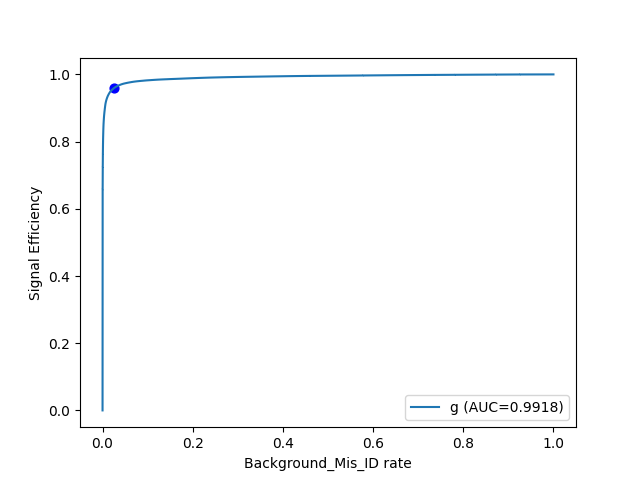

In [19]:
# Using only FiTQun variables for training and testing the model, with applying preselection

bdt_fq_prob_base, bdt_fq_cut_base = Classification_model.run_output('/home/surajrai1900/outputs/gbdt/emu_pre_fq/', grid_search=False)

## We can see after applying the reco preselection, where  all low regions of reco variables were removed the variations vanish

(<Figure size 2000x1000 with 4 Axes>,
 array([<AxesSubplot: title={'center': 'Signal'}, xlabel='reco_electron_towall', ylabel='bdt_fq_prob_base'>,
        <AxesSubplot: title={'center': 'Background'}, xlabel='reco_electron_towall', ylabel='bdt_fq_prob_base'>],
       dtype=object))

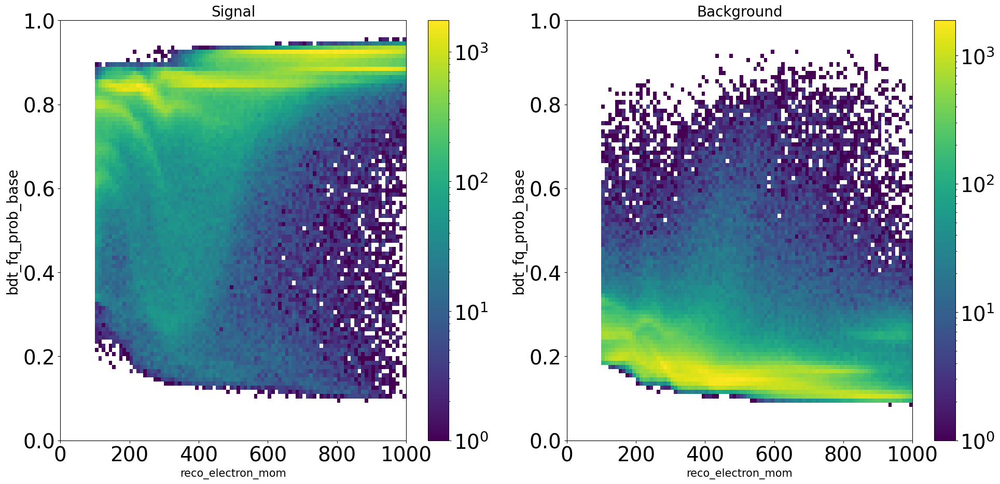

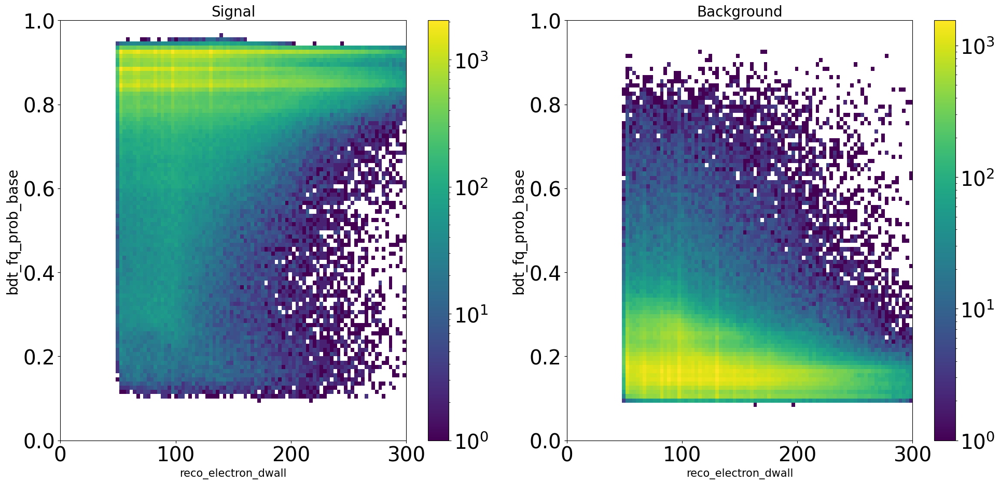

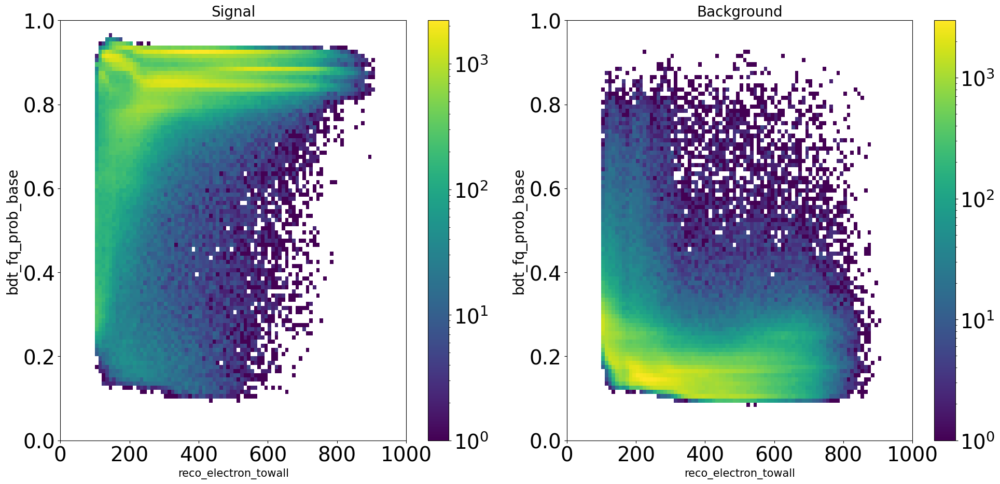

In [20]:
df_base['bdt_fq_prob_base'] = bdt_fq_prob_base
plot.sg_bg_hist2d(df_base, 'reco_electron_mom', 'bdt_fq_prob_base', [0, 1000], [0, 1], 100, 100, logbin_y=False, true_sig=True)
plot.sg_bg_hist2d(df_base, 'reco_electron_dwall', 'bdt_fq_prob_base', [0, 300], [0, 1], 100, 100, logbin_y=False, true_sig=True)
plot.sg_bg_hist2d(df_base, 'reco_electron_towall', 'bdt_fq_prob_base', [0, 1000], [0, 1], 100, 100, logbin_y=False, true_sig=True)

13:4: not a valid test operator: 530.30.02
train features: ['e_likelihood', 'mu_likelihood', 'reco_electron_mom', 'reco_electron_towall', 'reco_electron_dwall', 'true_sig']
train labels: [1, 2]
grid search: False
model name: gbdt
Scoring: f1
Save path: /home/surajrai1900/outputs/gbdt/emu_nick_fq/
The hyperparameters are: n_estimators = 300, max_depth = 13, learning rate = 0.01
Using gbdt model
The train accuracy is:0.982194844362095
The train f1 score is: 0.983524922314


The test accuracy is:0.9795239352296895
The test f1 score is: 0.9810442055949795
The best threshold is : 0.46


e_likelihood : 0.3475438468219632
mu_likelihood : 0.5489052969508555
reco_electron_mom : 0.025968954223216892
reco_electron_towall : 0.03340625120779016
reco_electron_dwall : 0.04417565079617432


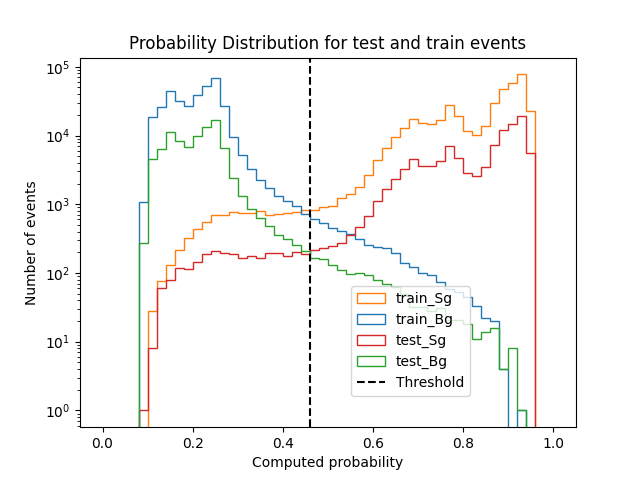

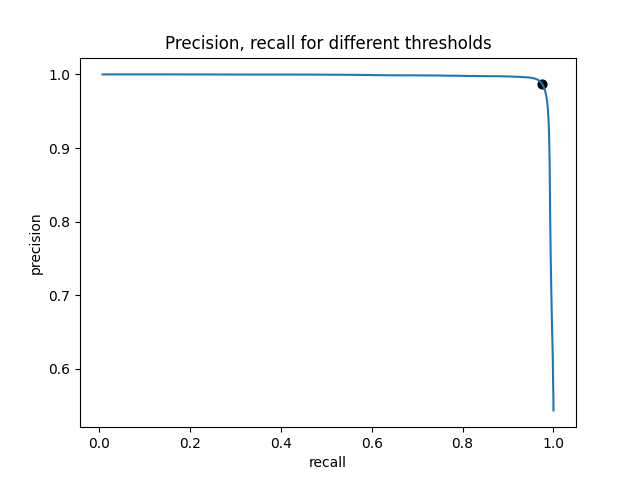

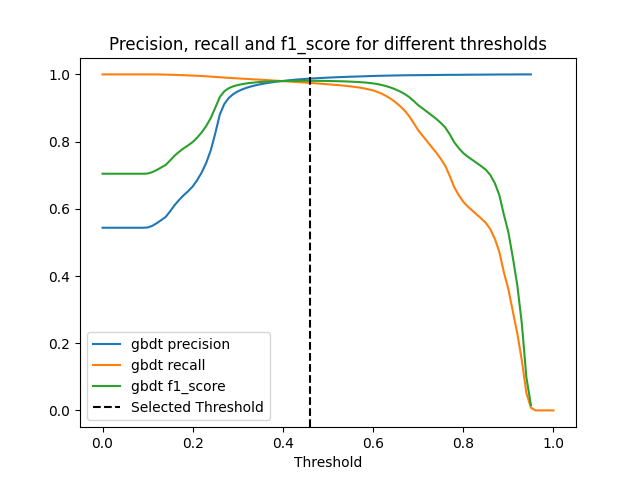

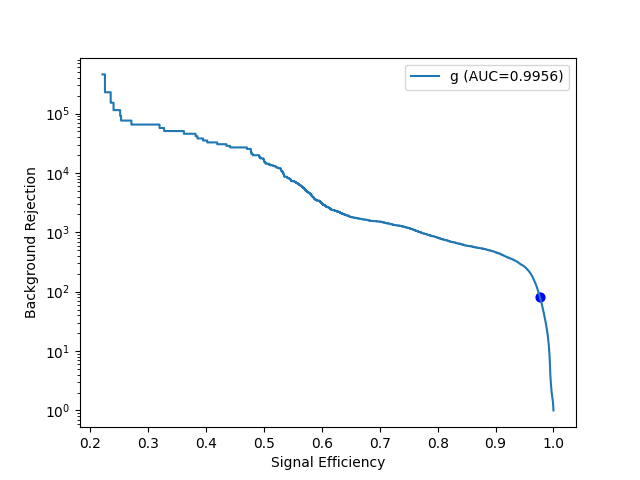

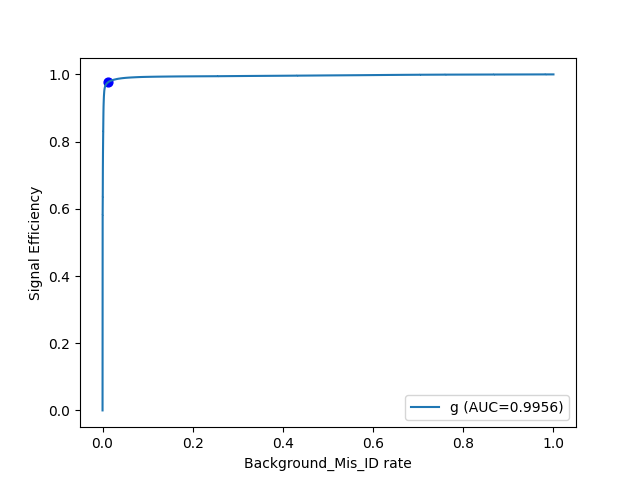

In [21]:
# Using only FiTQun variables for training and testing the model, with applying preselection

bdt_fq_prob_nick, bdt_fq_cut_nick = Classification_model.run_output('/home/surajrai1900/outputs/gbdt/emu_nick_fq/', grid_search=False)

## After applying nicks preselection to data, we can still see that there is a peak in background around 0.2 and a drop in signal around 0.8. This is not observed when reco preselection was applied. 

(<Figure size 2000x1000 with 4 Axes>,
 array([<AxesSubplot: title={'center': 'Signal'}, xlabel='reco_electron_towall', ylabel='bdt_fq_prob_nick'>,
        <AxesSubplot: title={'center': 'Background'}, xlabel='reco_electron_towall', ylabel='bdt_fq_prob_nick'>],
       dtype=object))

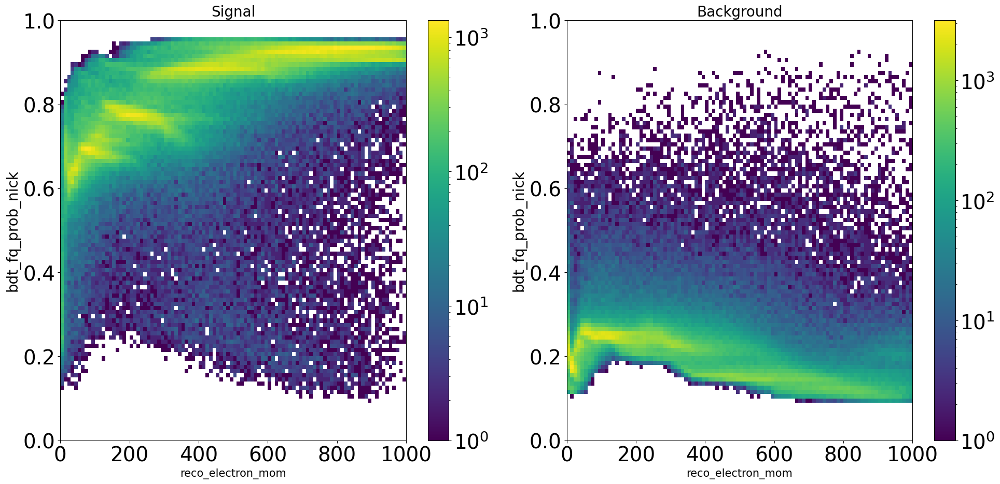

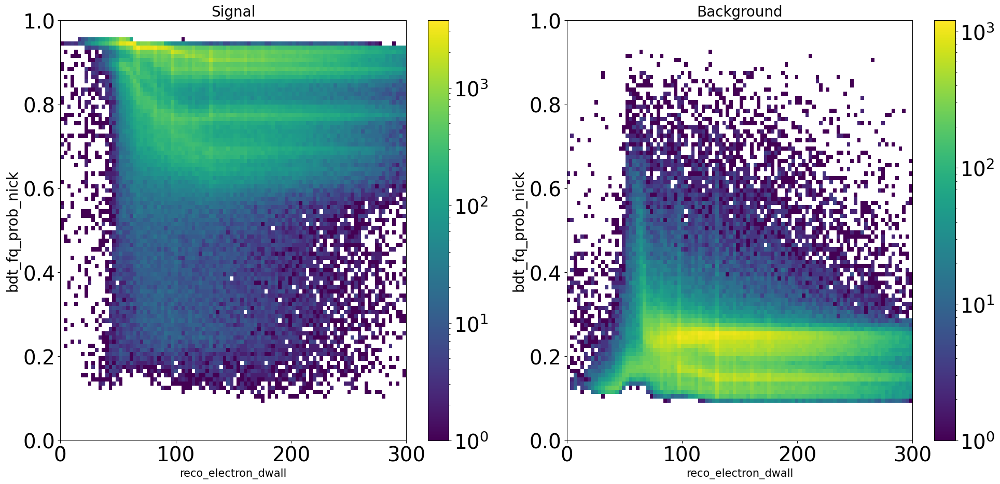

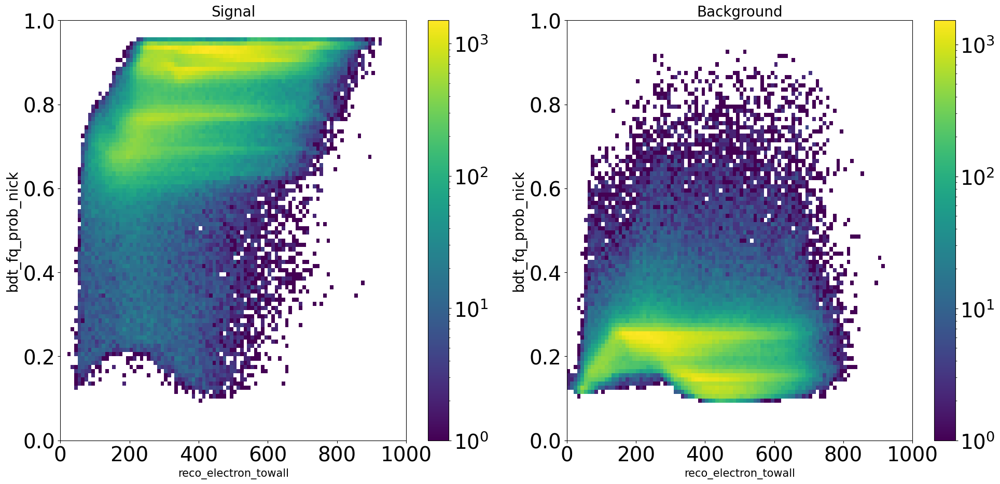

In [22]:
df_nick['bdt_fq_prob_nick'] = bdt_fq_prob_nick
plot.sg_bg_hist2d(df_nick, 'reco_electron_mom', 'bdt_fq_prob_nick', [0, 1000], [0, 1], 100, 100, logbin_y=False, true_sig=True)
plot.sg_bg_hist2d(df_nick, 'reco_electron_dwall', 'bdt_fq_prob_nick', [0, 300], [0, 1], 100, 100, logbin_y=False, true_sig=True)
plot.sg_bg_hist2d(df_nick, 'reco_electron_towall', 'bdt_fq_prob_nick', [0, 1000], [0, 1], 100, 100, logbin_y=False, true_sig=True)

(<Figure size 2000x1000 with 4 Axes>,
 array([<AxesSubplot: title={'center': 'Signal'}, xlabel='h5_towall', ylabel='bdt_fq_prob_nick'>,
        <AxesSubplot: title={'center': 'Background'}, xlabel='h5_towall', ylabel='bdt_fq_prob_nick'>],
       dtype=object))

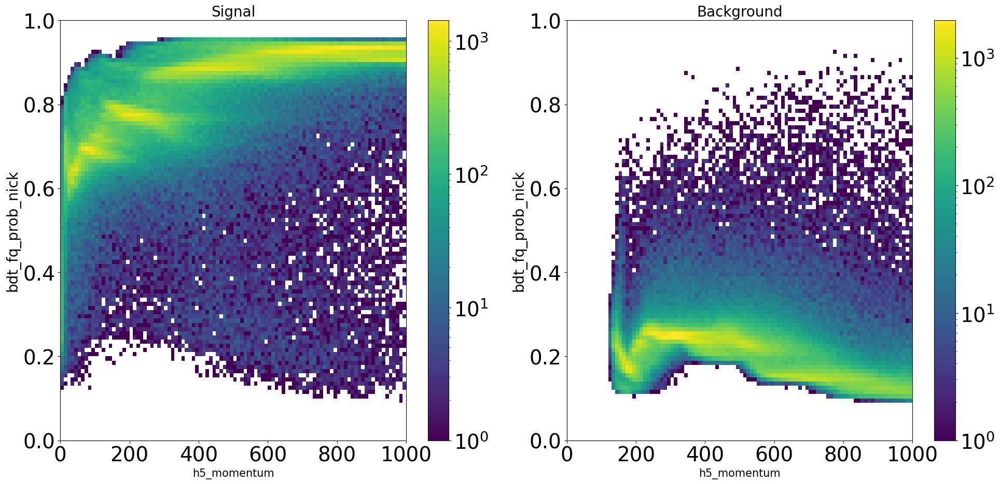

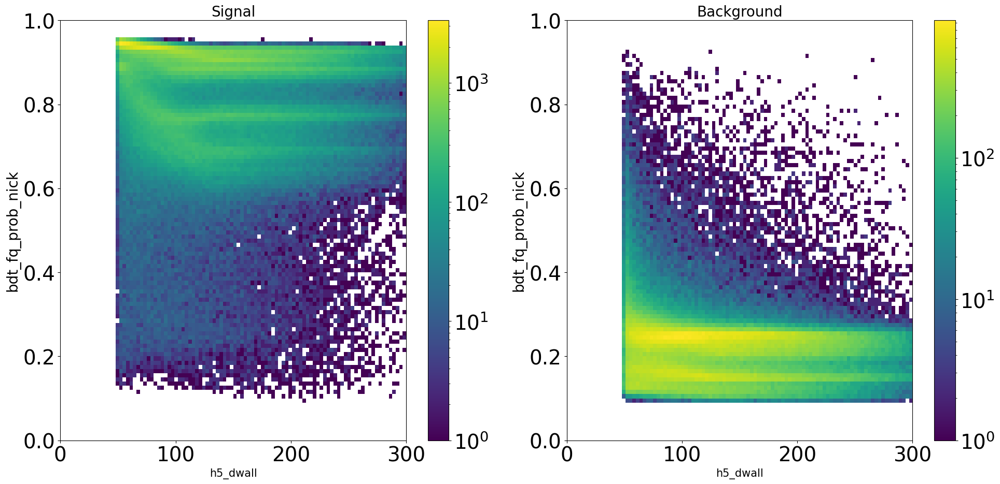

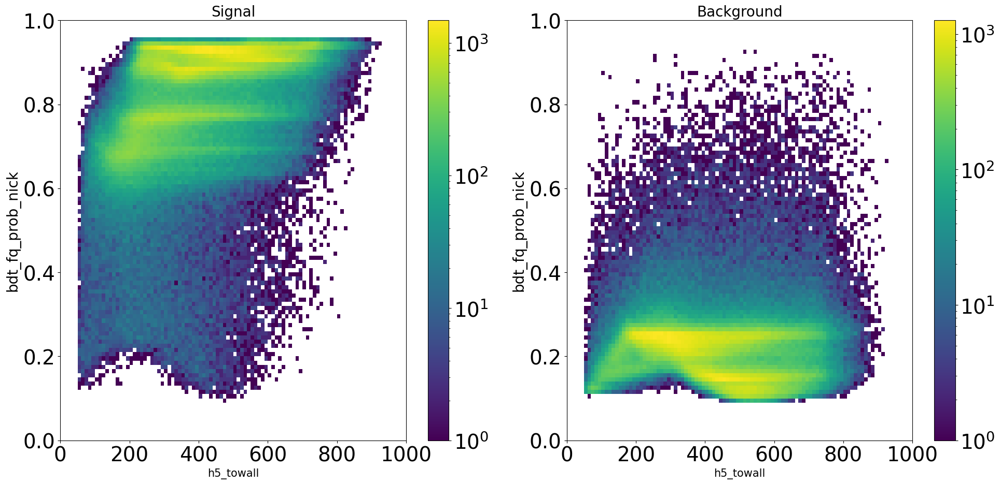

In [23]:
df_nick['bdt_fq_prob_nick'] = bdt_fq_prob_nick
plot.sg_bg_hist2d(df_nick, 'h5_momentum', 'bdt_fq_prob_nick', [0, 1000], [0, 1], 100, 100, logbin_y=False, true_sig=True)
plot.sg_bg_hist2d(df_nick, 'h5_dwall', 'bdt_fq_prob_nick', [0, 300], [0, 1], 100, 100, logbin_y=False, true_sig=True)
plot.sg_bg_hist2d(df_nick, 'h5_towall', 'bdt_fq_prob_nick', [0, 1000], [0, 1], 100, 100, logbin_y=False, true_sig=True)

In [24]:
# Looking at statistics of the bdt  before and after preselection

print('Signal and background statistics before applying preselection for bdt')
sig_eff_emu = classification_metrics.sg_eff(df['true_sig'], bdt_fq_cut)
bg_rej_emu = classification_metrics.bg_rej(df['true_sig'], bdt_fq_cut)
print(f"The signal event count after applying cuts is : {np.sum(df[bdt_fq_cut]['h5_labels'] == 1)}")
print(f"The background event count after applying cuts is : {np.sum(df[bdt_fq_cut]['h5_labels'] == 2)}")
print(f"The signal efficiency is: {sig_eff_emu}")
print(f"The background rejection is: {bg_rej_emu}")

print('\n')

print('Signal and background statistics after applying preselection for bdt')
sig_eff_emu_base = classification_metrics.sg_eff(df_base['true_sig'], bdt_fq_cut_base)
bg_rej_emu_base = classification_metrics.bg_rej(df_base['true_sig'], bdt_fq_cut_base)
print(f"The signal event count after applying cuts is : {np.sum(df_base[bdt_fq_cut_base]['h5_labels'] == 1)}")
print(f"The background event count after applying cuts is : {np.sum(df_base[bdt_fq_cut_base]['h5_labels'] == 2)}")
print(f"The signal efficiency is: {sig_eff_emu_base}")
print(f"The background rejection is: {bg_rej_emu_base}")

print('\n')

print('Signal and background statistics after applying nicks preselection for bdt')
sig_eff_emu_nick = classification_metrics.sg_eff(df_nick['true_sig'], bdt_fq_cut_nick)
bg_rej_emu_nick = classification_metrics.bg_rej(df_nick['true_sig'], bdt_fq_cut_nick)
print(f"The signal event count after applying cuts is : {np.sum(df_nick[bdt_fq_cut_nick]['h5_labels'] == 1)}")
print(f"The background event count after applying cuts is : {np.sum(df_nick[bdt_fq_cut_nick]['h5_labels'] == 2)}")
print(f"The signal efficiency is: {sig_eff_emu_nick}")
print(f"The background rejection is: {bg_rej_emu_nick}")

Signal and background statistics before applying preselection for bdt
The signal event count after applying cuts is : 1080313
The background event count after applying cuts is : 138103
The signal efficiency is: 0.9192080084066147
The background rejection is: 0.8809159186348311


Signal and background statistics after applying preselection for bdt
The signal event count after applying cuts is : 658616
The background event count after applying cuts is : 17583
The signal efficiency is: 0.9595445115270752
The background rejection is: 0.9742465697245234


Signal and background statistics after applying nicks preselection for bdt
The signal event count after applying cuts is : 533190
The background event count after applying cuts is : 5720
The signal efficiency is: 0.9767531325566059
The background rejection is: 0.9875101807311785


In [25]:
# Defining array of cuts, algorithms and probabilities for comparison between fitqun, softmax, and bdt cuts

cuts = [ml_emu, bdt_fq_cut, fq_emu]
probs = [df['softmax_discriminator'], bdt_fq_prob, df['fq_discriminator']]
algorithms = ['Softmax', 'BDT', 'FiTQun']

cuts_base = [ml_emu_base, bdt_fq_cut_base, fq_emu_base]
probs_base = [df_base['softmax_discriminator'], bdt_fq_prob_base, df_base['fq_discriminator']]
algorithms_base = ['Softmax_base', 'BDT_base', 'FiTQun_base']

cuts_nick = [ml_emu_nick, bdt_fq_cut_nick, fq_emu_nick]
probs_nick = [df_nick['softmax_discriminator'], bdt_fq_prob_nick, df_nick['fq_discriminator']]
algorithms_nick = ['Softmax_nick', 'BDT_nick', 'FiTQun_nick']

In [26]:
# Getting the signal efficiency and background rejection for all different cuts before and after applying preselection

sig_eff = classification_metrics.sg_eff(df['true_sig'], cuts)
bg_rej = classification_metrics.bg_rej(df['true_sig'], cuts)

for i in range(len(sig_eff)):
    print(f'The signal efficiency  and background rejection for {algorithms[i]} cuts is : {round(sig_eff[i], 3)}, {round(bg_rej[i], 3)}')
    
print('\n')

sig_eff_base = classification_metrics.sg_eff(df_base['true_sig'], cuts_base)
bg_rej_base = classification_metrics.bg_rej(df_base['true_sig'], cuts_base)

for i in range(len(sig_eff_base)):
    print(f'The signal efficiency  and background rejection for {algorithms_base[i]} cuts is : {round(sig_eff_base[i], 3)}, {round(bg_rej_base[i], 3)}')
    
print('\n')

sig_eff_nick = classification_metrics.sg_eff(df_nick['true_sig'], cuts_nick)
bg_rej_nick = classification_metrics.bg_rej(df_nick['true_sig'], cuts_nick)

for i in range(len(sig_eff_nick)):
    print(f'The signal efficiency  and background rejection for {algorithms_nick[i]} cuts is : {round(sig_eff_nick[i], 3)}, {round(bg_rej_nick[i], 3)}')

The signal efficiency  and background rejection for Softmax cuts is : 0.949, 0.972
The signal efficiency  and background rejection for BDT cuts is : 0.919, 0.881
The signal efficiency  and background rejection for FiTQun cuts is : 0.91, 0.833


The signal efficiency  and background rejection for Softmax_base cuts is : 0.998, 0.999
The signal efficiency  and background rejection for BDT_base cuts is : 0.96, 0.974
The signal efficiency  and background rejection for FiTQun_base cuts is : 0.943, 0.943


The signal efficiency  and background rejection for Softmax_nick cuts is : 0.996, 0.994
The signal efficiency  and background rejection for BDT_nick cuts is : 0.977, 0.988
The signal efficiency  and background rejection for FiTQun_nick cuts is : 0.954, 0.992


In [27]:
# Getting f1, precision and recall score for all different cuts before and after applying preselection

prec, rec, f1 = classification_metrics.f1(df['true_sig'], cuts)

for i in range(len(prec)):
    print(f'The precision, recall and f1 score for  {algorithms[i]} cuts is : {round(prec[i], 3)}, {round(rec[i], 3)}, {round(f1[i], 3)}')
    
print('\n')

prec_base, rec_base, f1_base = classification_metrics.f1(df_base['true_sig'], cuts_base)

for i in range(len(prec_base)):
    print(f'The precision, recall and f1 score for  {algorithms_base[i]} cuts is : {round(prec_base[i], 3)}, {round(rec_base[i], 3)}, {round(f1_base[i], 3)}')
    
print('\n')

prec_nick, rec_nick, f1_nick = classification_metrics.f1(df_nick['true_sig'], cuts_nick)

for i in range(len(prec_nick)):
    print(f'The precision, recall and f1 score for  {algorithms_nick[i]} cuts is : {round(prec_nick[i], 3)}, {round(rec_nick[i], 3)}, {round(f1_nick[i], 3)}')

The precision, recall and f1 score for  Softmax cuts is : 0.972, 0.949, 0.96
The precision, recall and f1 score for  BDT cuts is : 0.887, 0.919, 0.903
The precision, recall and f1 score for  FiTQun cuts is : 0.846, 0.91, 0.877


The precision, recall and f1 score for  Softmax_base cuts is : 0.999, 0.998, 0.998
The precision, recall and f1 score for  BDT_base cuts is : 0.974, 0.96, 0.967
The precision, recall and f1 score for  FiTQun_base cuts is : 0.943, 0.943, 0.943


The precision, recall and f1 score for  Softmax_nick cuts is : 0.995, 0.996, 0.995
The precision, recall and f1 score for  BDT_nick cuts is : 0.989, 0.977, 0.983
The precision, recall and f1 score for  FiTQun_nick cuts is : 0.993, 0.954, 0.973


(<Figure size 1200x900 with 1 Axes>,
 <AxesSubplot: xlabel='Background_Mis_ID rate', ylabel='Signal Efficiency'>)

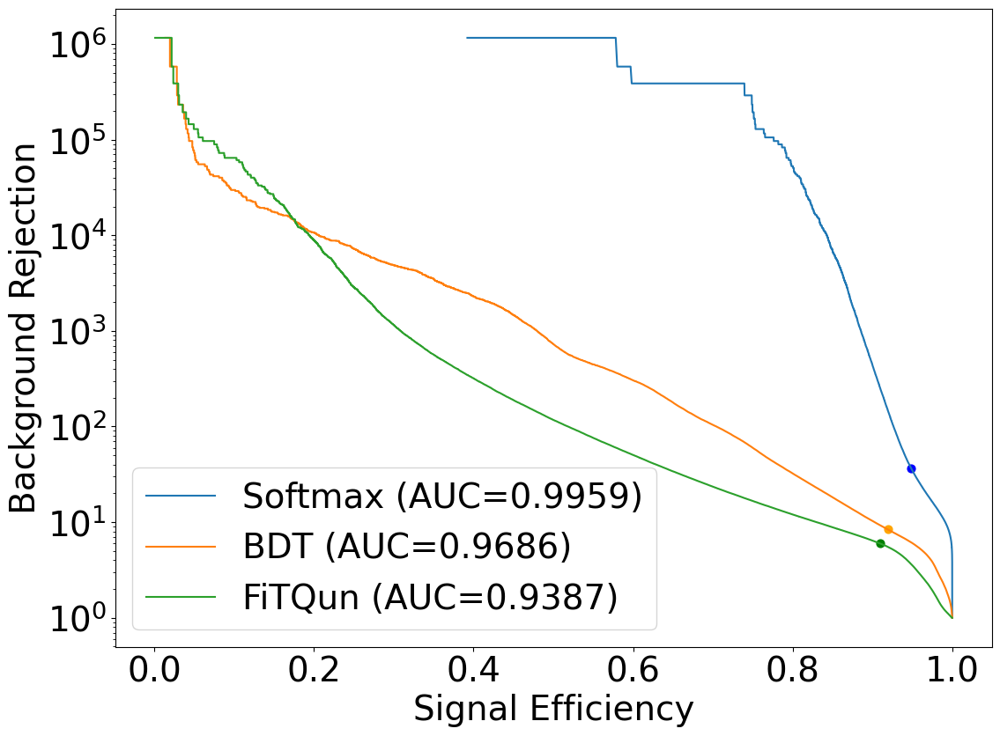

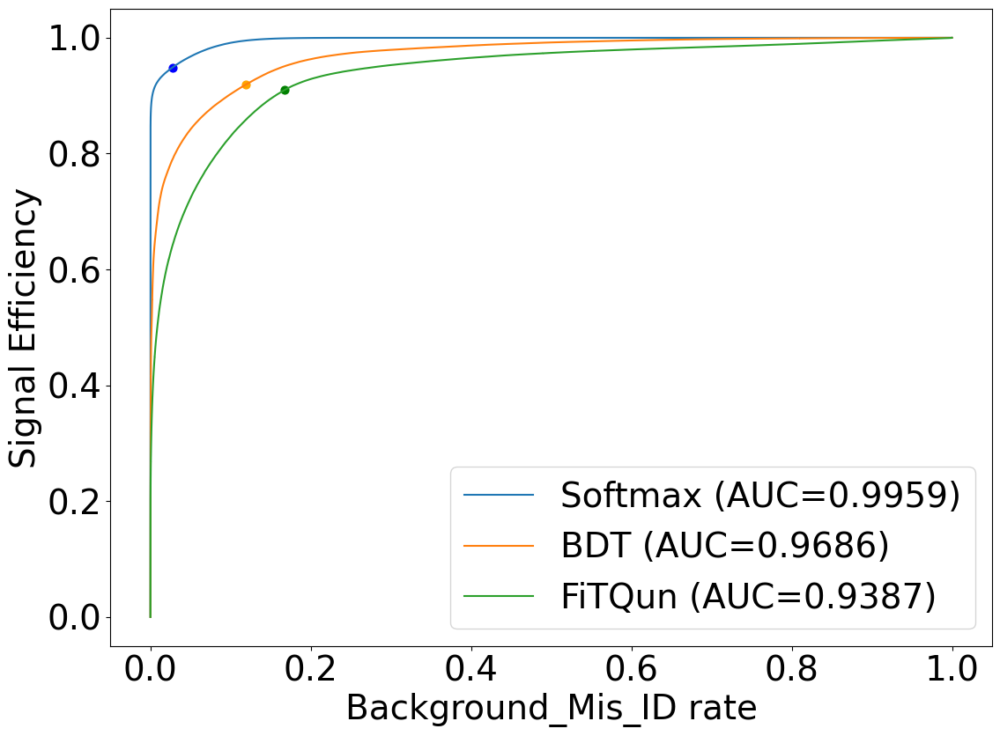

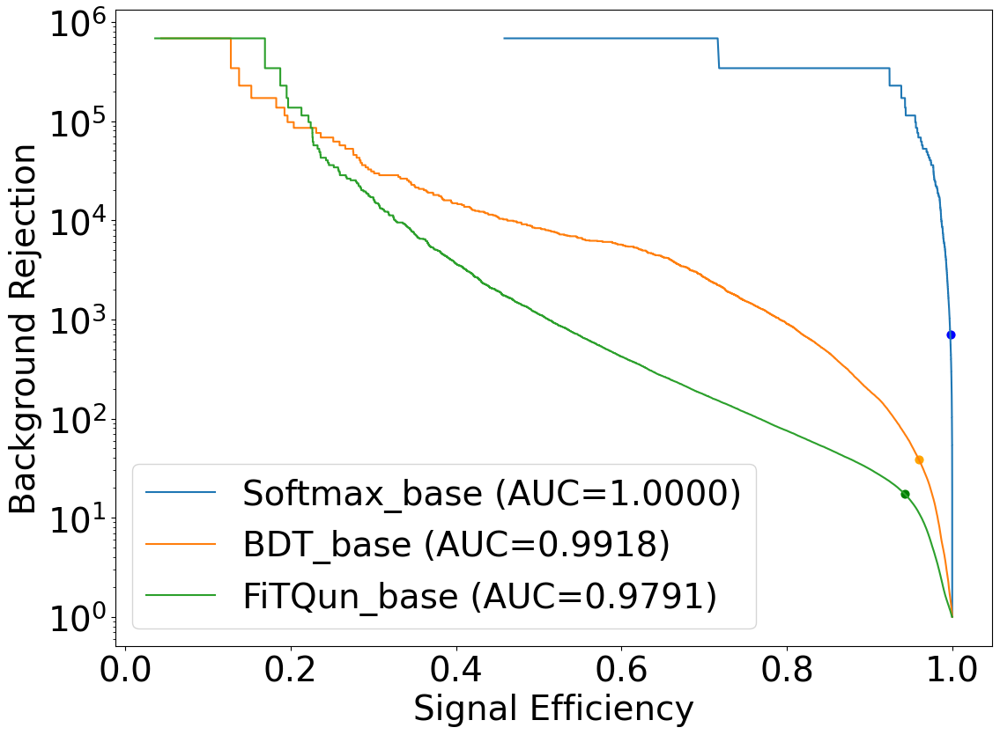

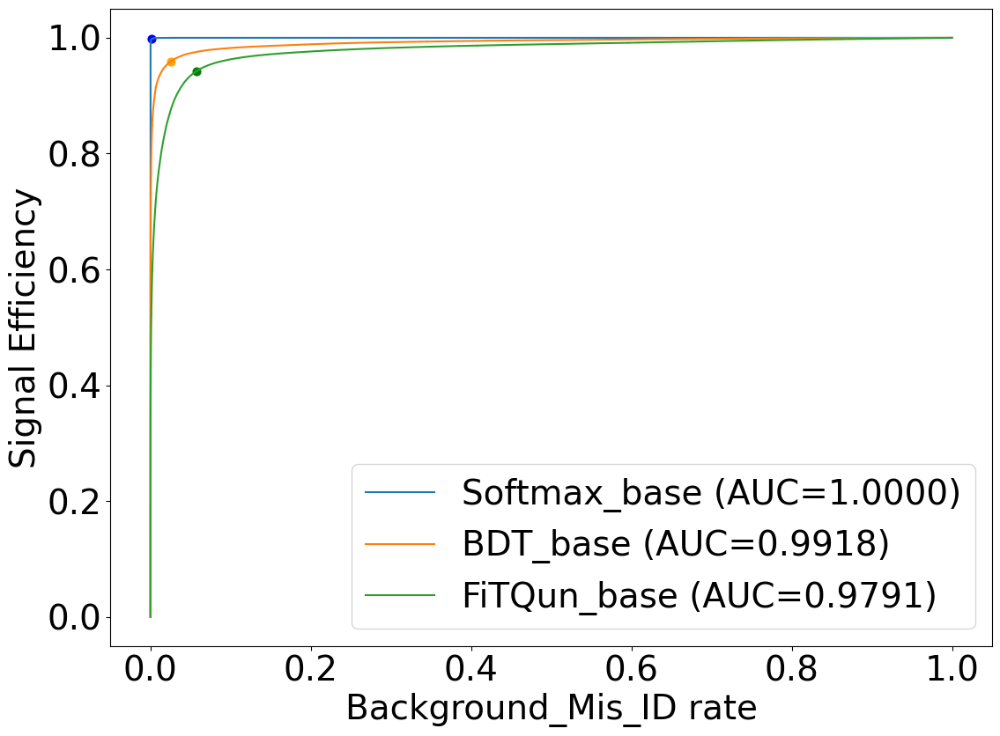

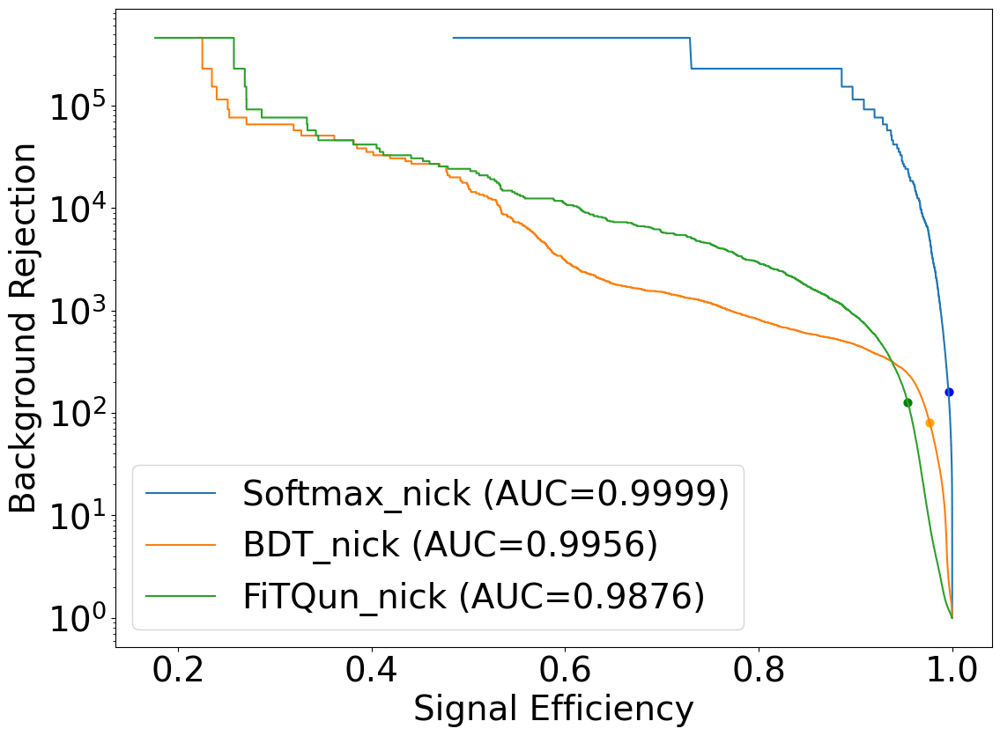

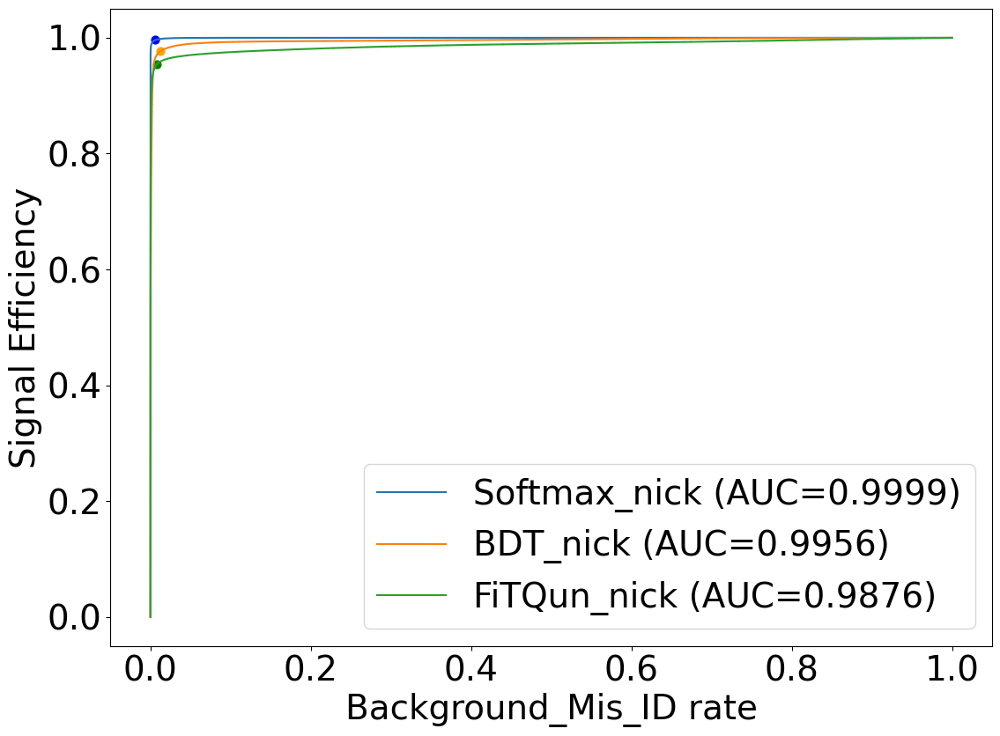

In [28]:
# Plotting roc curves for all the algorithms before and after preselection:

plot.roc(df['true_sig'], probs, algorithms, mode='rejection', cut=cuts)
plot.roc(df['true_sig'], probs, algorithms, mode='efficiency', cut=cuts)

plot.roc(df_base['true_sig'], probs_base, algorithms_base, mode='rejection', cut=cuts_base)
plot.roc(df_base['true_sig'], probs_base, algorithms_base, mode='efficiency', cut=cuts_base)

plot.roc(df_nick['true_sig'], probs_nick, algorithms_nick, mode='rejection', cut=cuts_nick)
plot.roc(df_nick['true_sig'], probs_nick, algorithms_nick, mode='efficiency', cut=cuts_nick)

In [29]:
# Binning some varibales:

mom_binning = bins.get_binning(df['h5_momentum'], 20, 0, 1000)
reco_mom_e_binning = bins.get_binning(df['reco_electron_mom'], 20, 0, 1000)
dwall_binning = bins.get_binning(df['h5_dwall'], 20, 0, 300)
reco_dwall_binning = bins.get_binning(df['reco_electron_dwall'], 20, 0, 300)
towall_binning = bins.get_binning(df['h5_towall'], 20, 0, 800)
reco_towall_binning = bins.get_binning(df['reco_electron_towall'], 20, 0, 800)
cos_zenith_binning = bins.get_binning(df['cos_zenith'], 20, -1, 1)
azimuth_binning = bins.get_binning(df['azimuth'], 20, -180, 180)

mom_binning_base = bins.get_binning(df_base['h5_momentum'], 20, 0, 1000)
reco_mom_e_binning_base = bins.get_binning(df_base['reco_electron_mom'], 20, 100, 1000)
dwall_binning_base = bins.get_binning(df_base['h5_dwall'], 20, 0, 300)
reco_dwall_binning_base = bins.get_binning(df_base['reco_electron_dwall'], 20, 50, 300)
towall_binning_base = bins.get_binning(df_base['h5_towall'], 20, 0, 800)
reco_towall_binning_base = bins.get_binning(df_base['reco_electron_towall'], 20, 100, 800)
cos_zenith_binning_base = bins.get_binning(df_base['cos_zenith'], 20, -1, 1)
azimuth_binning_base = bins.get_binning(df_base['azimuth'], 20, -180, 180)

mom_binning_nick = bins.get_binning(df_nick['h5_momentum'], 20, 0, 1000)
reco_mom_e_binning_nick = bins.get_binning(df_nick['reco_electron_mom'], 20, 100, 1000)
dwall_binning_nick = bins.get_binning(df_nick['h5_dwall'], 20, 0, 300)
reco_dwall_binning_nick = bins.get_binning(df_nick['reco_electron_dwall'], 20, 50, 300)
towall_binning_nick = bins.get_binning(df_nick['h5_towall'], 20, 0, 800)
reco_towall_binning_nick = bins.get_binning(df_nick['reco_electron_towall'], 20, 100, 800)
cos_zenith_binning_nick = bins.get_binning(df_nick['cos_zenith'], 20, -1, 1)
azimuth_binning_nick = bins.get_binning(df_nick['azimuth'], 20, -180, 180)

(<Figure size 1200x900 with 1 Axes>,
 <AxesSubplot: xlabel='azimuth', ylabel='Background Mis_ID'>)

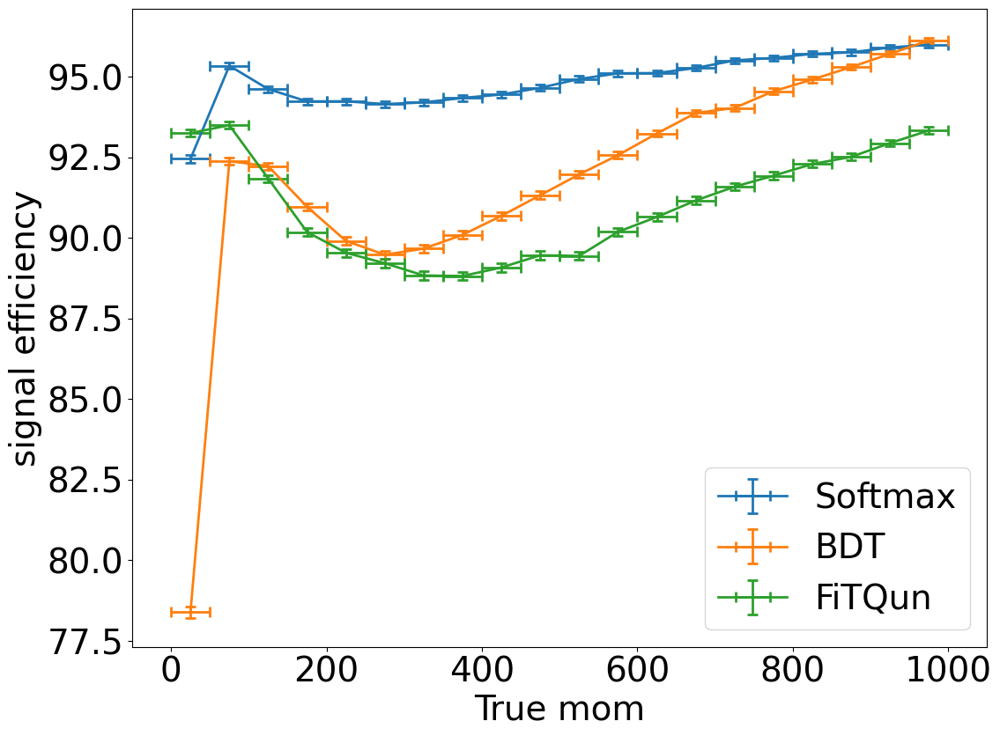

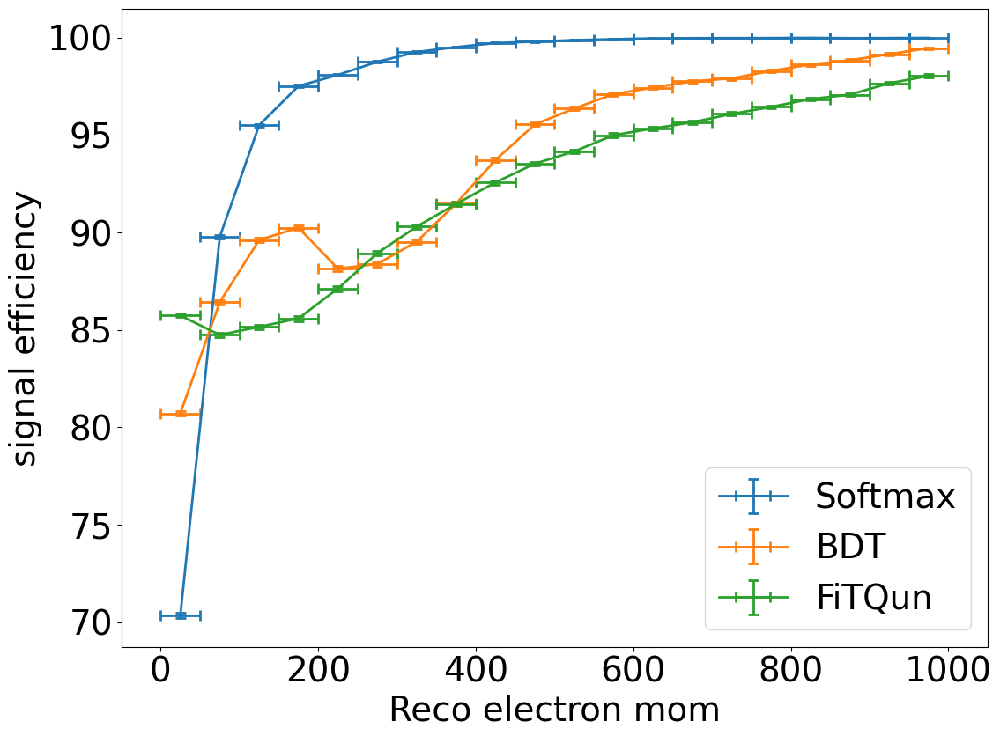

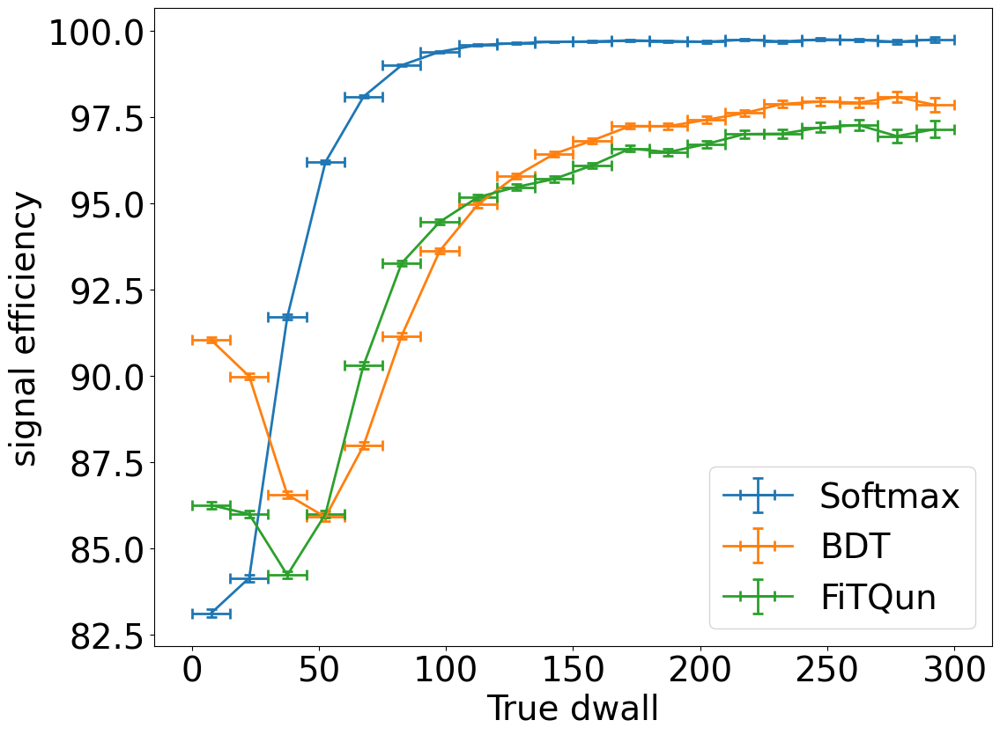

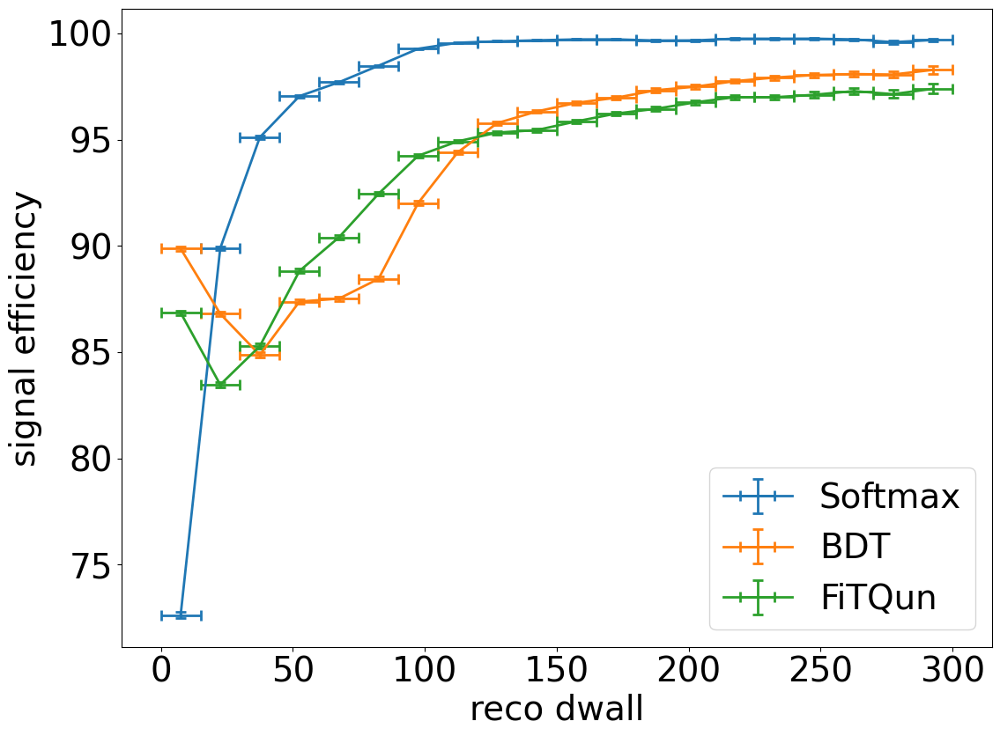

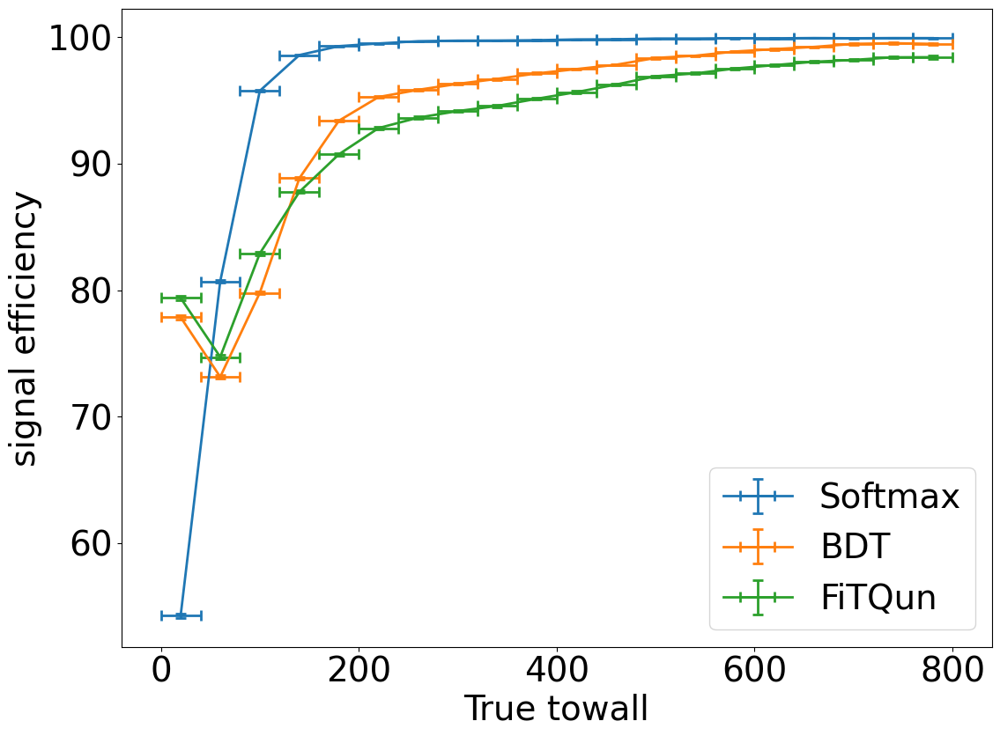

...

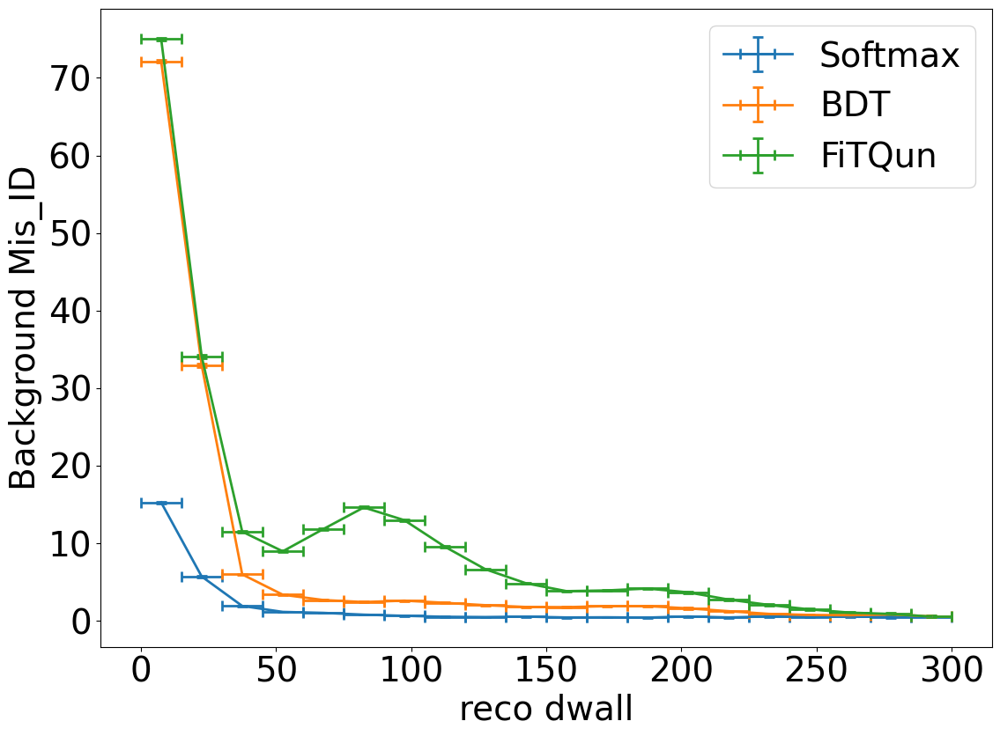

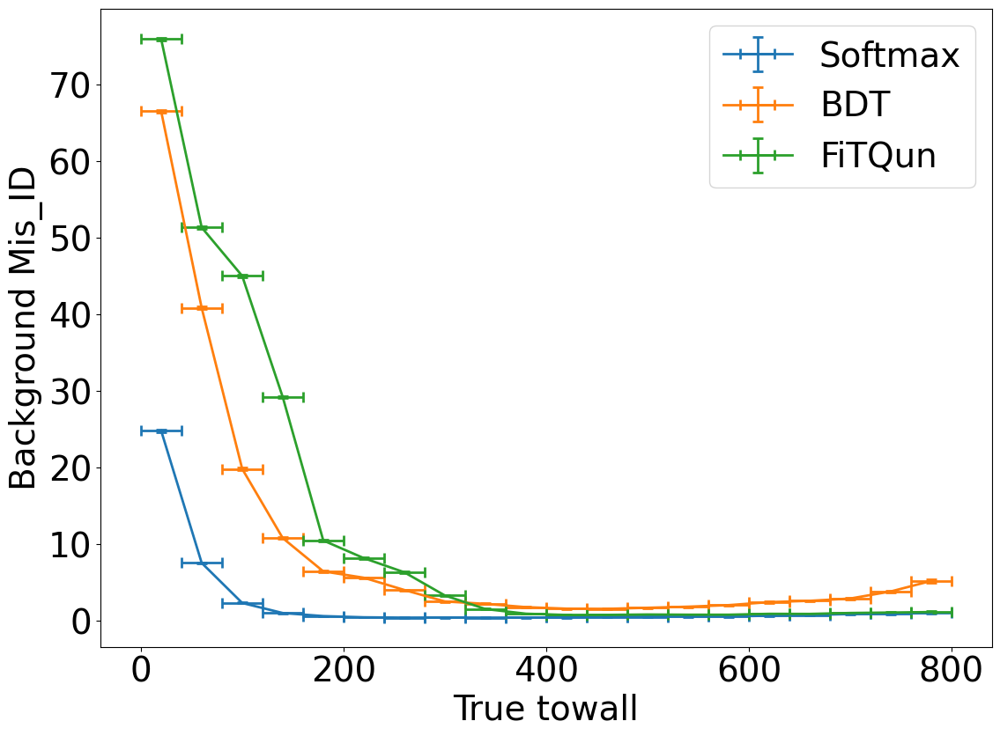

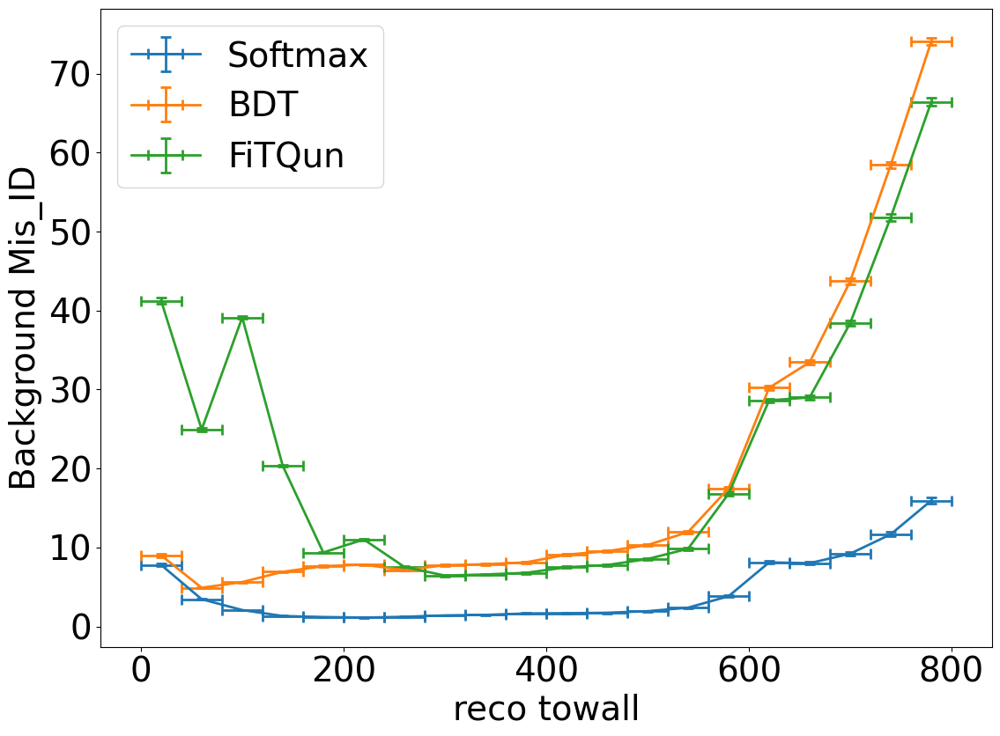

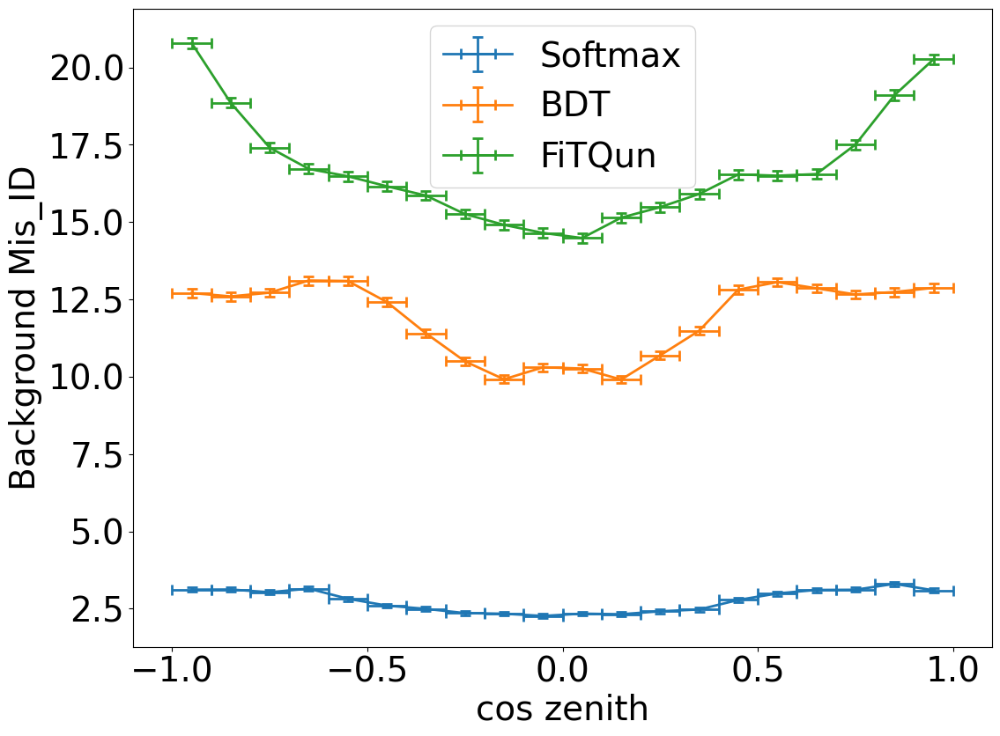

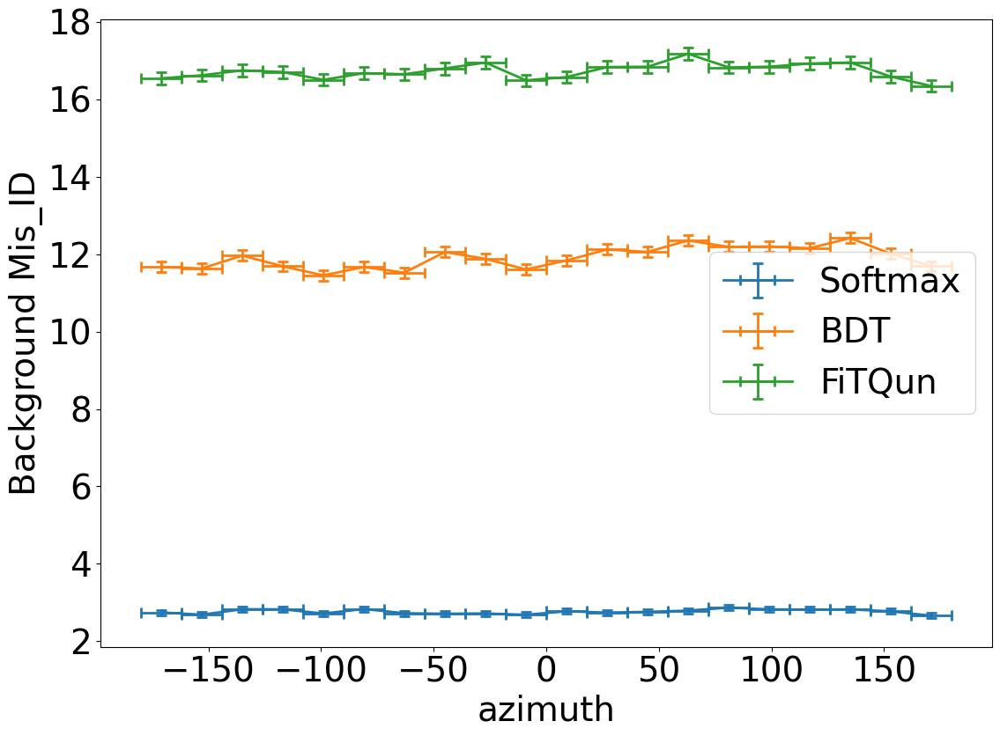

In [30]:
# Plotting efficiency profile using predefined cuts which have predefined fixed background rejection, before applying preselection

plot.efficiency_profile(df, 1, mom_binning, algorithms, cut_array=cuts, x_label='True mom', y_label='signal efficiency')
plot.efficiency_profile(df, 1, reco_mom_e_binning, algorithms, cut_array=cuts, x_label='Reco electron mom', y_label='signal efficiency')
plot.efficiency_profile(df, 1, dwall_binning, algorithms, cut_array=cuts, x_label='True dwall', y_label='signal efficiency')
plot.efficiency_profile(df, 1, reco_dwall_binning, algorithms, cut_array=cuts, x_label='reco dwall', y_label='signal efficiency')
plot.efficiency_profile(df, 1, towall_binning, algorithms, cut_array=cuts, x_label='True towall', y_label='signal efficiency')
plot.efficiency_profile(df, 1, reco_towall_binning, algorithms, cut_array=cuts, x_label='reco towall', y_label='signal efficiency')
plot.efficiency_profile(df, 1, cos_zenith_binning, algorithms, cut_array=cuts, x_label='cos zenith', y_label='signal efficiency')
plot.efficiency_profile(df, 1, azimuth_binning, algorithms, cut_array=cuts, x_label='azimuth', y_label='signal efficiency')

plot.efficiency_profile(df, 2, mom_binning, algorithms, cut_array=cuts, x_label='True mom', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, reco_mom_e_binning, algorithms, cut_array=cuts, x_label='Reco electron mom', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, dwall_binning, algorithms, cut_array=cuts, x_label='True dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, reco_dwall_binning, algorithms, cut_array=cuts, x_label='reco dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, towall_binning, algorithms, cut_array=cuts, x_label='True towall', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, reco_towall_binning, algorithms, cut_array=cuts, x_label='reco towall', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, cos_zenith_binning, algorithms, cut_array=cuts, x_label='cos zenith', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, azimuth_binning, algorithms, cut_array=cuts, x_label='azimuth', y_label='Background Mis_ID')


(<Figure size 1200x900 with 1 Axes>,
 <AxesSubplot: xlabel='azimuth', ylabel='Background Mis_ID'>)

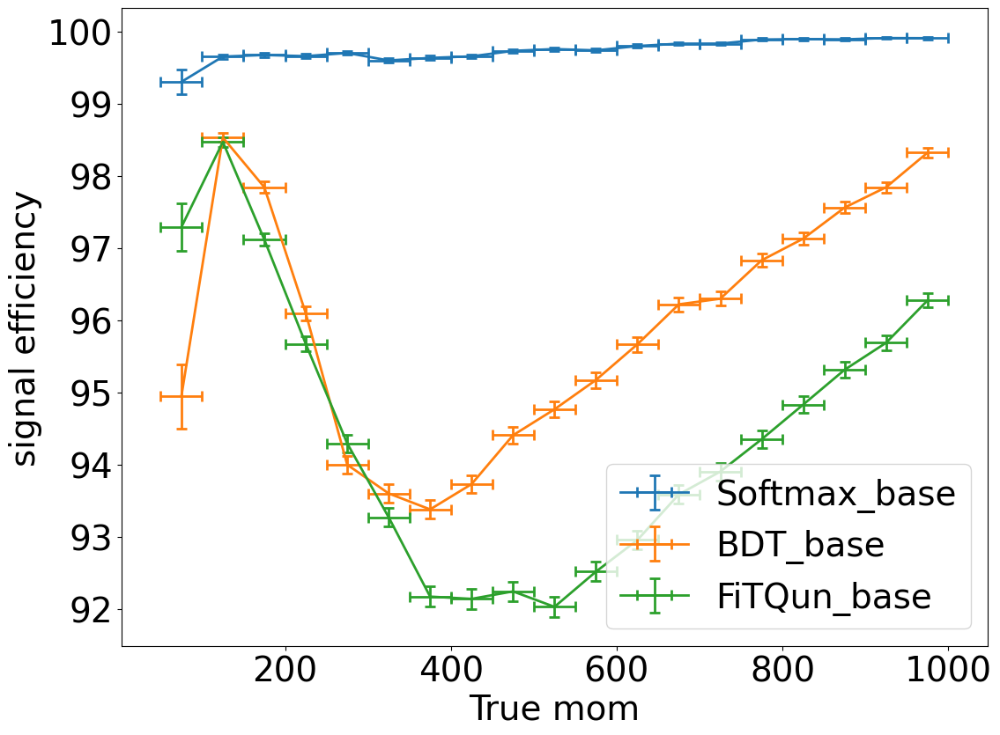

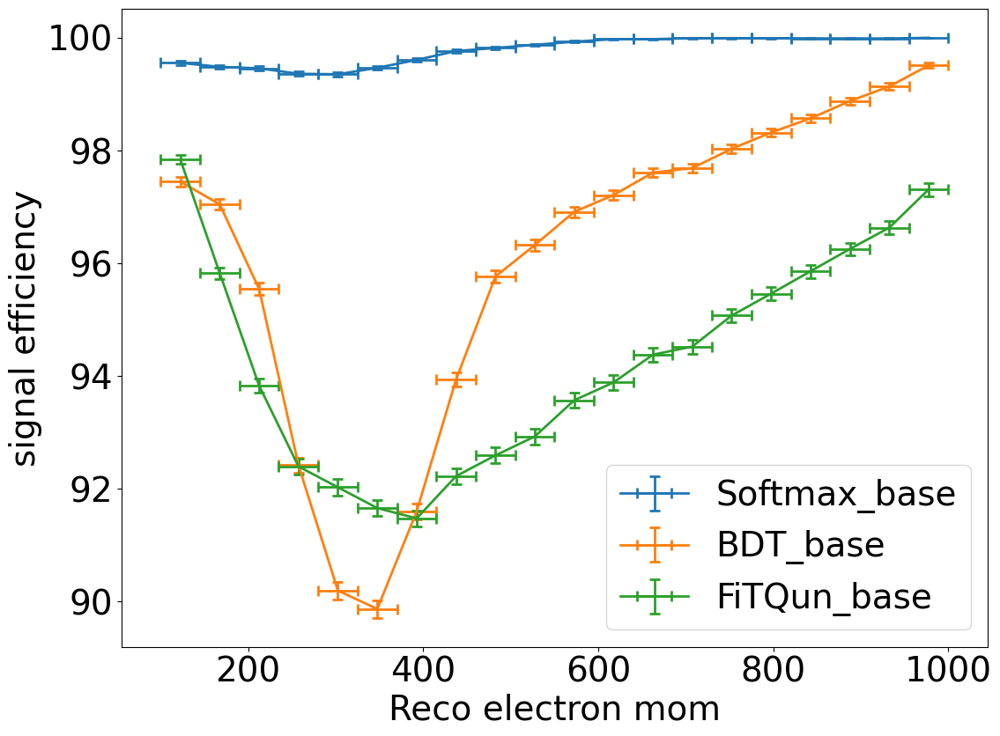

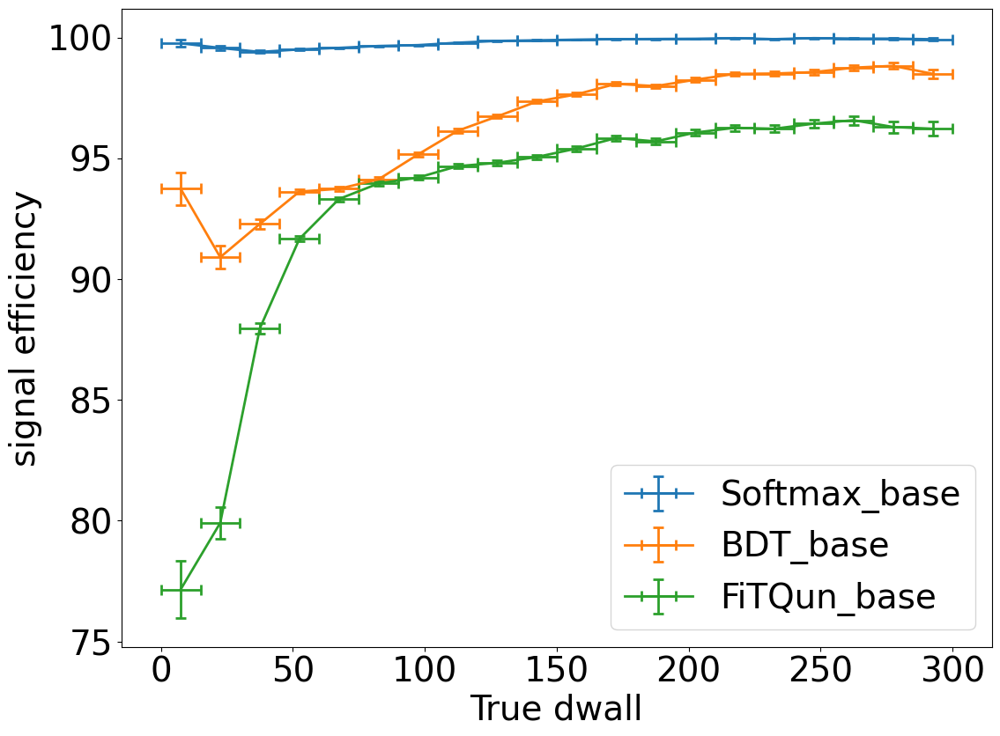

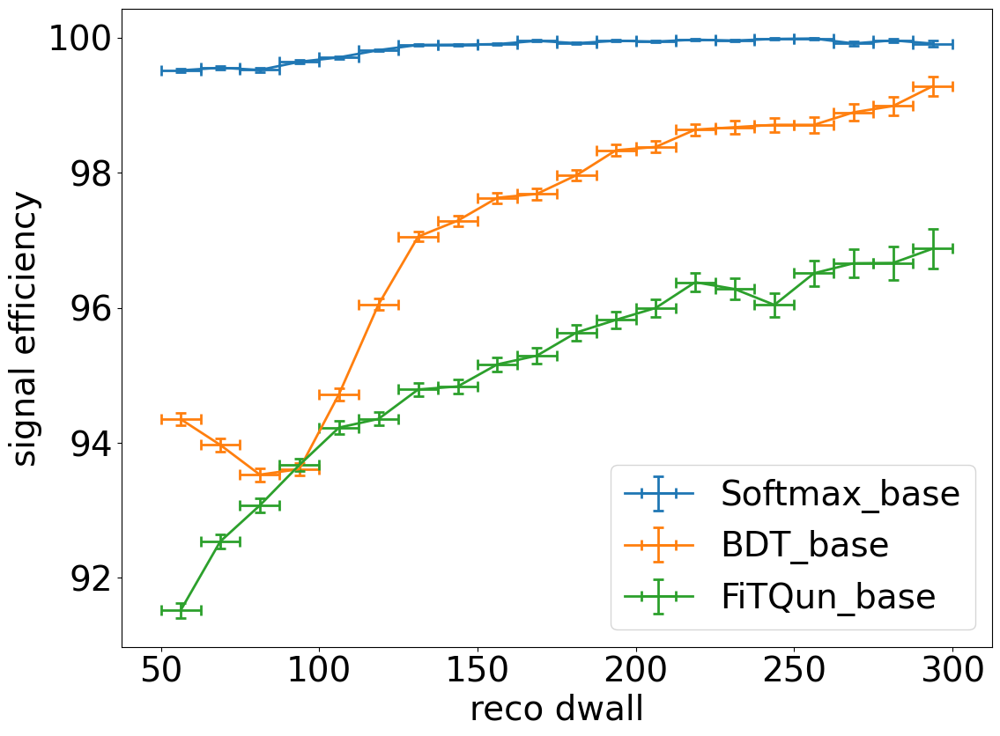

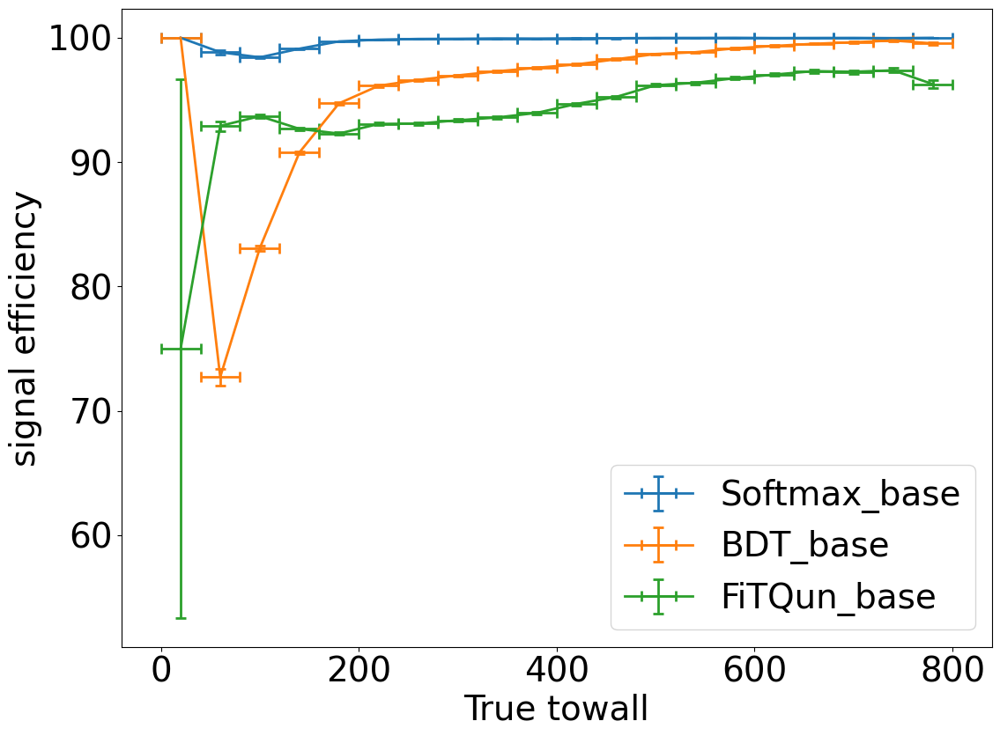

...

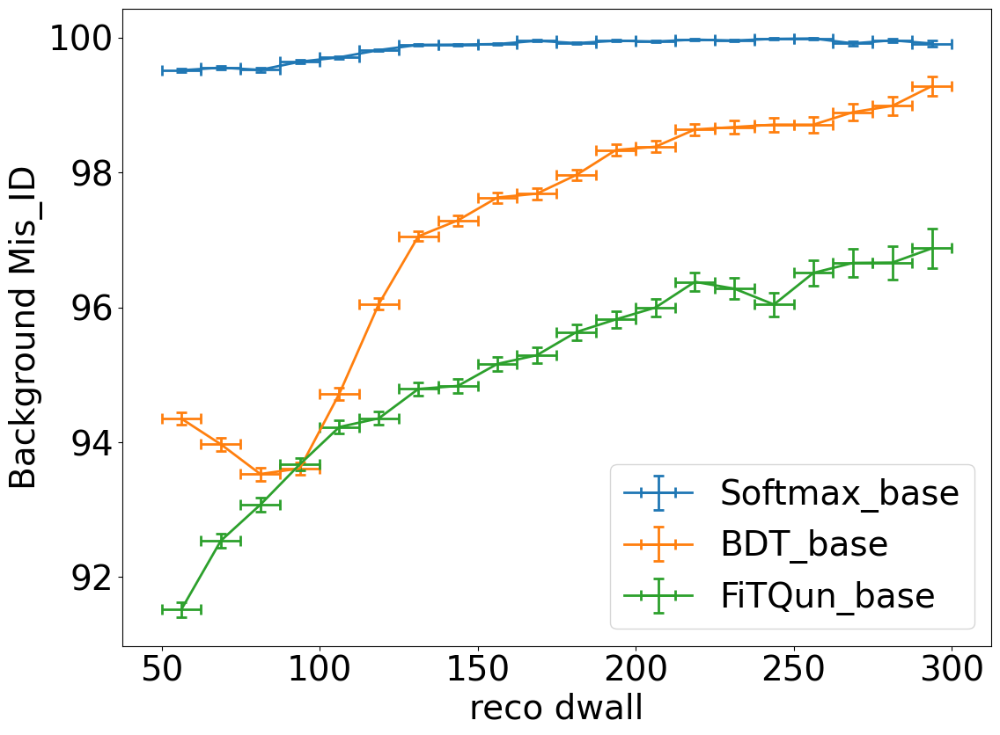

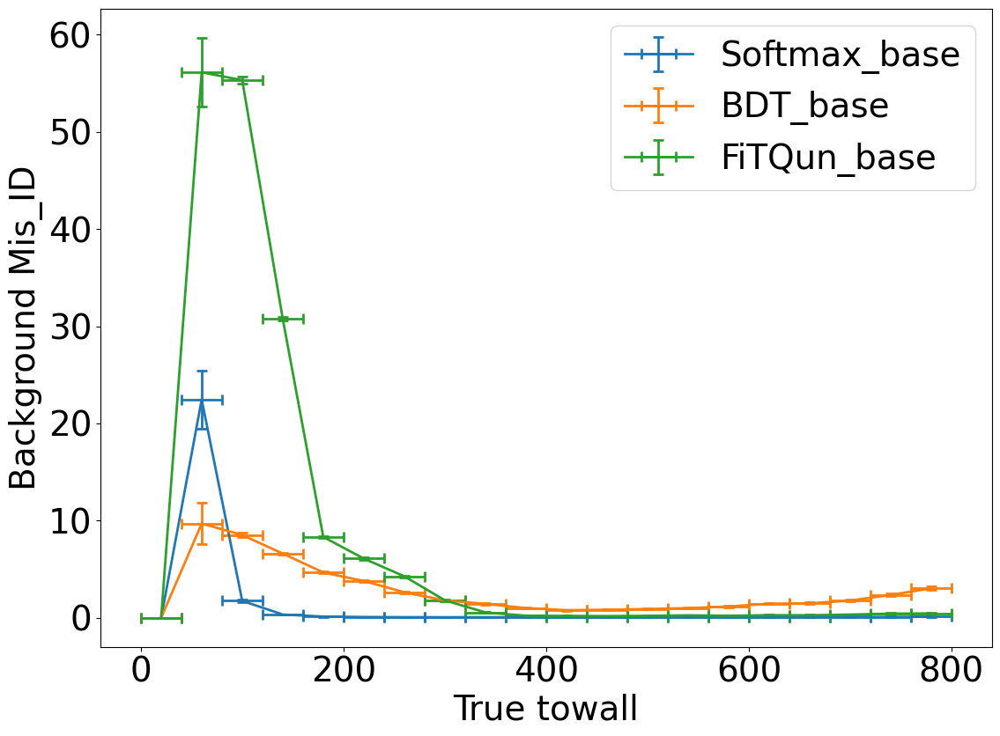

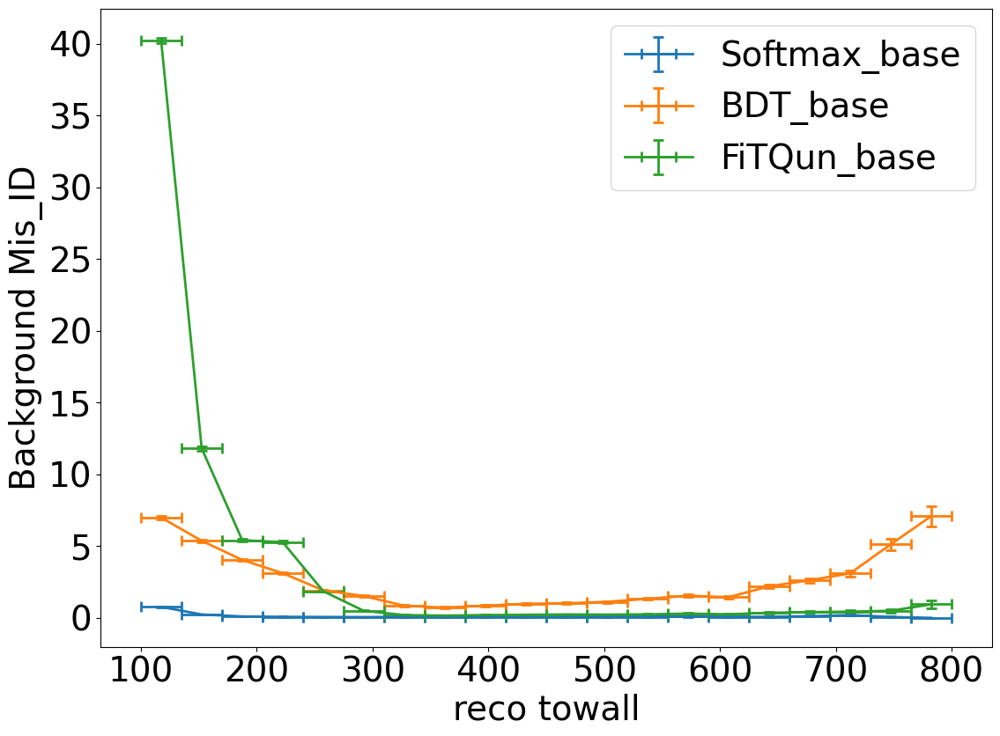

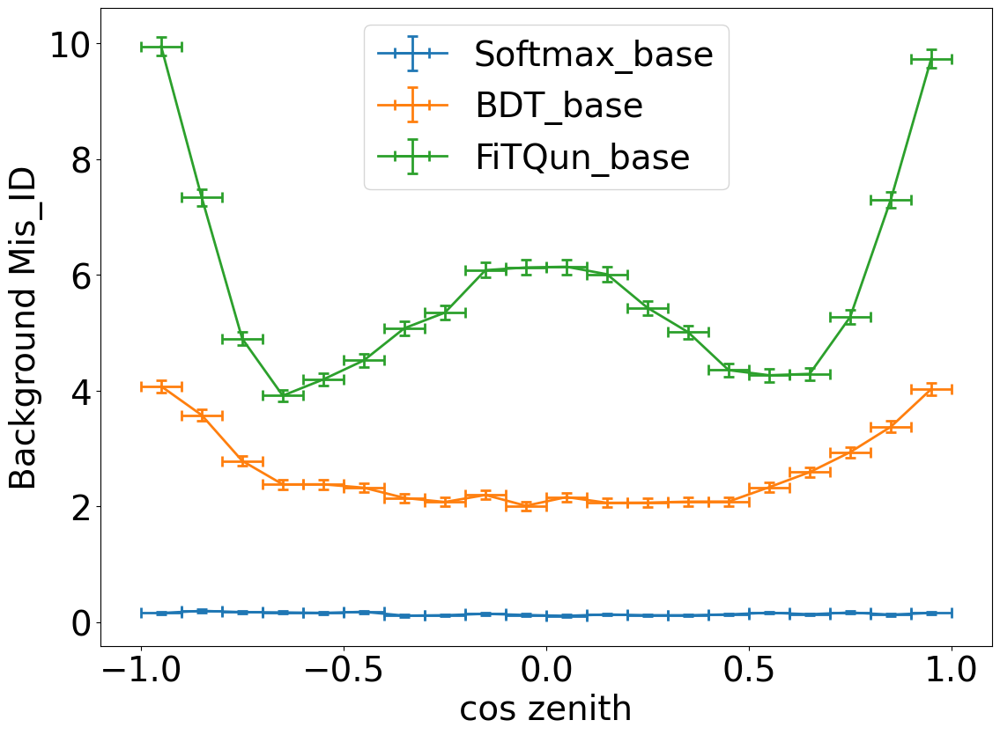

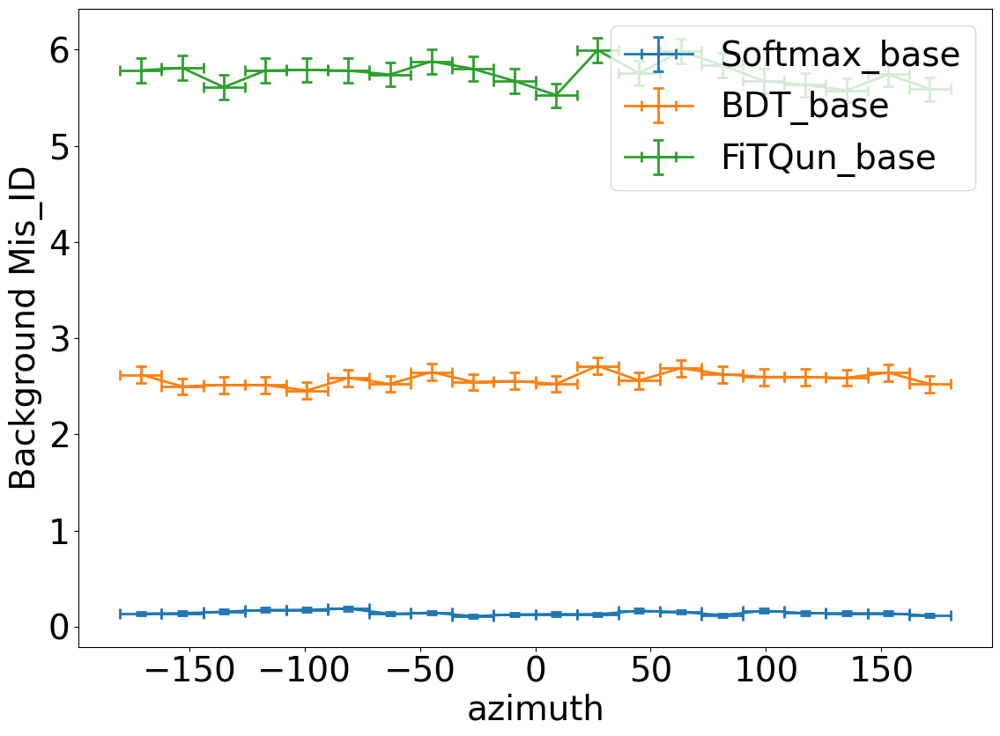

In [31]:
# Plotting efficiency profile using predefined cuts which have predefined fixed background rejection, after applying preselection

plot.efficiency_profile(df_base, 1, mom_binning_base, algorithms_base, cut_array=cuts_base, x_label='True mom', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, reco_mom_e_binning_base, algorithms_base, cut_array=cuts_base, x_label='Reco electron mom', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, dwall_binning_base, algorithms_base, cut_array=cuts_base, x_label='True dwall', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, reco_dwall_binning_base, algorithms_base, cut_array=cuts_base, x_label='reco dwall', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, towall_binning_base, algorithms_base, cut_array=cuts_base, x_label='True towall', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, reco_towall_binning_base, algorithms_base, cut_array=cuts_base, x_label='reco towall', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, cos_zenith_binning_base, algorithms_base, cut_array=cuts_base, x_label='cos zenith', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, azimuth_binning_base, algorithms_base, cut_array=cuts_base, x_label='azimuth', y_label='signal efficiency')

plot.efficiency_profile(df_base, 2, mom_binning_base, algorithms_base, cut_array=cuts_base, x_label='True mom', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, reco_mom_e_binning_base, algorithms_base, cut_array=cuts_base, x_label='Reco electron mom', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, dwall_binning_base, algorithms_base, cut_array=cuts_base, x_label='True dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 1, reco_dwall_binning_base, algorithms_base, cut_array=cuts_base, x_label='reco dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, towall_binning_base, algorithms_base, cut_array=cuts_base, x_label='True towall', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, reco_towall_binning_base, algorithms_base, cut_array=cuts_base, x_label='reco towall', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, cos_zenith_binning_base, algorithms_base, cut_array=cuts_base, x_label='cos zenith', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, azimuth_binning_base, algorithms_base, cut_array=cuts_base, x_label='azimuth', y_label='Background Mis_ID')

(<Figure size 1200x900 with 1 Axes>,
 <AxesSubplot: xlabel='azimuth', ylabel='Background Mis_ID'>)

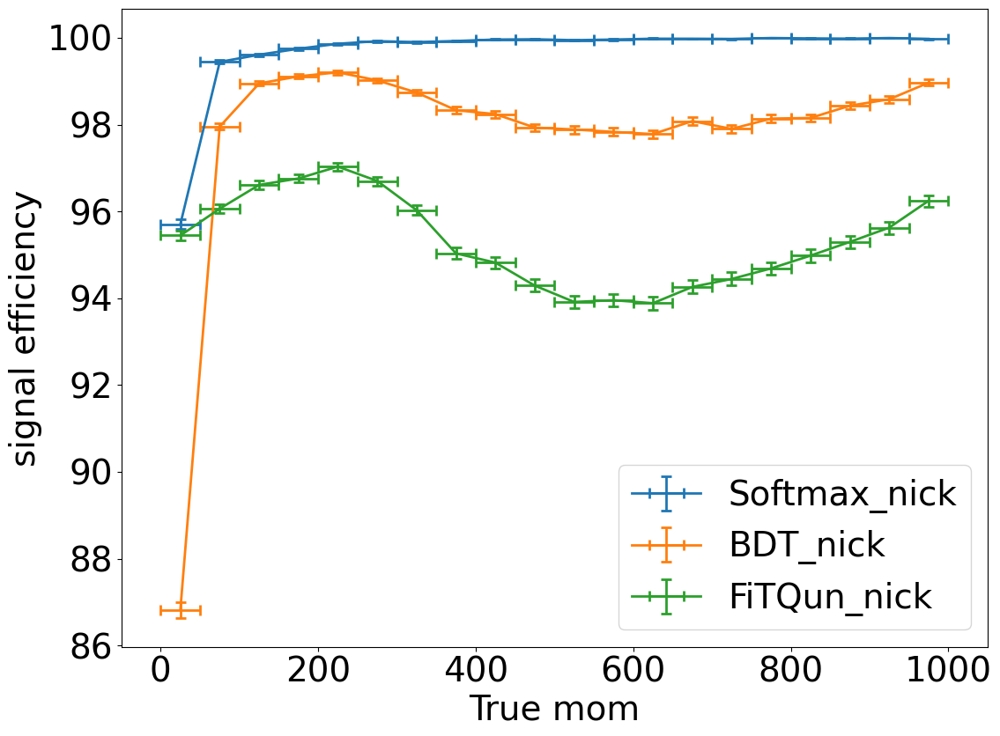

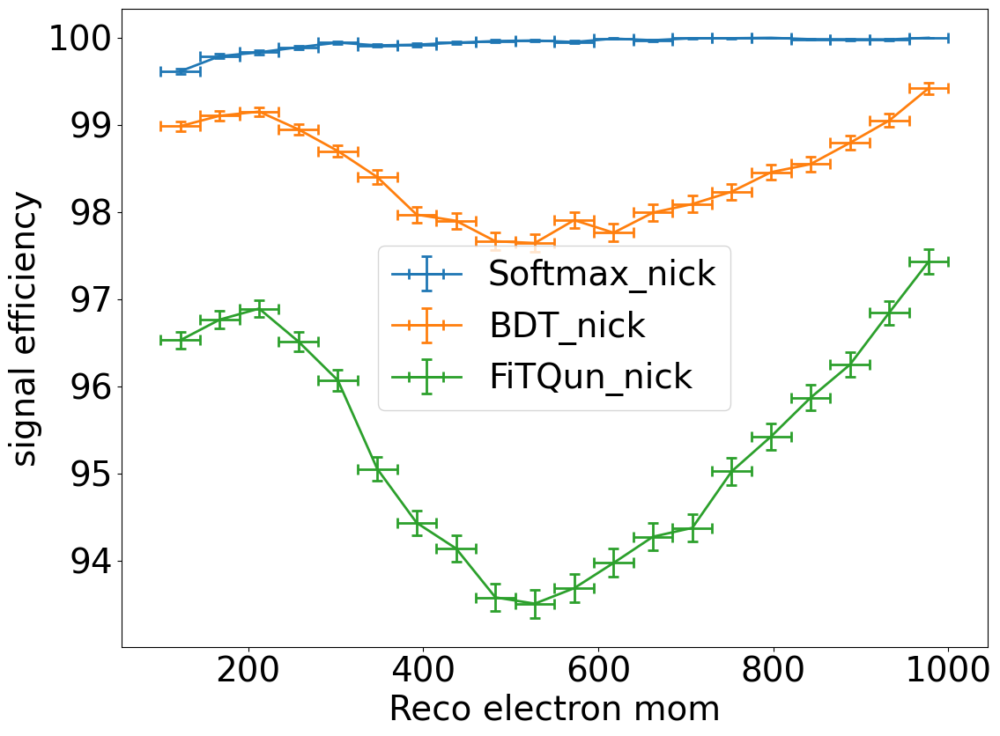

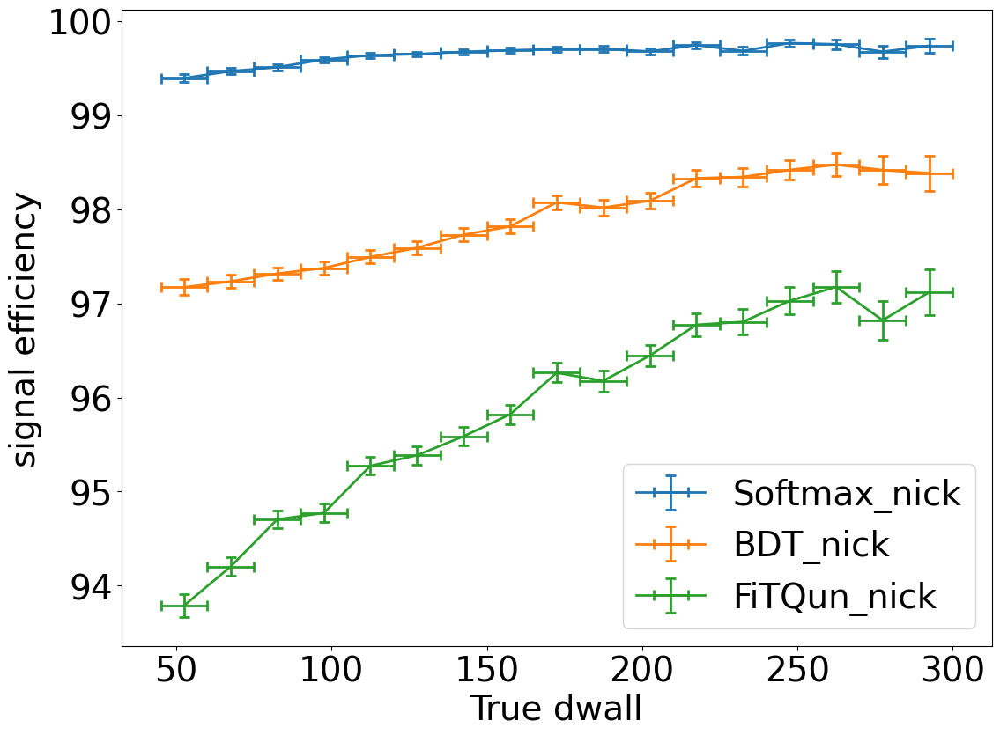

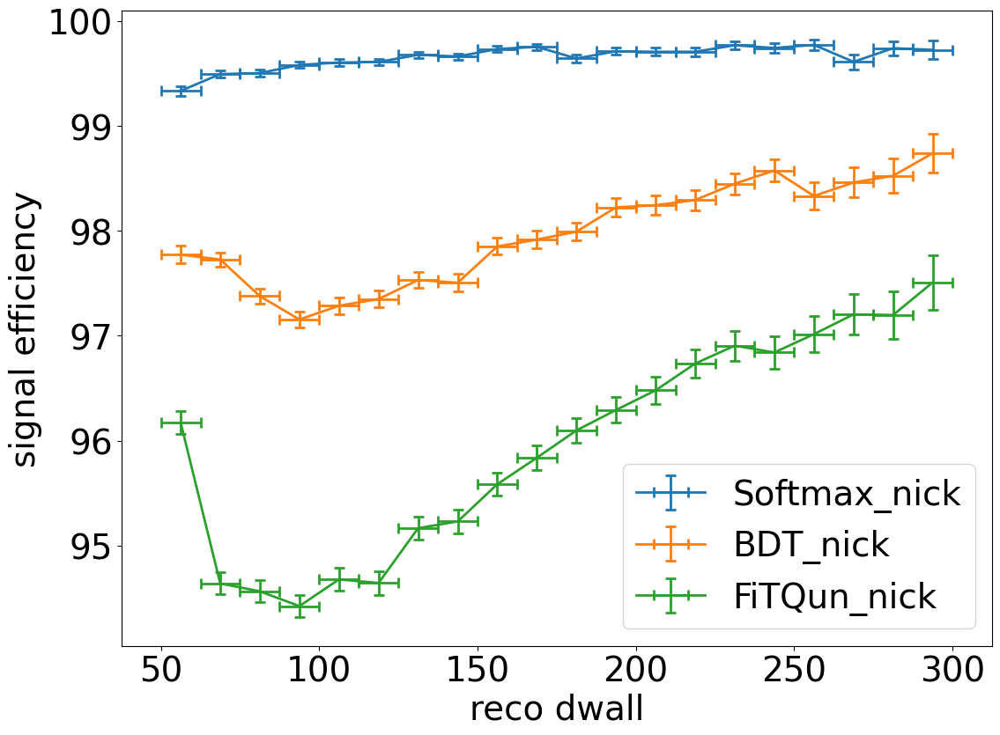

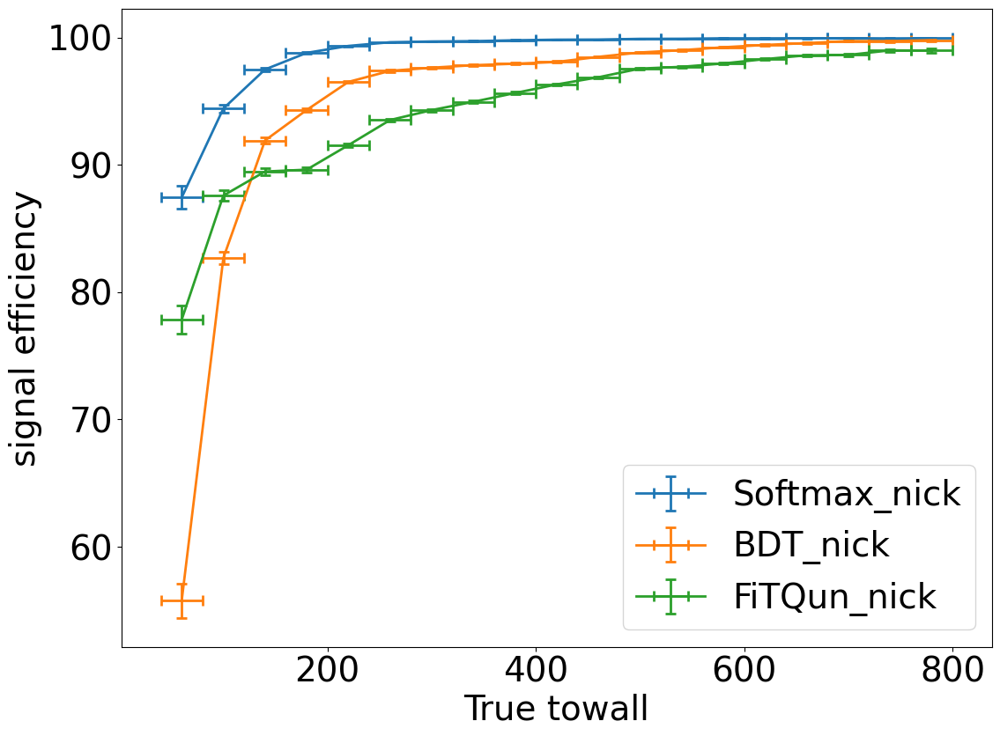

...

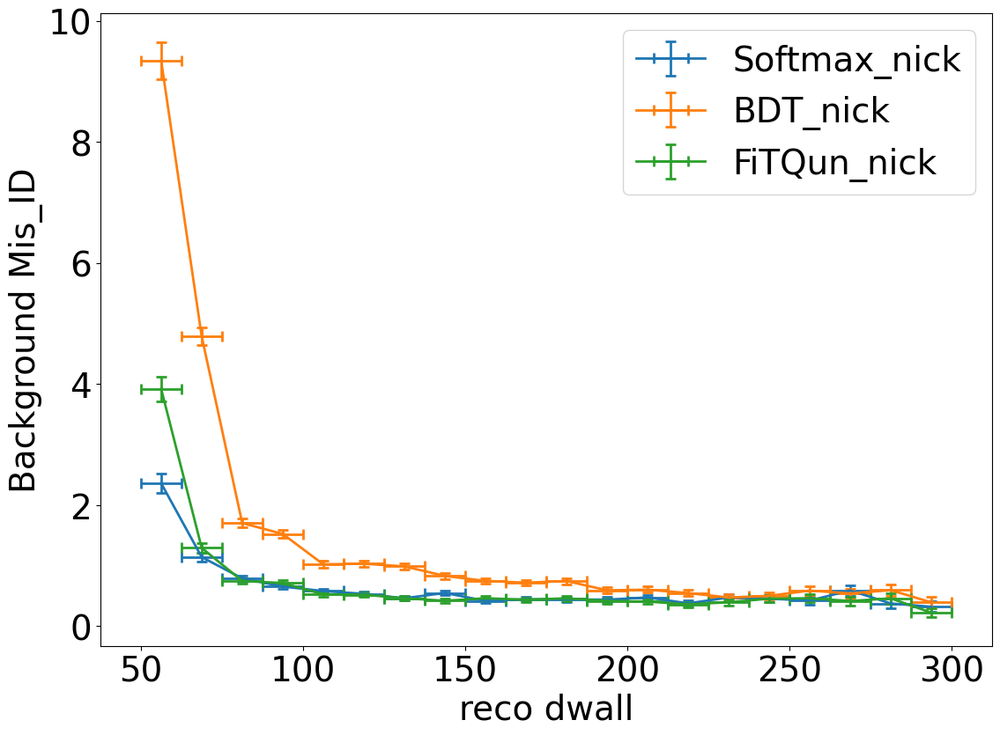

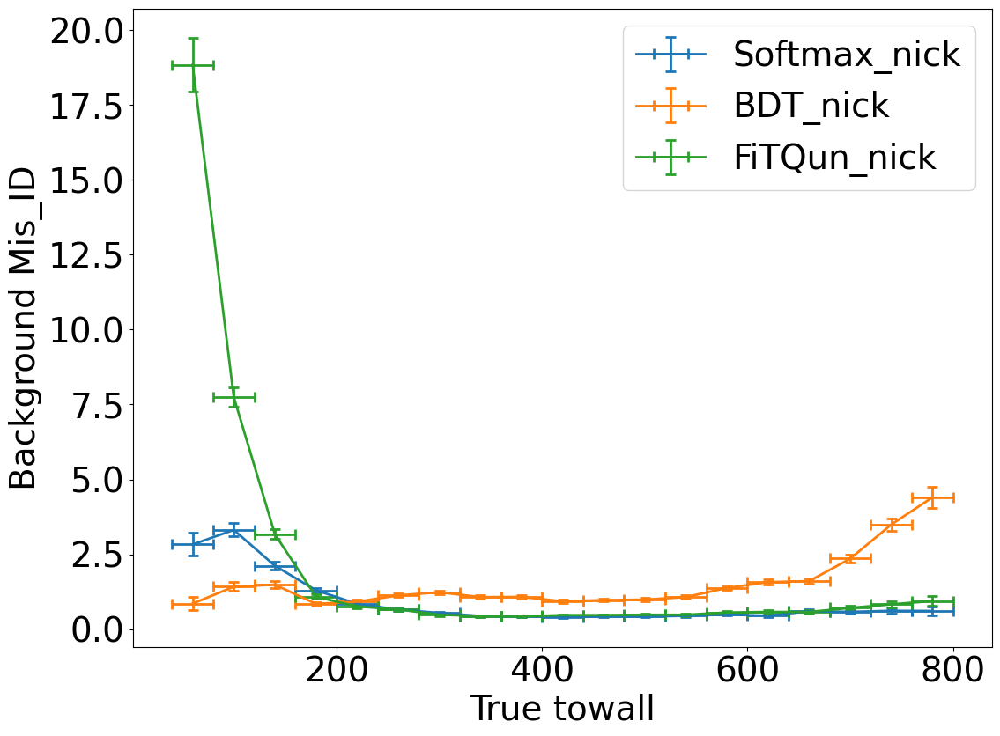

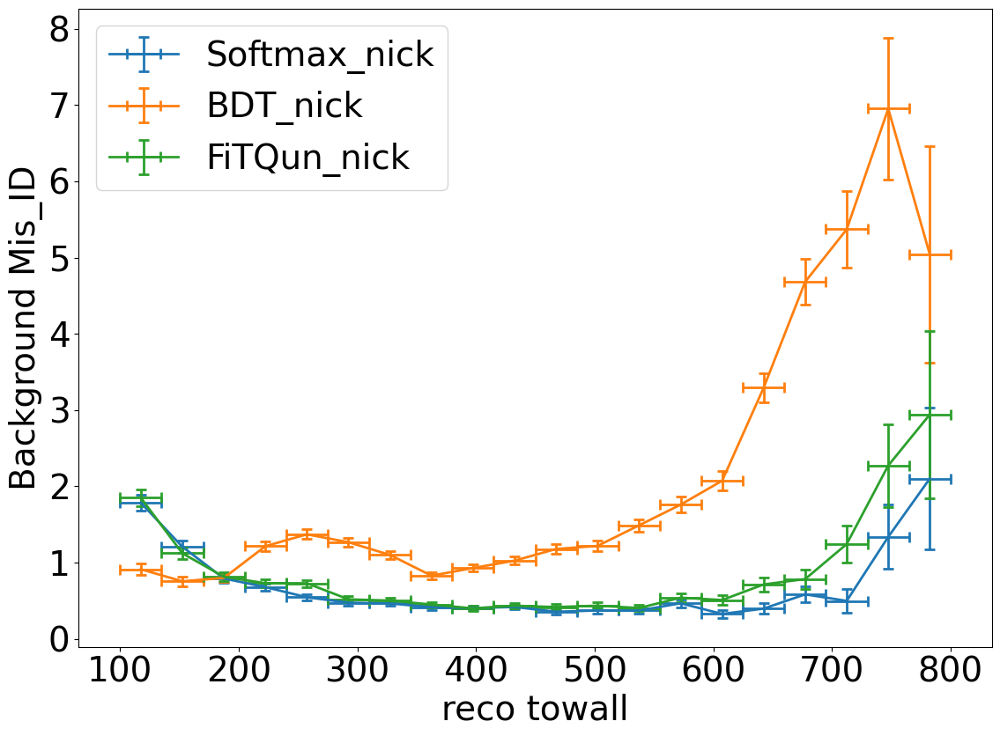

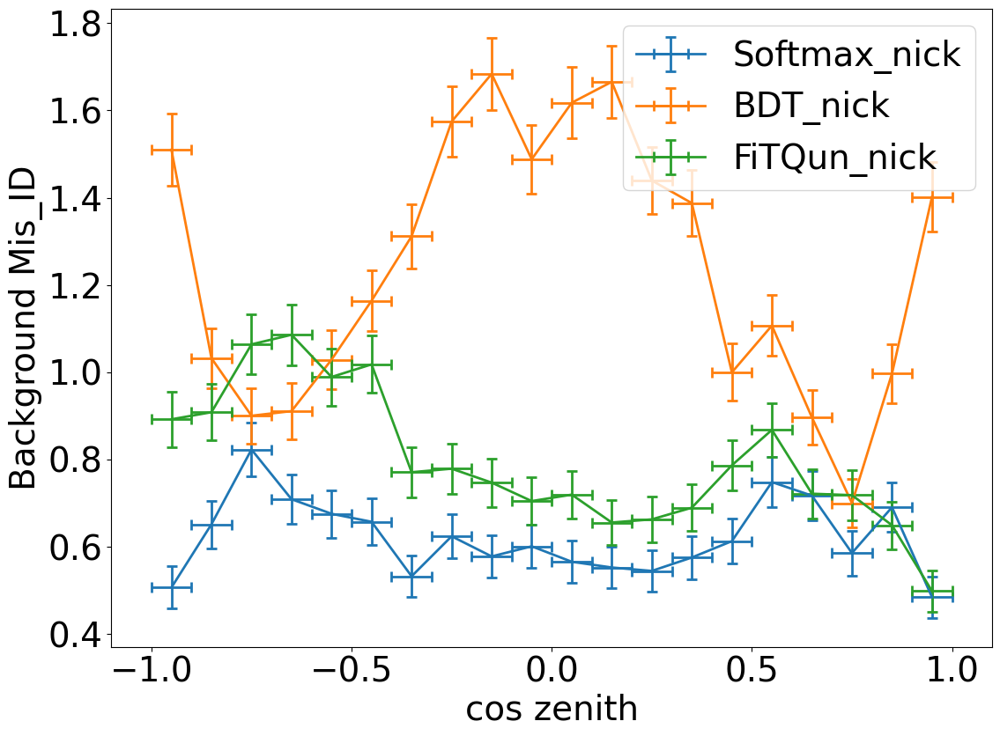

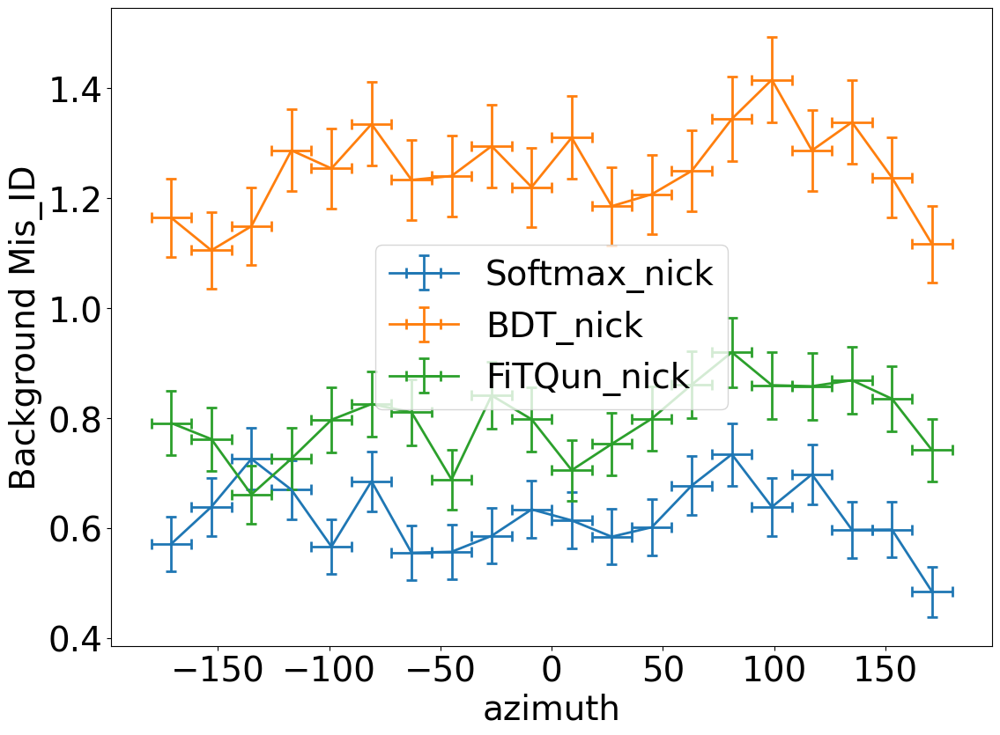

In [32]:
# Plotting efficiency profile using predefined cuts which have predefined fixed background rejection, after applying nicks preselection

plot.efficiency_profile(df_nick, 1, mom_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='True mom', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, reco_mom_e_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='Reco electron mom', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, dwall_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='True dwall', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, reco_dwall_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='reco dwall', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, towall_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='True towall', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, reco_towall_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='reco towall', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, cos_zenith_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='cos zenith', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, azimuth_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='azimuth', y_label='signal efficiency')

plot.efficiency_profile(df_nick, 2, mom_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='True mom', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, reco_mom_e_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='Reco electron mom', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, dwall_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='True dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, reco_dwall_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='reco dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, towall_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='True towall', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, reco_towall_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='reco towall', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, cos_zenith_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='cos zenith', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, azimuth_binning_nick, algorithms_nick, cut_array=cuts_nick, x_label='azimuth', y_label='Background Mis_ID')

In [33]:
# Using fixed background rejection and plotting the efficiency profile over different varibales:

muon_rejection = 0.999
fixed_rejection_cuts, fixed_rejection_thresholds = classification_metrics.cut_with_fixed_rejection(df, probs, 2, muon_rejection)
fixed_rejection_cuts_base, fixed_rejection_thresholds_base = classification_metrics.cut_with_fixed_rejection(df_base, probs_base, 2, muon_rejection)
fixed_rejection_cuts_nick, fixed_rejection_thresholds_nick = classification_metrics.cut_with_fixed_rejection(df_nick, probs_nick, 2, muon_rejection)

(<Figure size 1200x900 with 1 Axes>,
 <AxesSubplot: xlabel='azimuth', ylabel='Background Mis_ID'>)

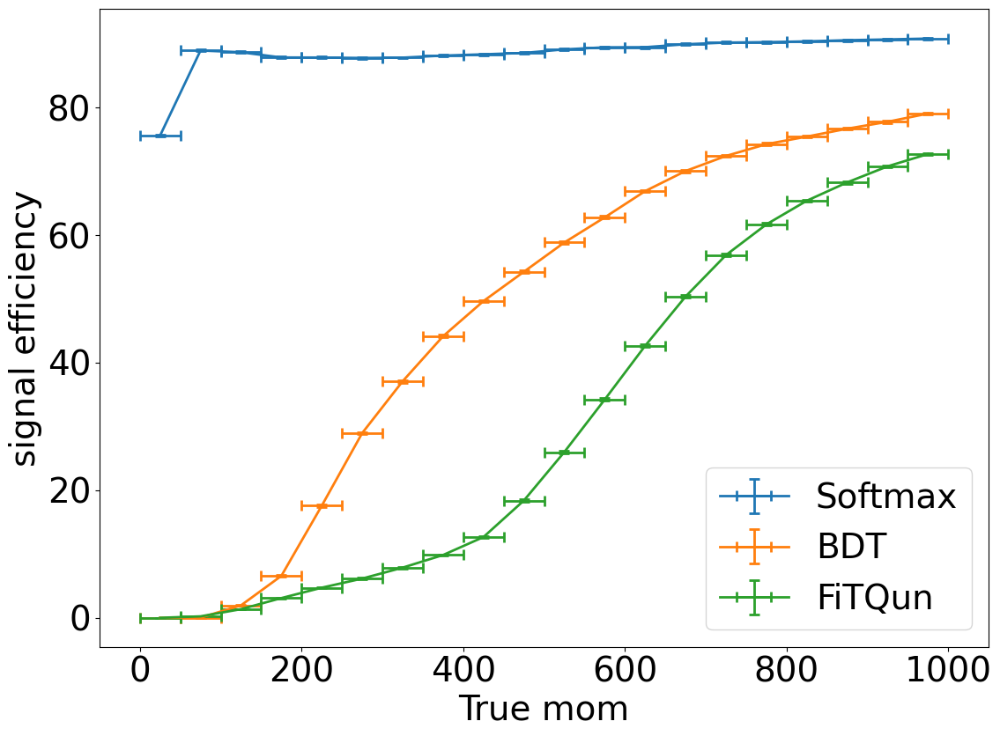

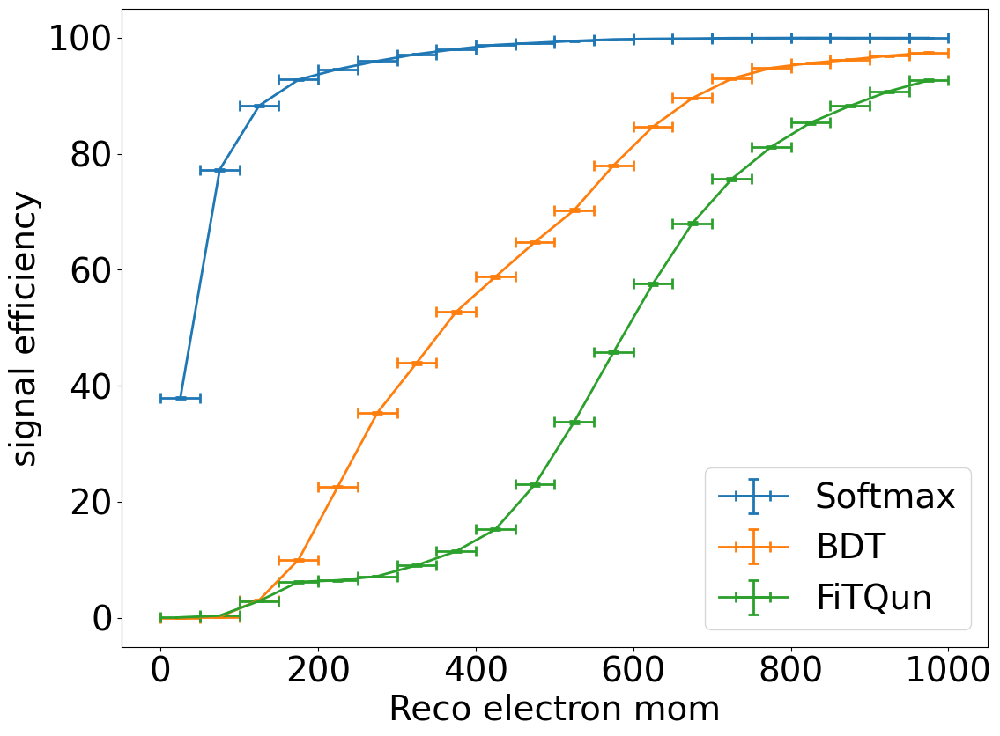

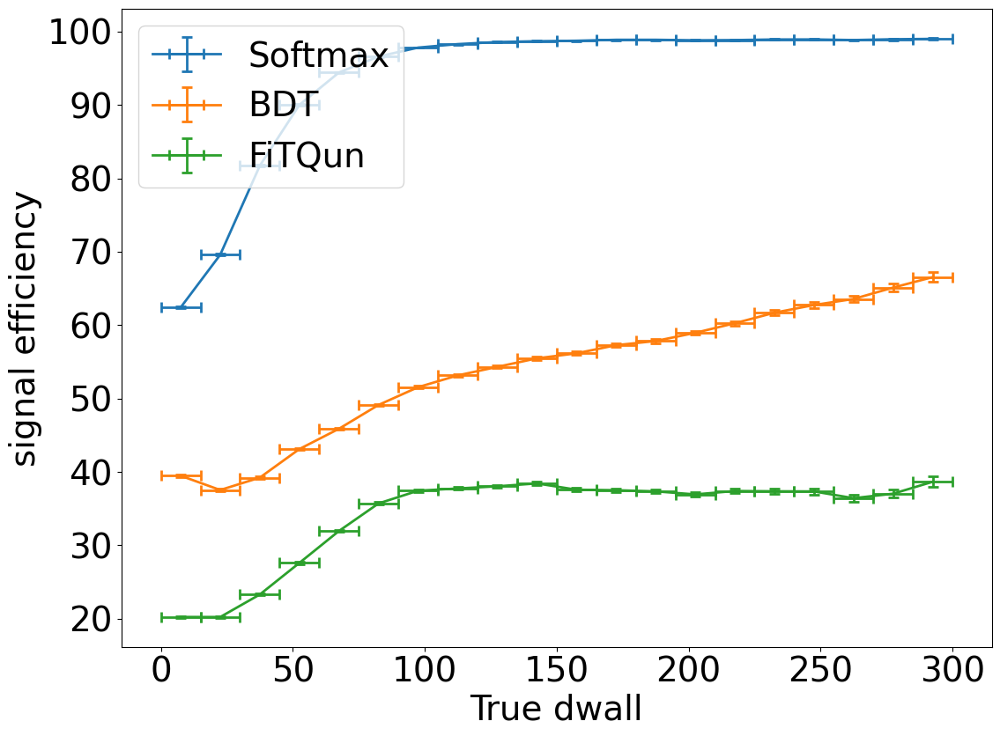

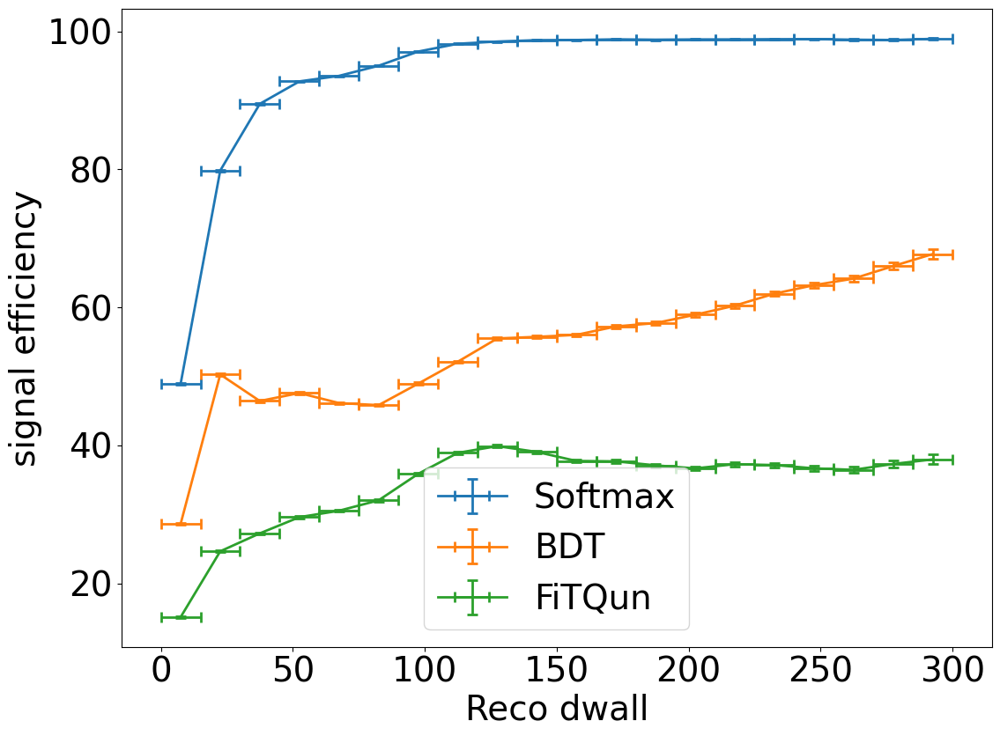

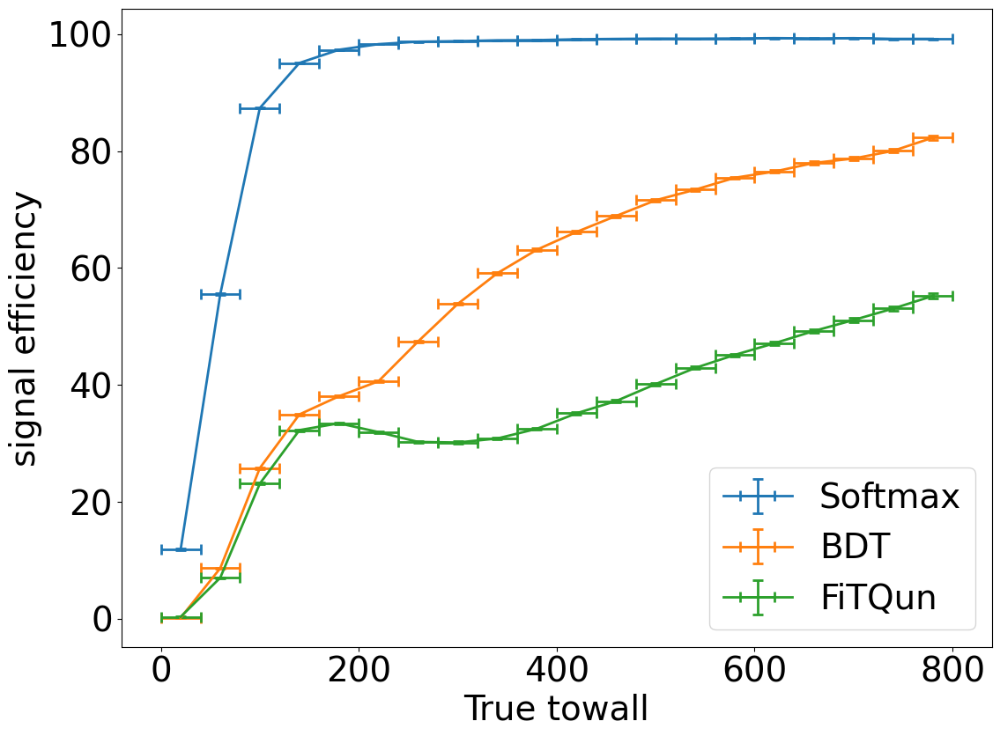

...

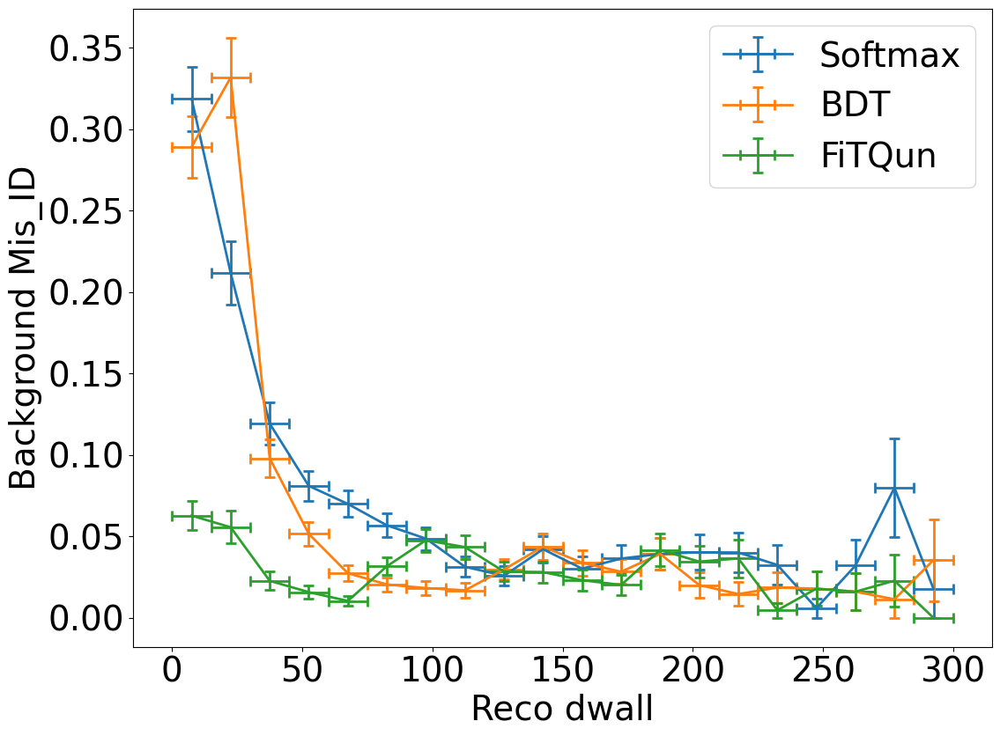

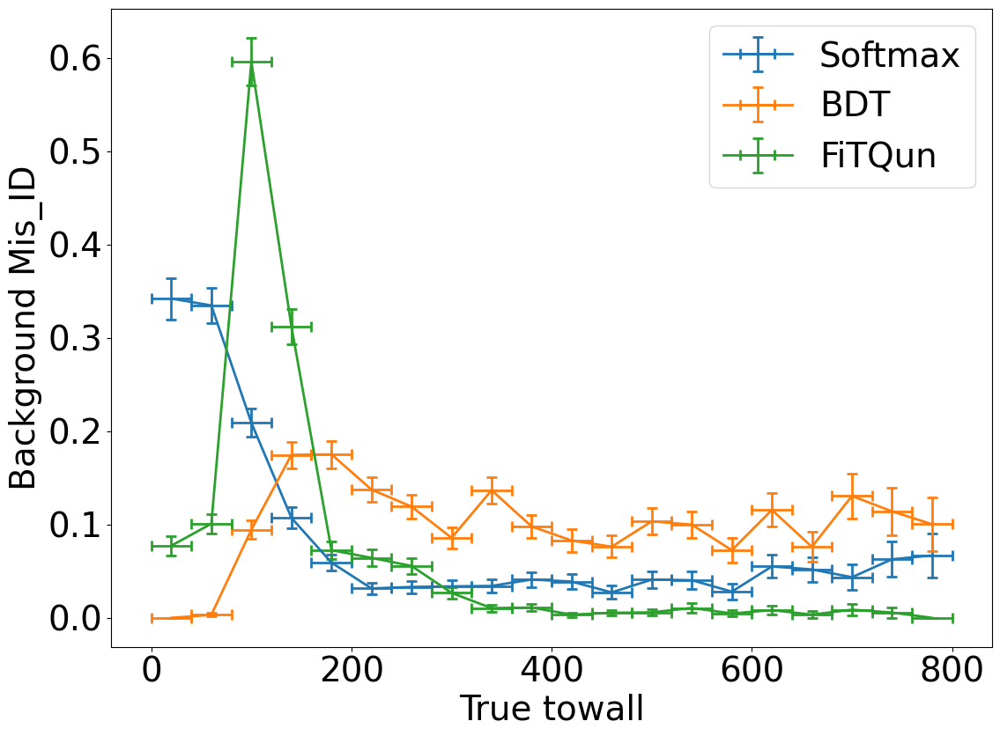

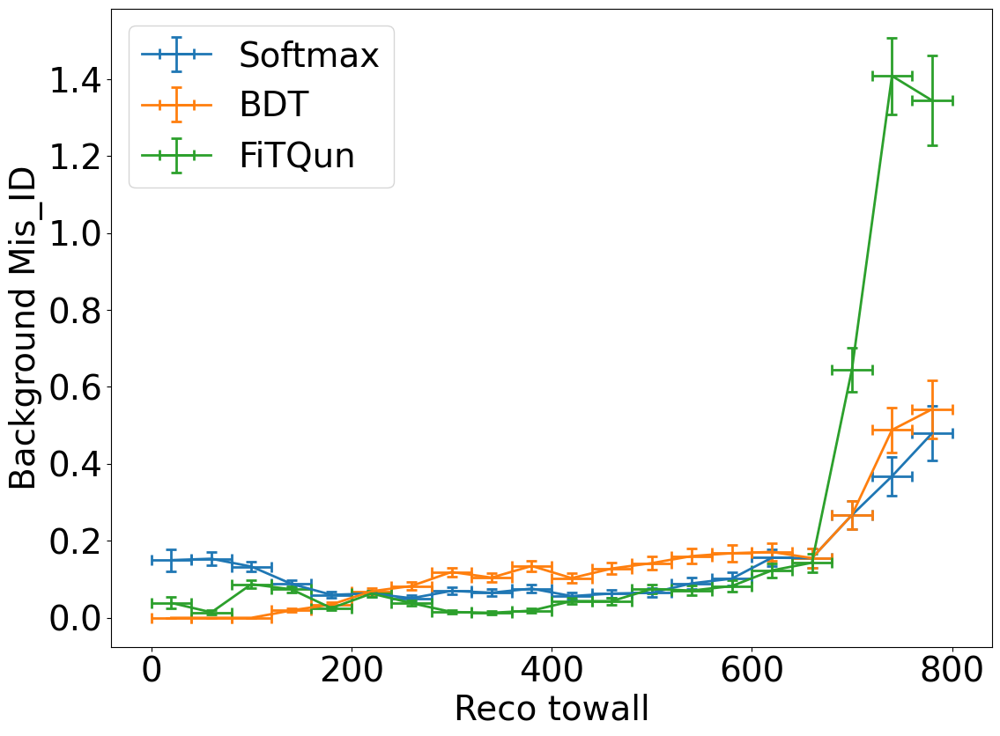

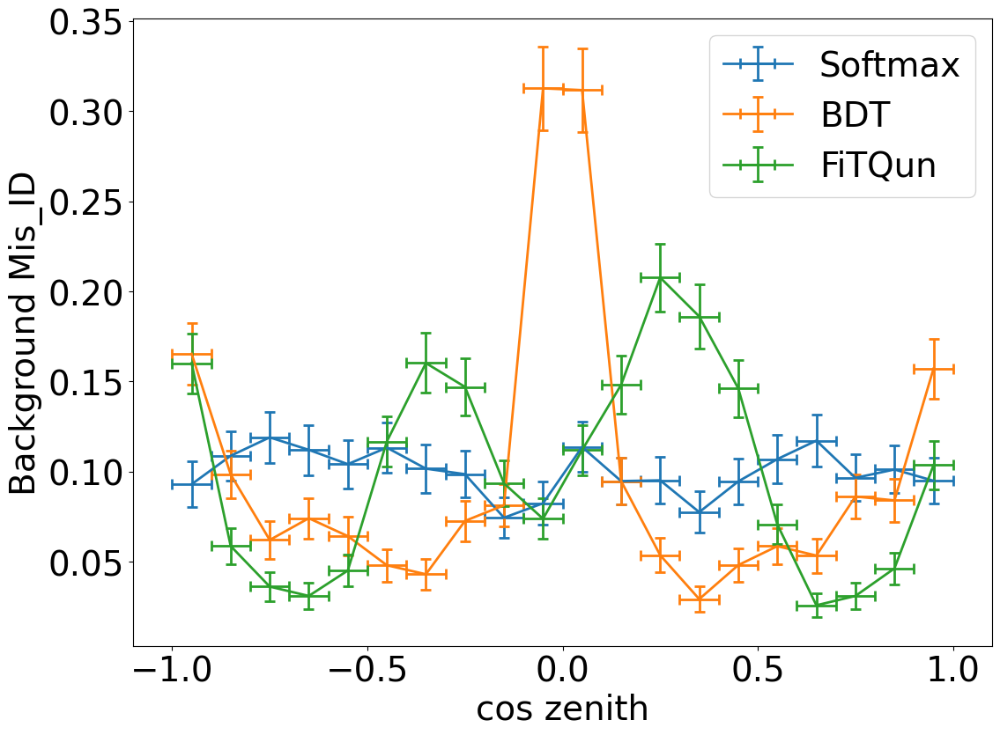

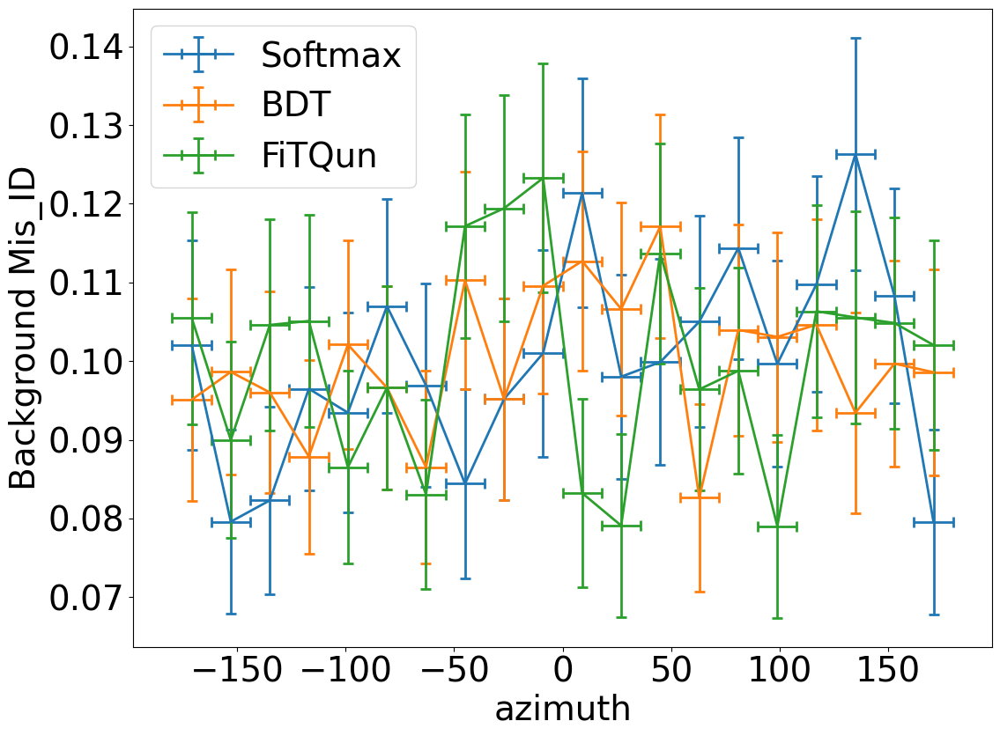

In [34]:
# Plotting efficiency profile using muon_rejection of 0.99, before applying preselection

plot.efficiency_profile(df, 1, mom_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='True mom', y_label='signal efficiency')
plot.efficiency_profile(df, 1, reco_mom_e_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='Reco electron mom', y_label='signal efficiency')
plot.efficiency_profile(df, 1, dwall_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='True dwall', y_label='signal efficiency')
plot.efficiency_profile(df, 1, reco_dwall_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='Reco dwall', y_label='signal efficiency')
plot.efficiency_profile(df, 1, towall_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='True towall', y_label='signal efficiency')
plot.efficiency_profile(df, 1, reco_towall_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='Reco towall', y_label='signal efficiency')
plot.efficiency_profile(df, 1, cos_zenith_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='cos zenith', y_label='signal efficiency')
plot.efficiency_profile(df, 1, azimuth_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='azimuth', y_label='signal efficiency')

plot.efficiency_profile(df, 2, mom_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='True mom', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, reco_mom_e_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='Reco electron mom', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, dwall_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='True dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, reco_dwall_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='Reco dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, towall_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='True towall', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, reco_towall_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='Reco towall', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, cos_zenith_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='cos zenith', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, azimuth_binning, algorithms, cut_array=fixed_rejection_cuts, x_label='azimuth', y_label='Background Mis_ID')

(<Figure size 1200x900 with 1 Axes>,
 <AxesSubplot: xlabel='azimuth', ylabel='Background Mis_ID'>)

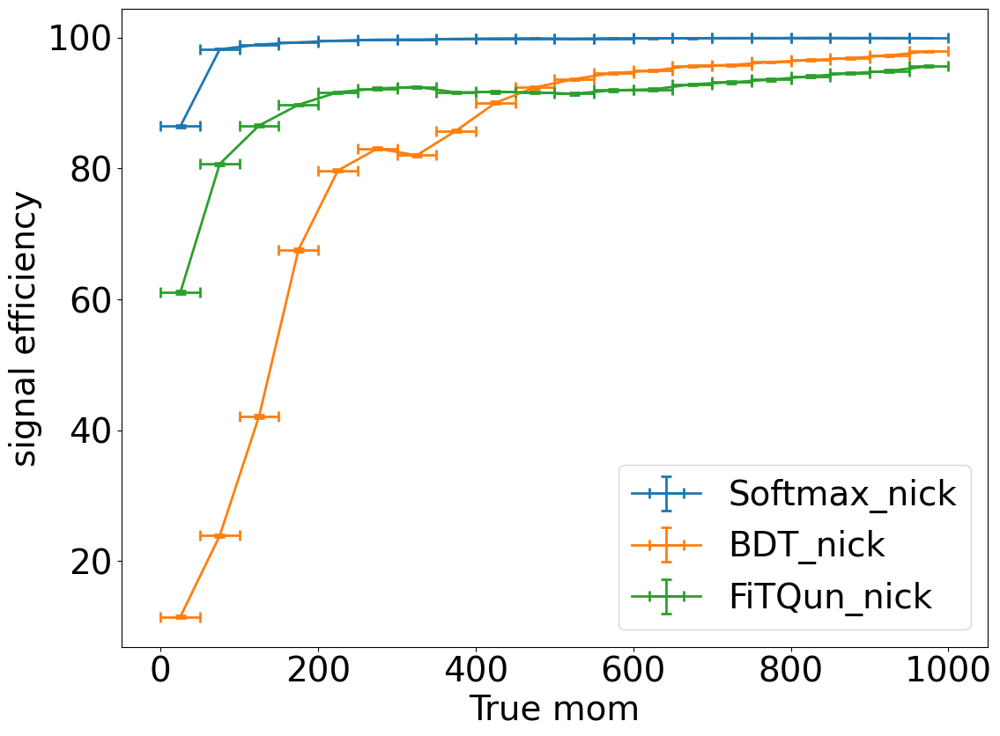

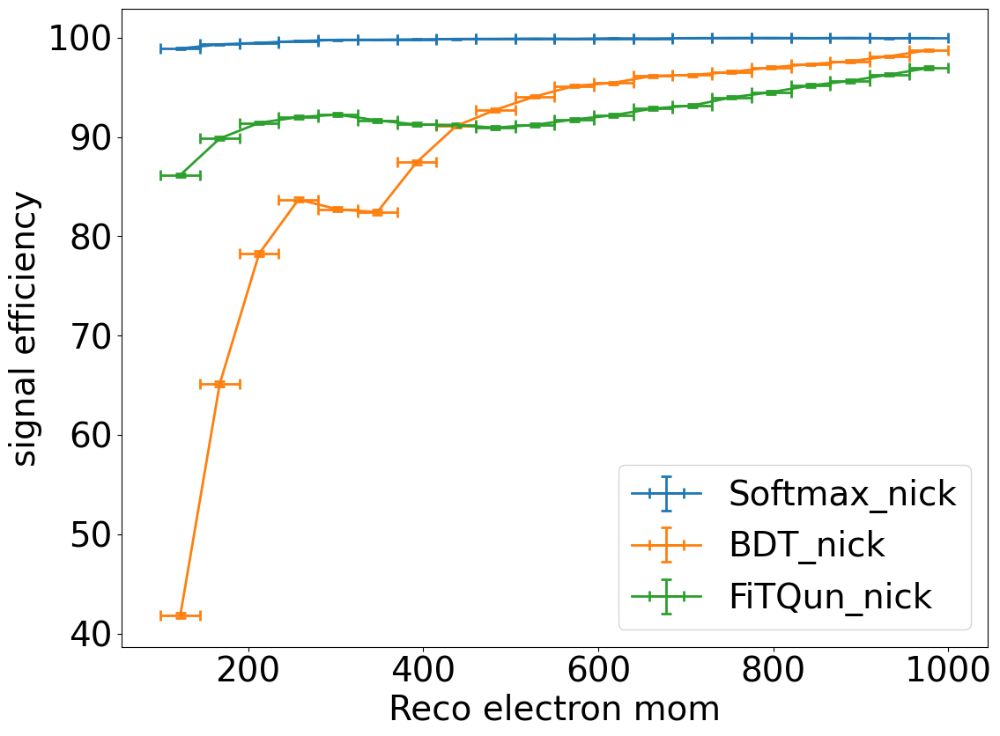

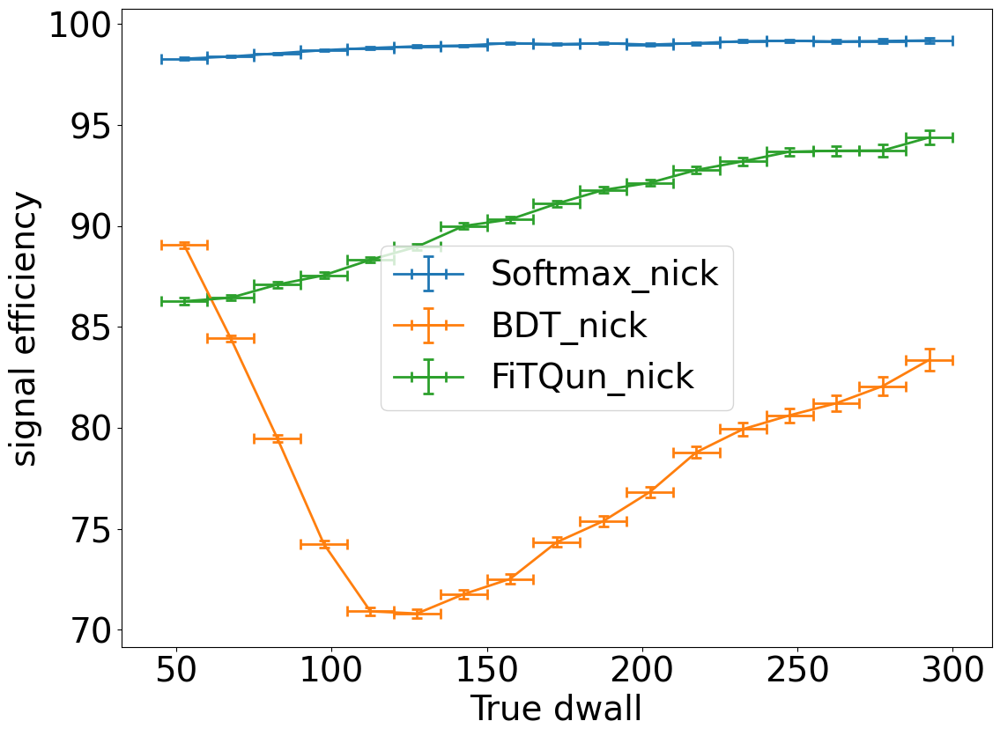

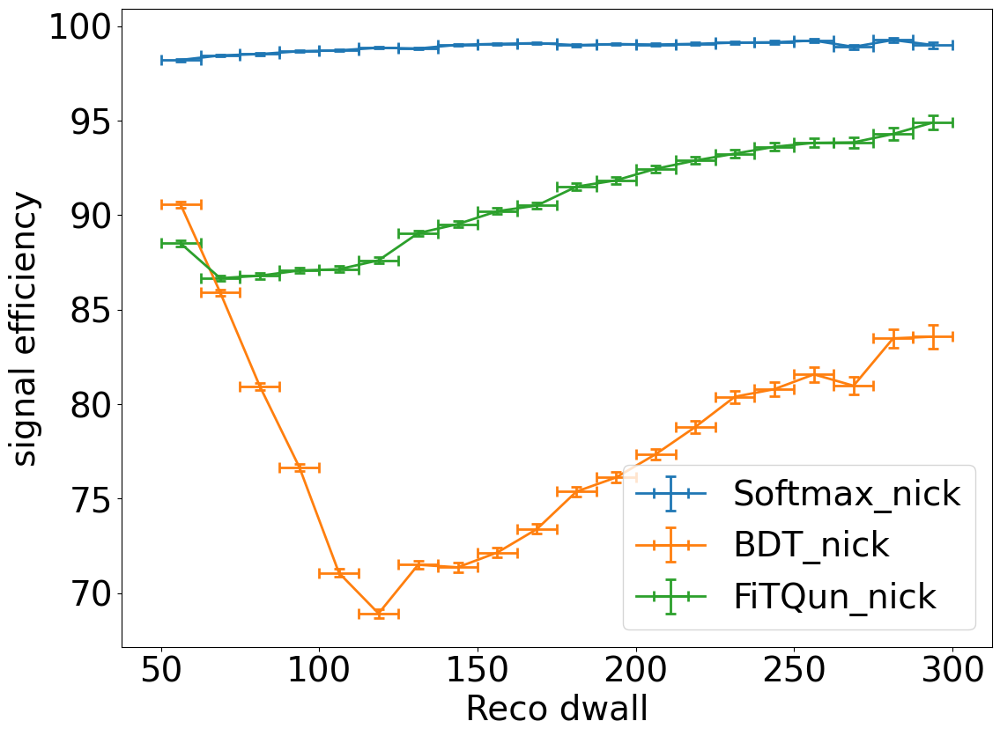

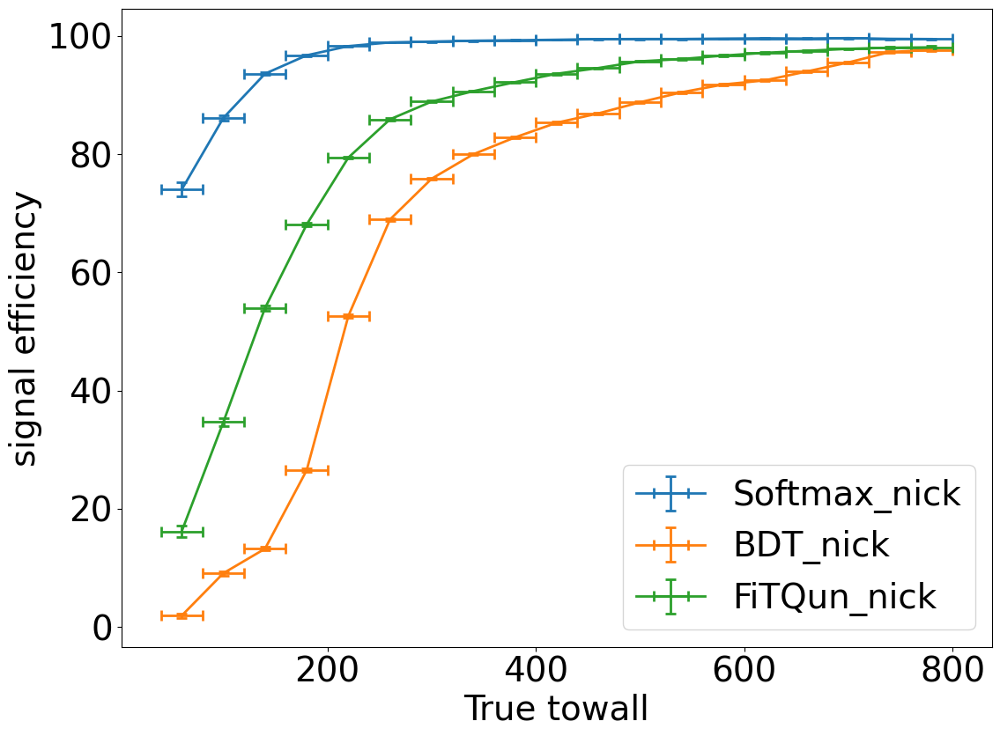

...

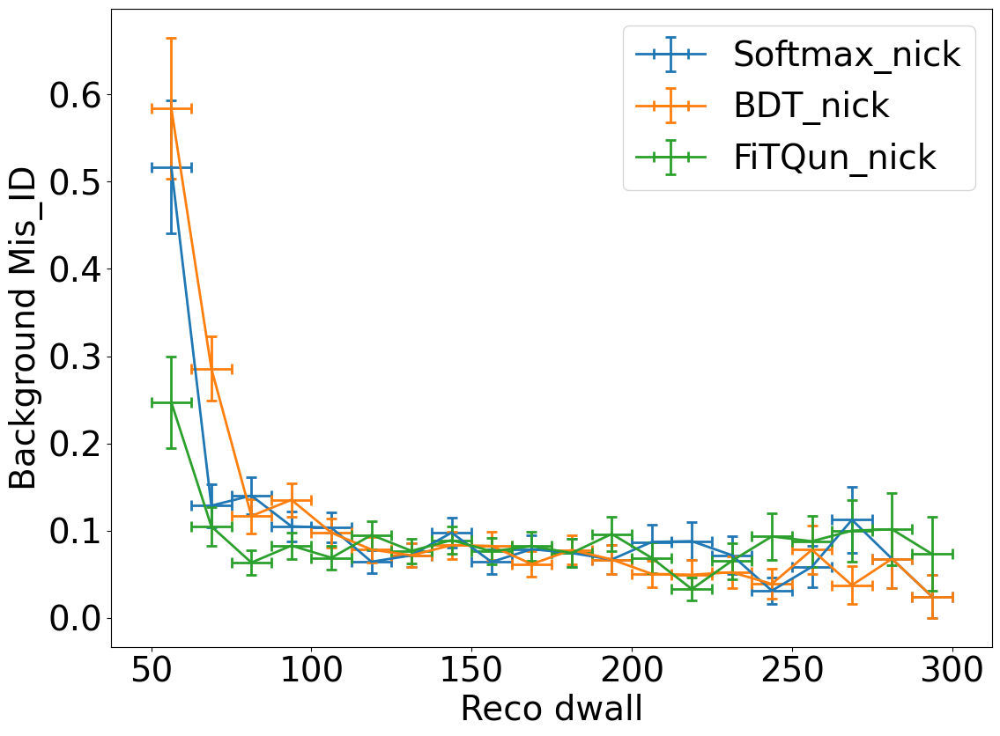

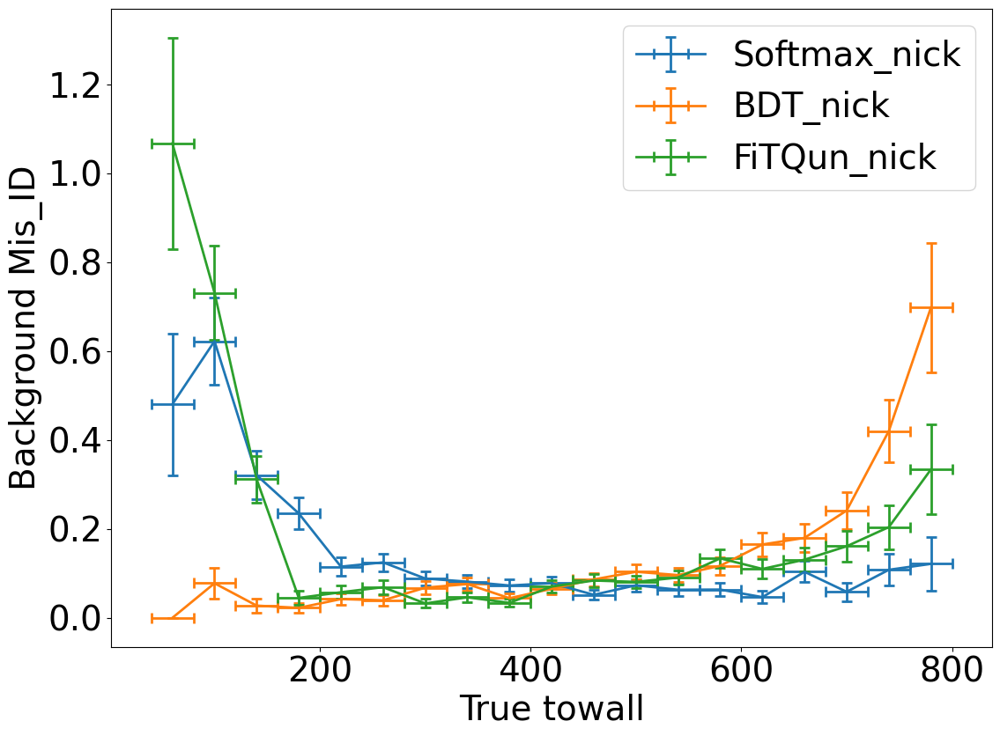

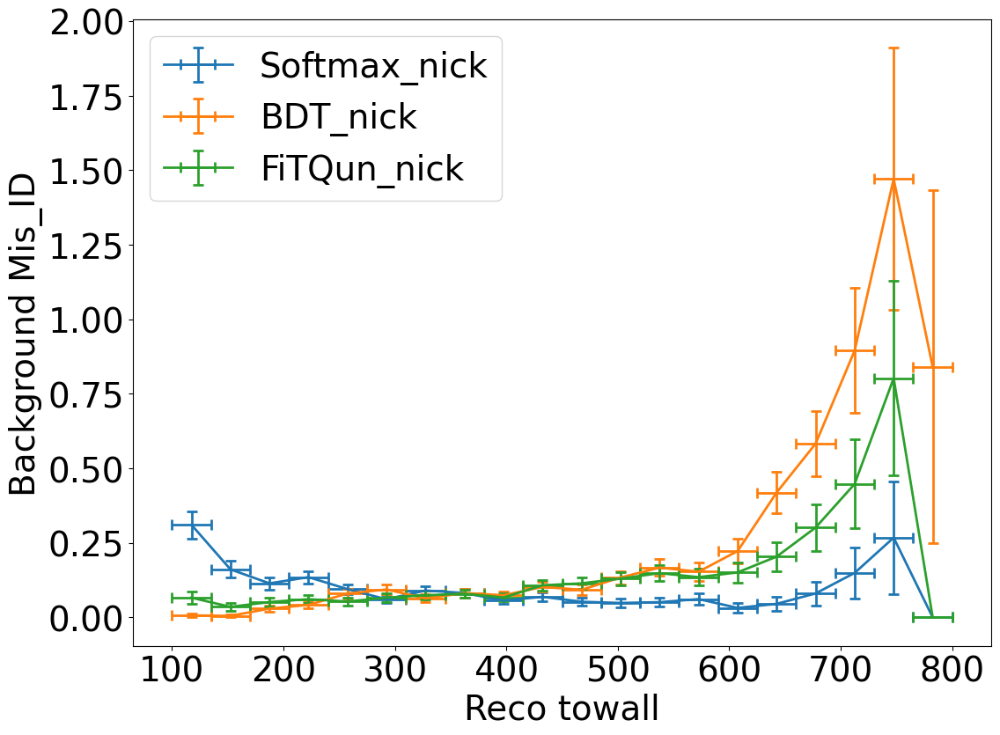

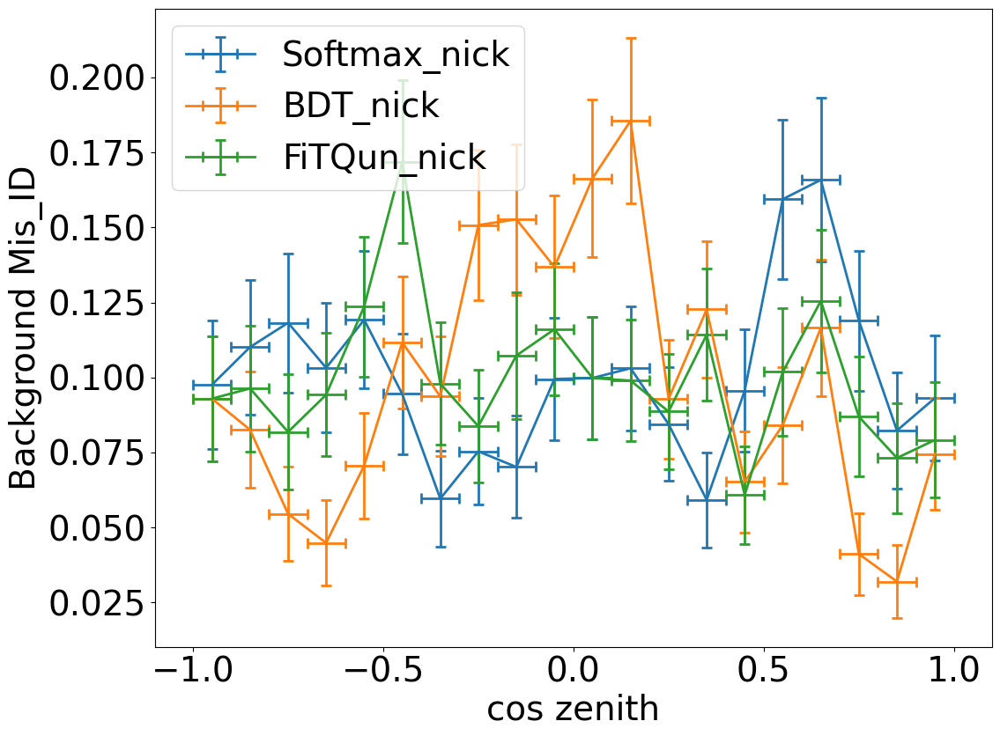

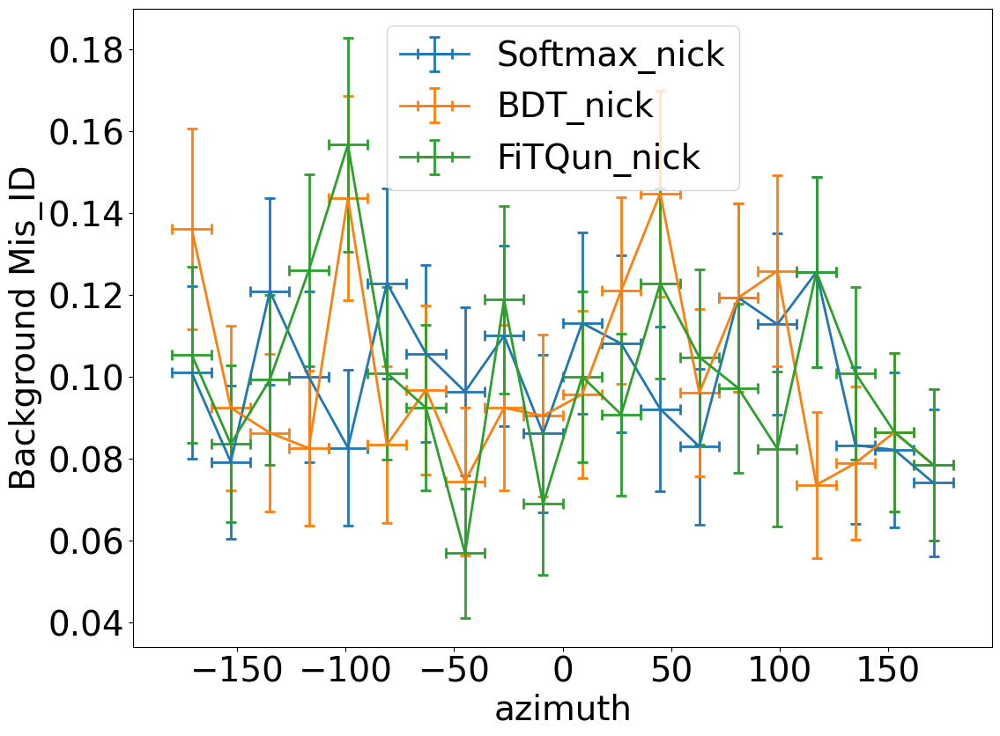

In [35]:
plot.efficiency_profile(df_nick, 1, mom_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='True mom', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, reco_mom_e_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='Reco electron mom', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, dwall_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='True dwall', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, reco_dwall_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='Reco dwall', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, towall_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='True towall', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, reco_towall_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='Reco towall', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, cos_zenith_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='cos zenith', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, azimuth_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='azimuth', y_label='signal efficiency')

plot.efficiency_profile(df_nick, 2, mom_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='True mom', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, reco_mom_e_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='Reco electron mom', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, dwall_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='True dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, reco_dwall_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='Reco dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, towall_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='True towall', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, reco_towall_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='Reco towall', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, cos_zenith_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='cos zenith', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, azimuth_binning_nick, algorithms_nick, cut_array=fixed_rejection_cuts_nick, x_label='azimuth', y_label='Background Mis_ID')

(<Figure size 1200x900 with 1 Axes>,
 <AxesSubplot: xlabel='azimuth', ylabel='Background Mis_ID'>)

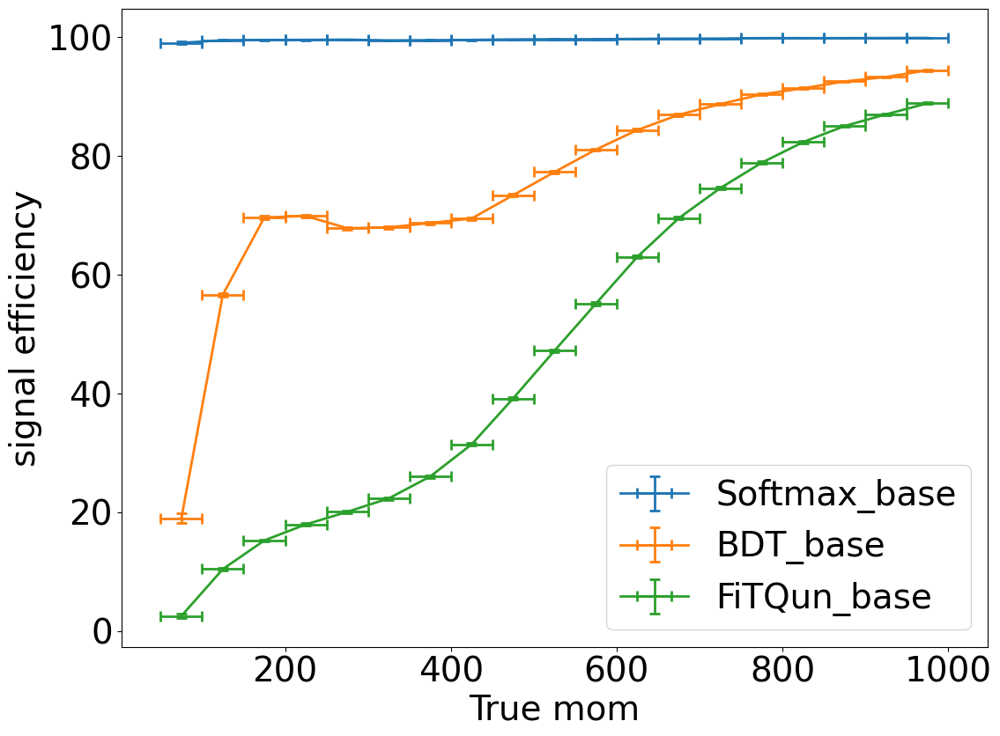

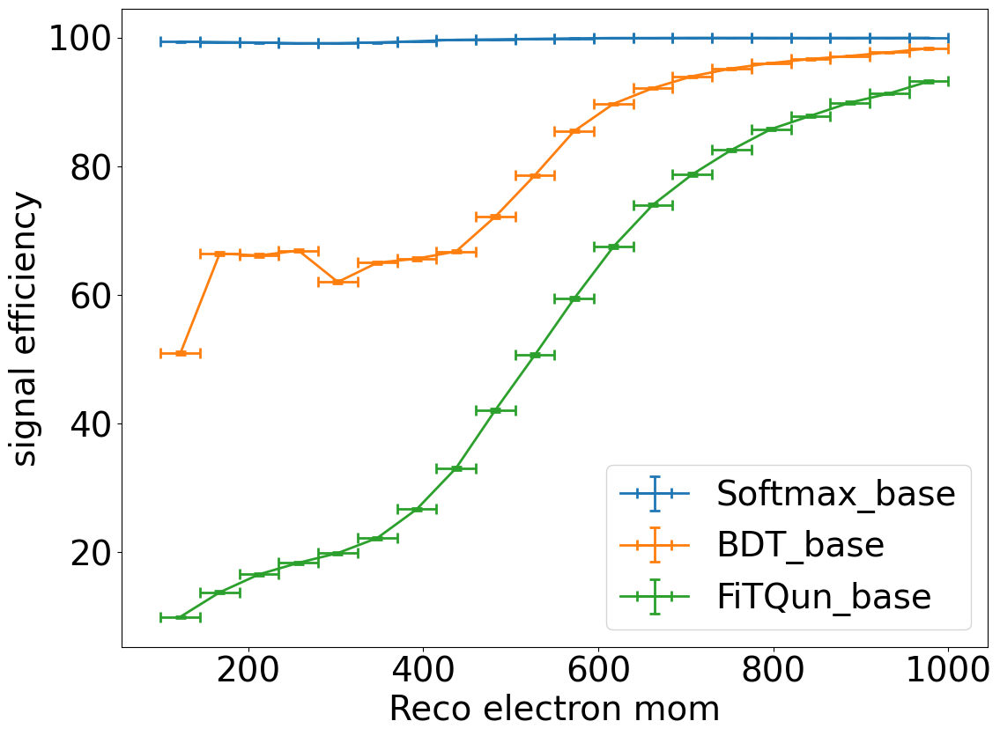

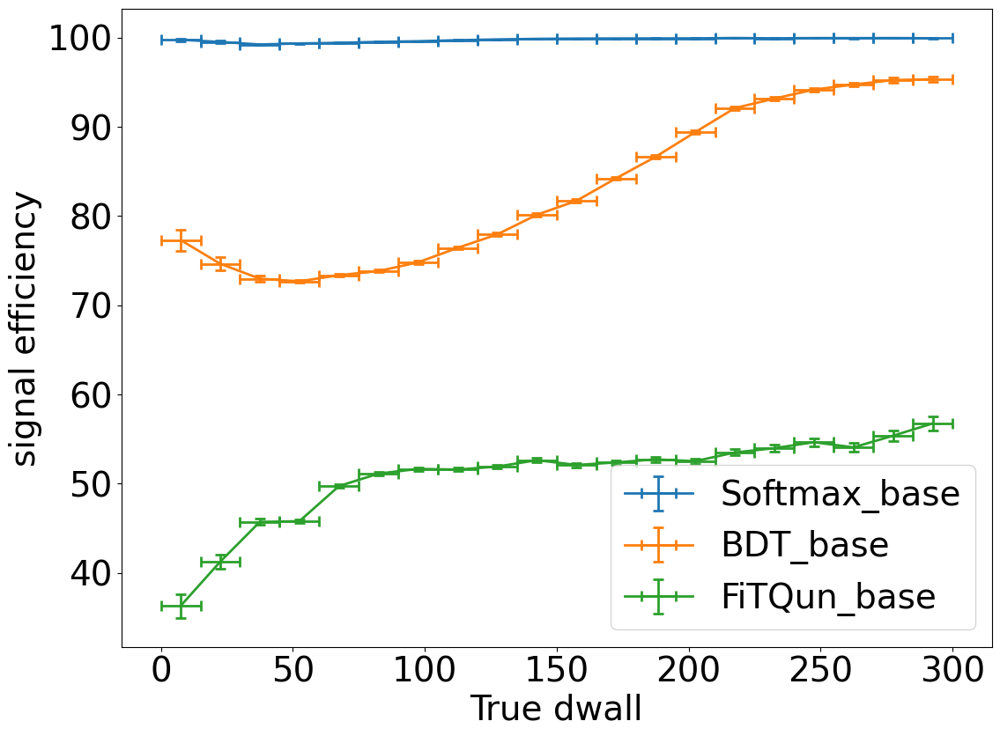

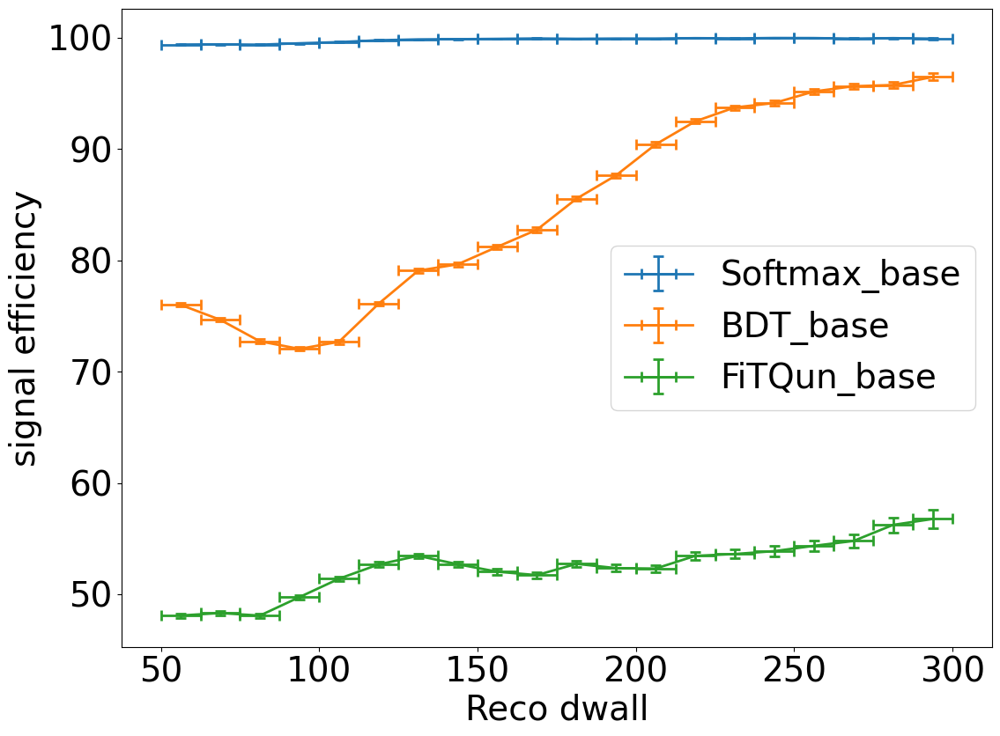

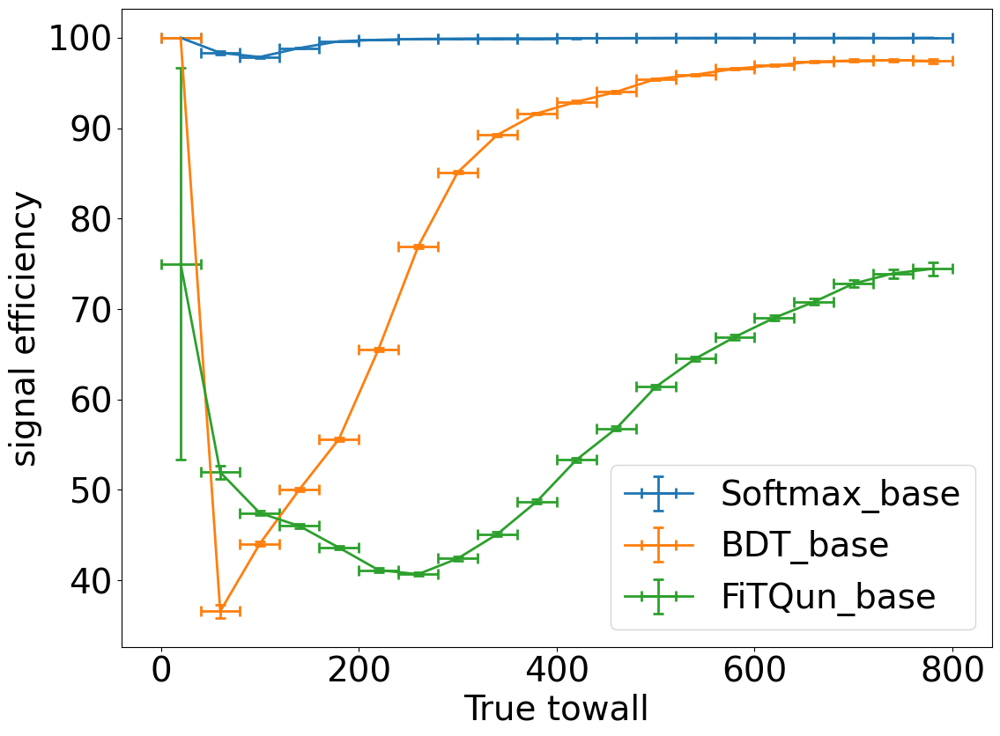

...

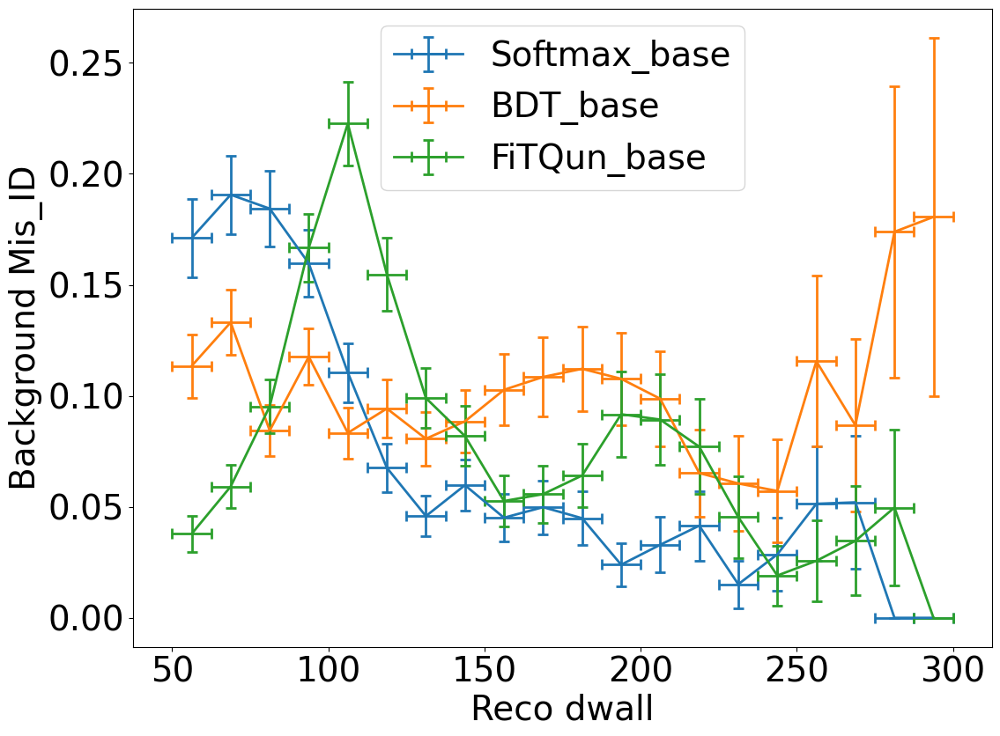

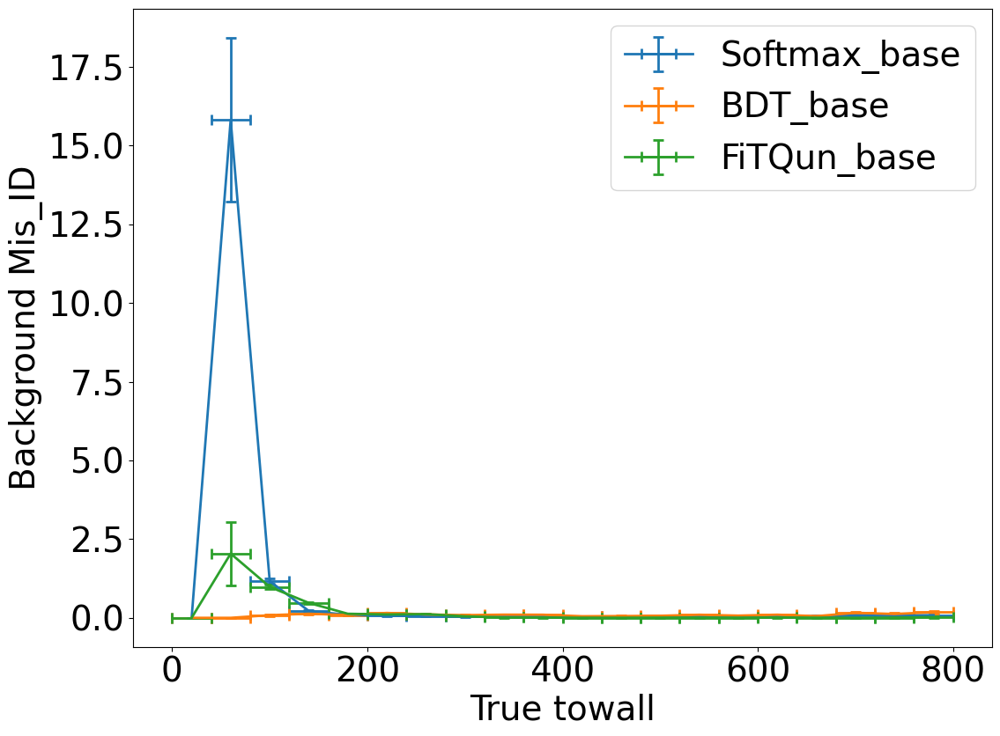

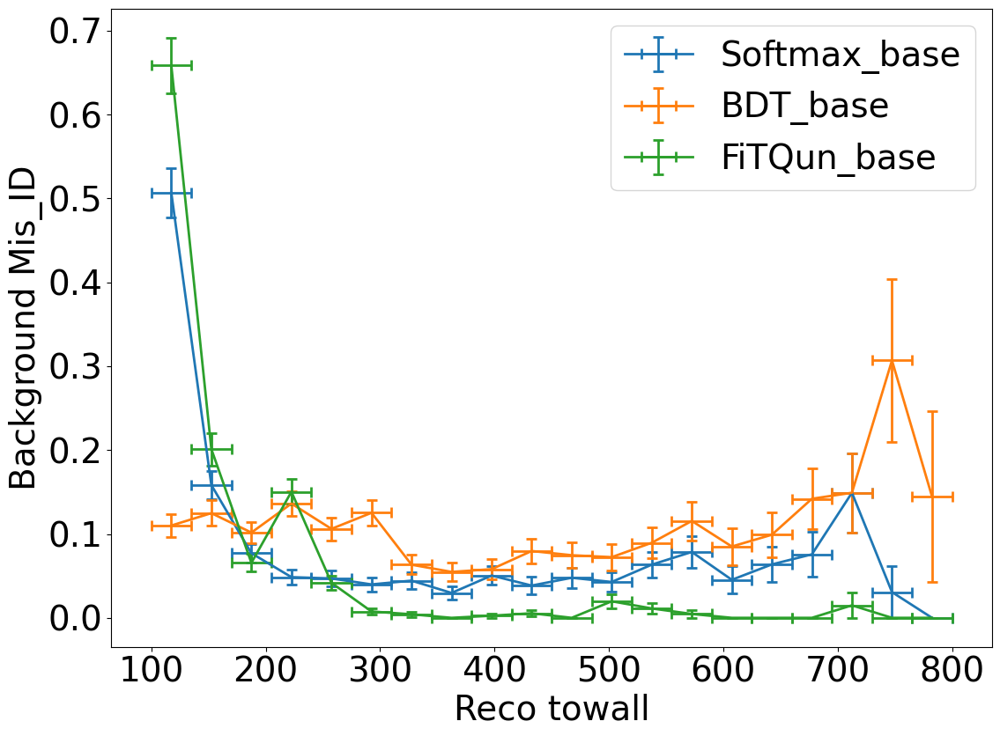

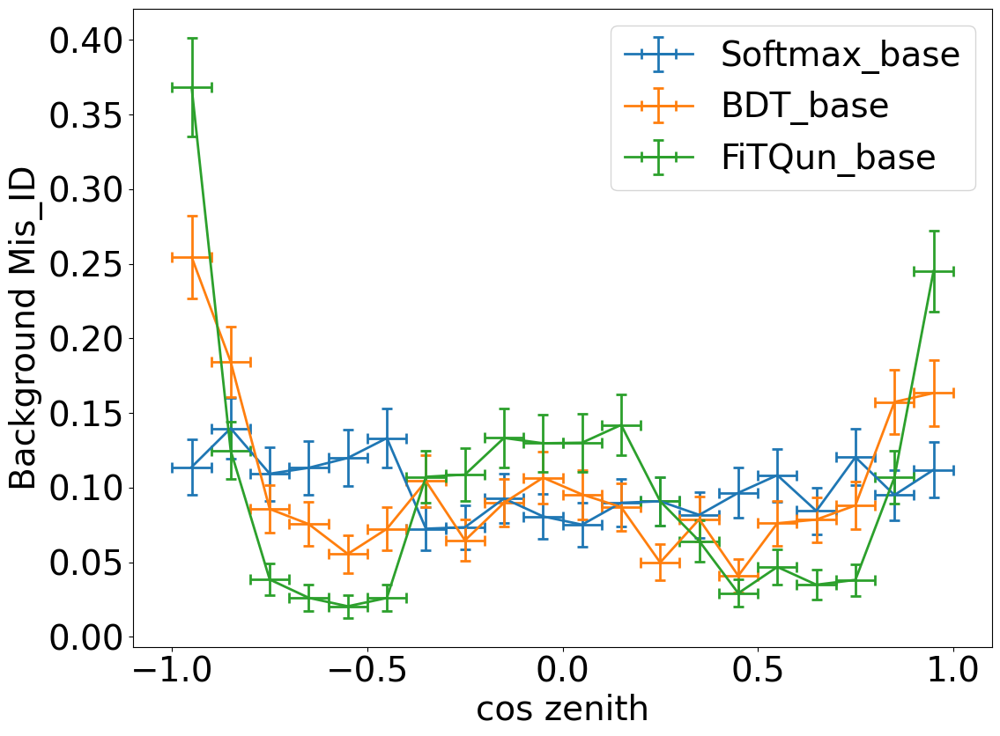

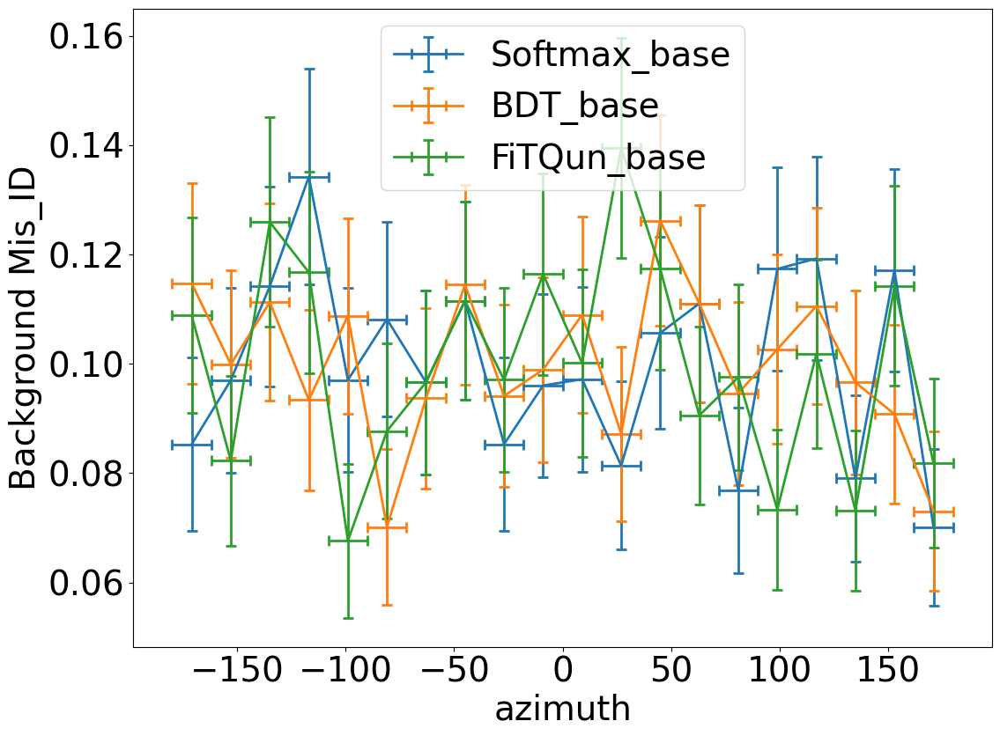

In [36]:
# Plotting efficiency profile using muon_rejection of 0.99, after applying preselection
plot.efficiency_profile(df_base, 1, mom_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='True mom', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, reco_mom_e_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='Reco electron mom', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, dwall_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='True dwall', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, reco_dwall_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='Reco dwall', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, towall_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='True towall', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, reco_towall_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='Reco towall', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, cos_zenith_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='cos zenith', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, azimuth_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='azimuth', y_label='signal efficiency')

plot.efficiency_profile(df_base, 2, mom_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='True mom', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, reco_mom_e_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='Reco electron mom', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, dwall_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='True dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, reco_dwall_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='Reco dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, towall_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='True towall', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, reco_towall_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='Reco towall', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, cos_zenith_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='cos zenith', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, azimuth_binning_base, algorithms_base, cut_array=fixed_rejection_cuts_base, x_label='azimuth', y_label='Background Mis_ID')

In [37]:
# Getting the signal efficiency and background rejection for all different fixed rejection cuts before and after applying preselection

sig_eff = classification_metrics.sg_eff(df['true_sig'], fixed_rejection_cuts)
bg_rej = classification_metrics.bg_rej(df['true_sig'], fixed_rejection_cuts)

for i in range(len(sig_eff)):
    print(f'The signal efficiency  and background rejection for {algorithms[i]} cuts is : {round(sig_eff[i], 3)}, {round(bg_rej[i], 3)}')
    
print('\n')

sig_eff_base = classification_metrics.sg_eff(df_base['true_sig'], fixed_rejection_cuts_base)
bg_rej_base = classification_metrics.bg_rej(df_base['true_sig'], fixed_rejection_cuts_base)

for i in range(len(sig_eff_base)):
    print(f'The signal efficiency  and background rejection for {algorithms_base[i]} cuts is : {round(sig_eff_base[i], 3)}, {round(bg_rej_base[i], 3)}')
    
print('\n')

sig_eff_nick = classification_metrics.sg_eff(df_nick['true_sig'], fixed_rejection_cuts_nick)
bg_rej_nick = classification_metrics.bg_rej(df_nick['true_sig'], fixed_rejection_cuts_nick)

for i in range(len(sig_eff_nick)):
    print(f'The signal efficiency  and background rejection for {algorithms_nick[i]} cuts is : {round(sig_eff_nick[i], 3)}, {round(bg_rej_nick[i], 3)}')

The signal efficiency  and background rejection for Softmax cuts is : 0.886, 0.999
The signal efficiency  and background rejection for BDT cuts is : 0.48, 0.999
The signal efficiency  and background rejection for FiTQun cuts is : 0.309, 0.999


The signal efficiency  and background rejection for Softmax_base cuts is : 0.997, 0.999
The signal efficiency  and background rejection for BDT_base cuts is : 0.791, 0.999
The signal efficiency  and background rejection for FiTQun_base cuts is : 0.511, 0.999


The signal efficiency  and background rejection for Softmax_nick cuts is : 0.988, 0.999
The signal efficiency  and background rejection for BDT_nick cuts is : 0.77, 0.999
The signal efficiency  and background rejection for FiTQun_nick cuts is : 0.893, 0.999


In [38]:
# Using binned background rejection over reco mom and plotting the efficiency profile over different varibales:

muon_rejection = 0.99
binned_rejection_cuts, binned_rejection_thresholds = classification_metrics.cut_with_constant_binned_rejection(df, probs, 2, muon_rejection, reco_mom_e_binning)
binned_rejection_cuts_base, binned_rejection_thresholds_base = classification_metrics.cut_with_constant_binned_rejection(df_base, probs_base, 2, muon_rejection, reco_mom_e_binning_base)
binned_rejection_cuts_nick, binned_rejection_thresholds_nick = classification_metrics.cut_with_constant_binned_rejection(df_nick, probs_nick, 2, muon_rejection, reco_mom_e_binning_nick)

(<Figure size 1200x900 with 1 Axes>,
 <AxesSubplot: xlabel='azimuth', ylabel='Background Mis_ID'>)

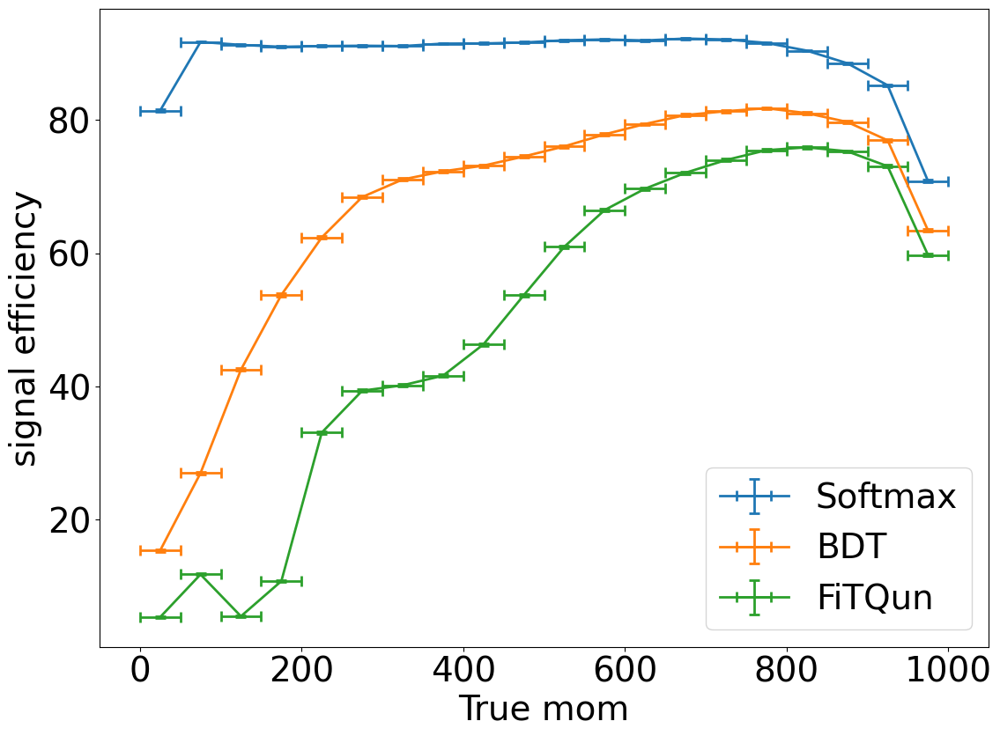

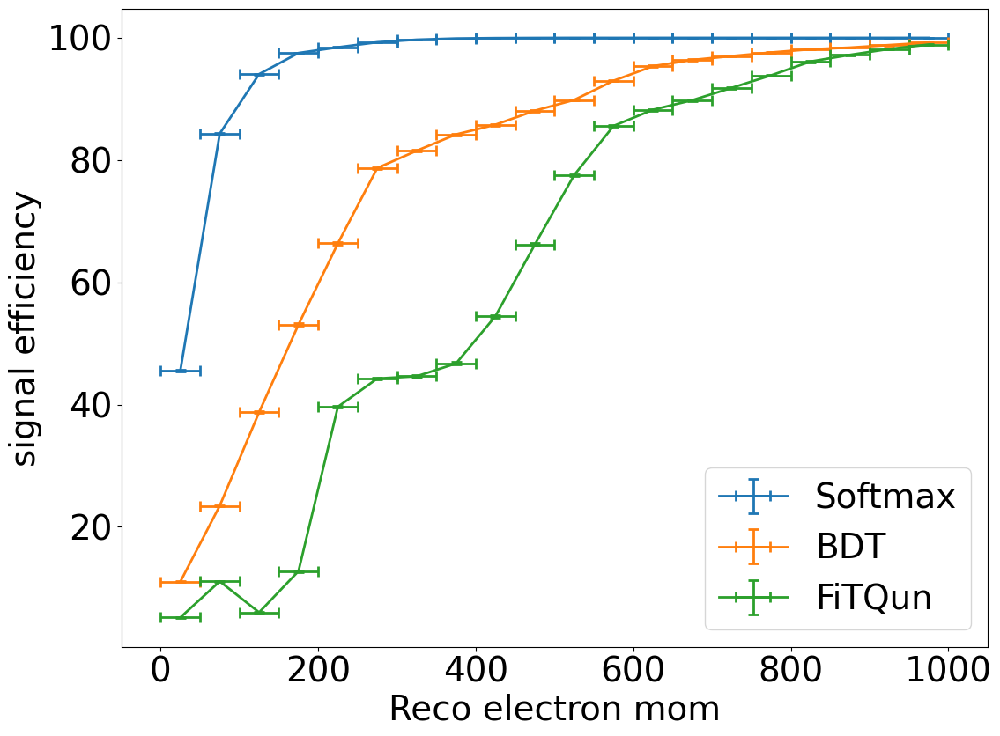

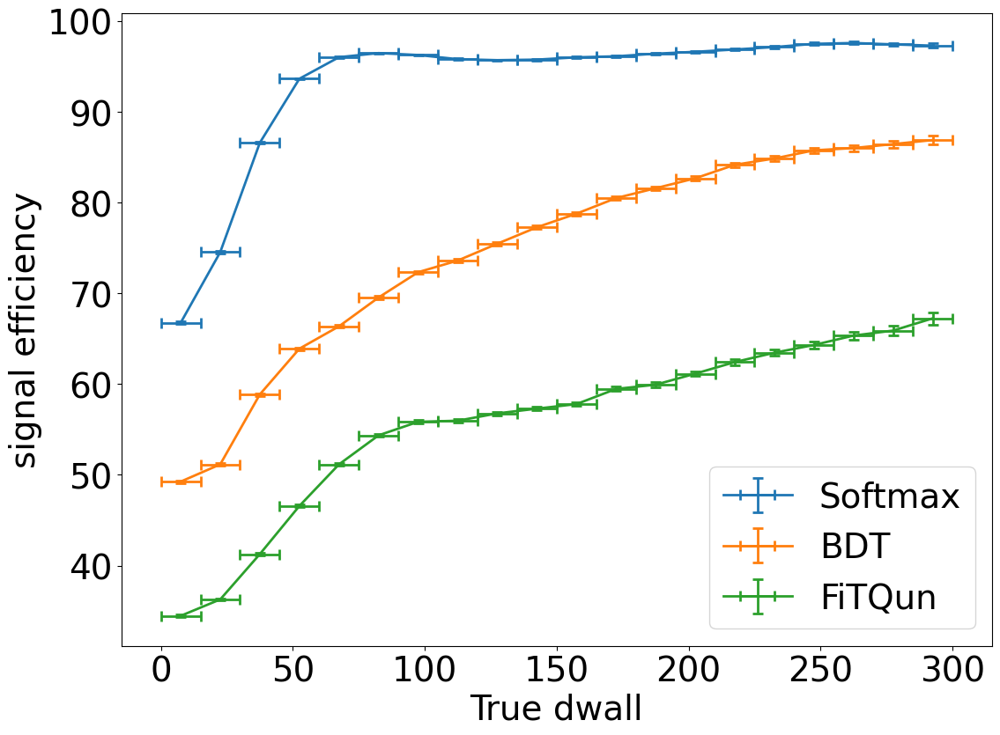

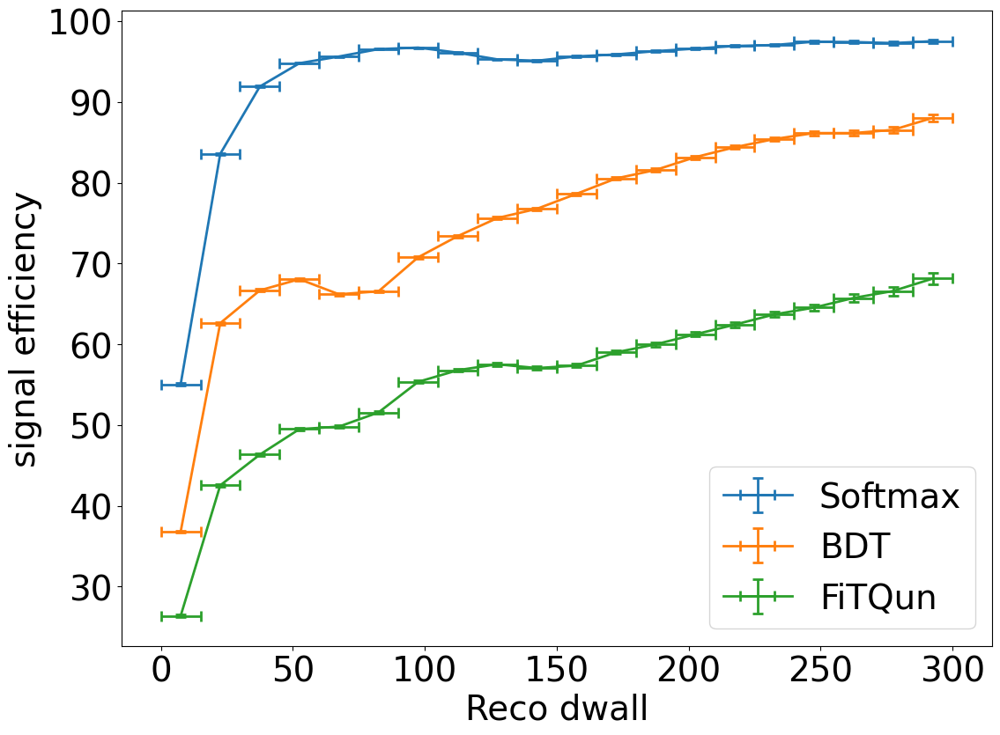

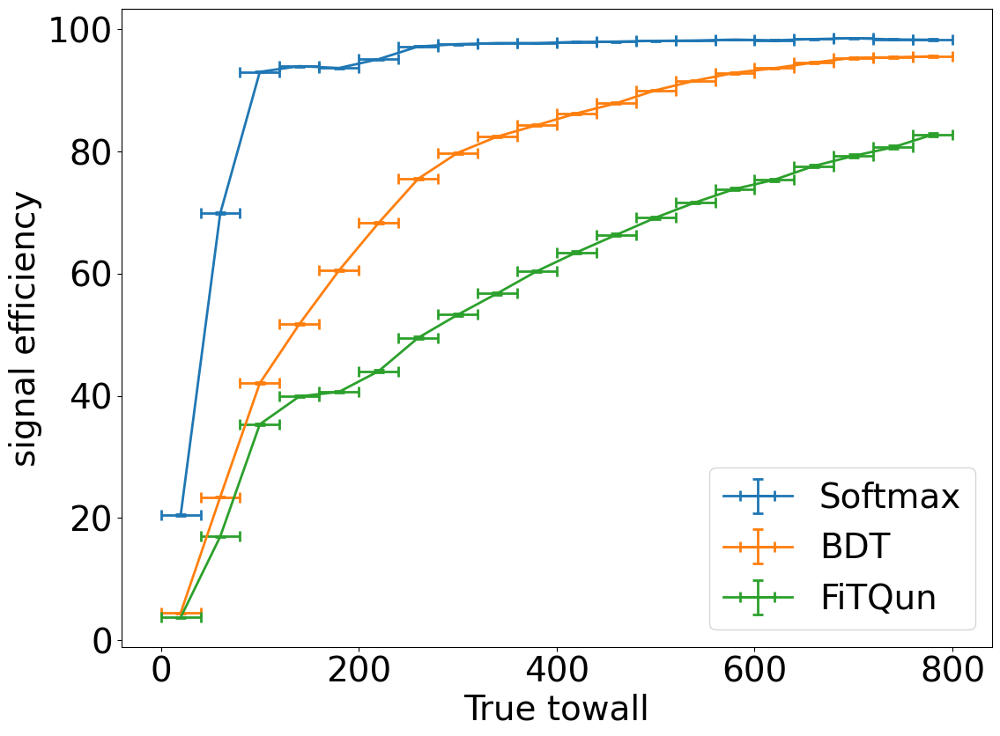

...

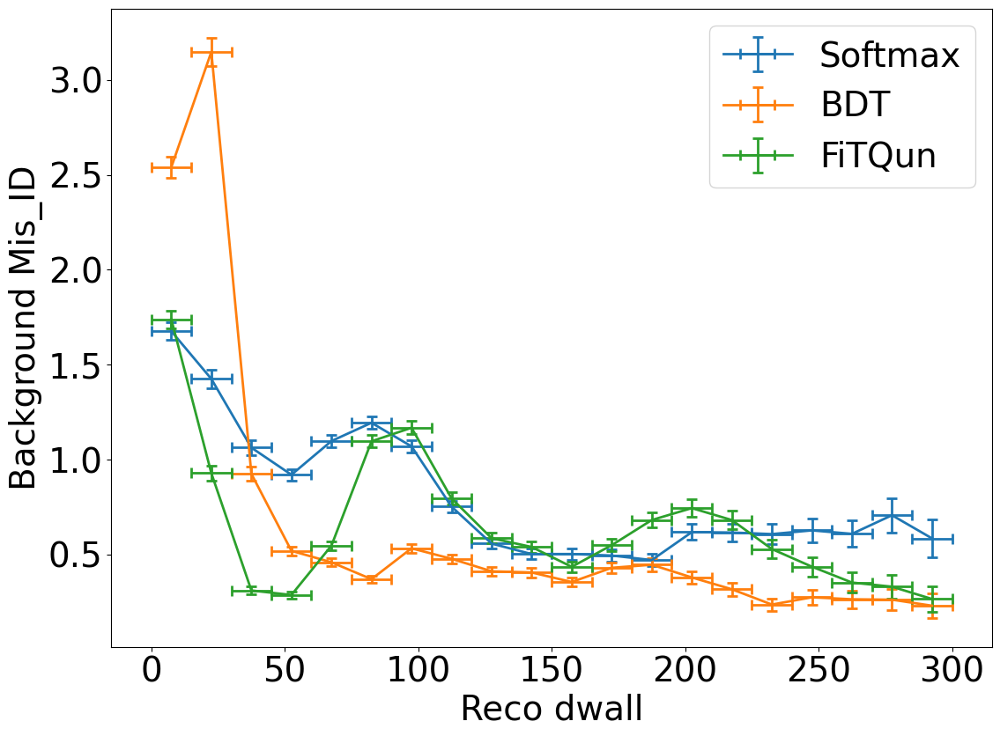

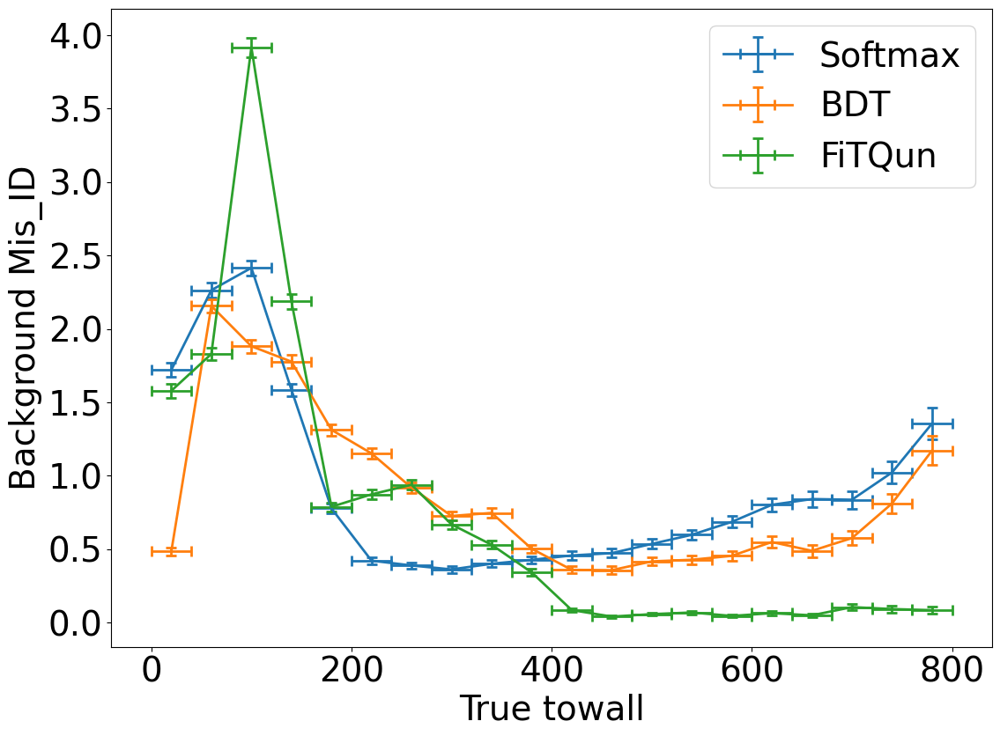

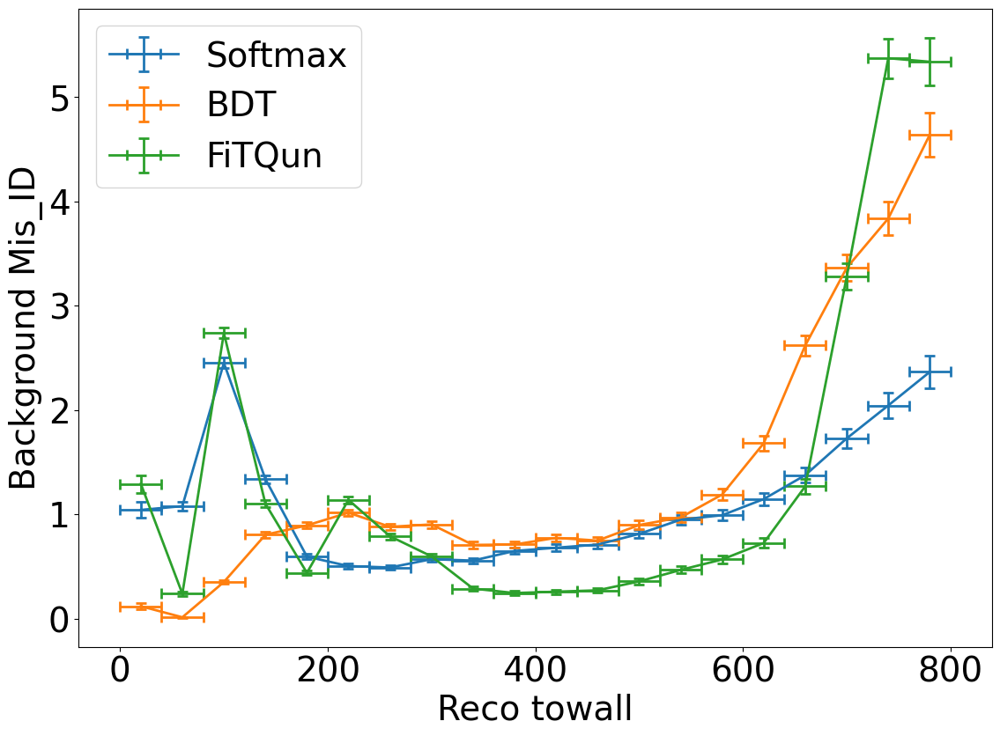

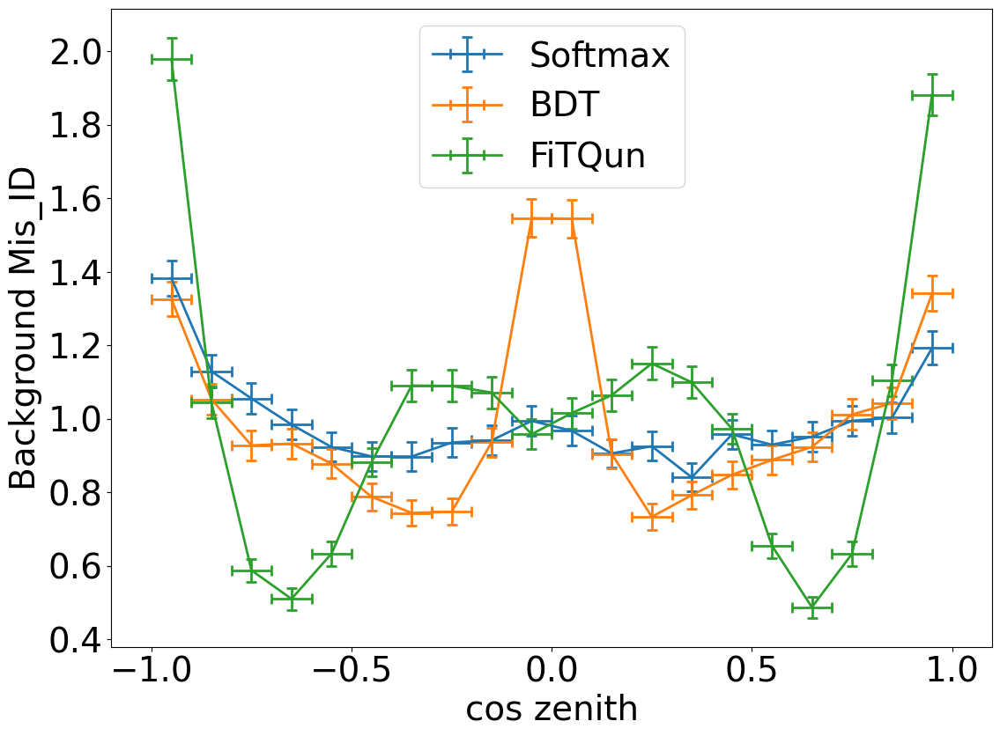

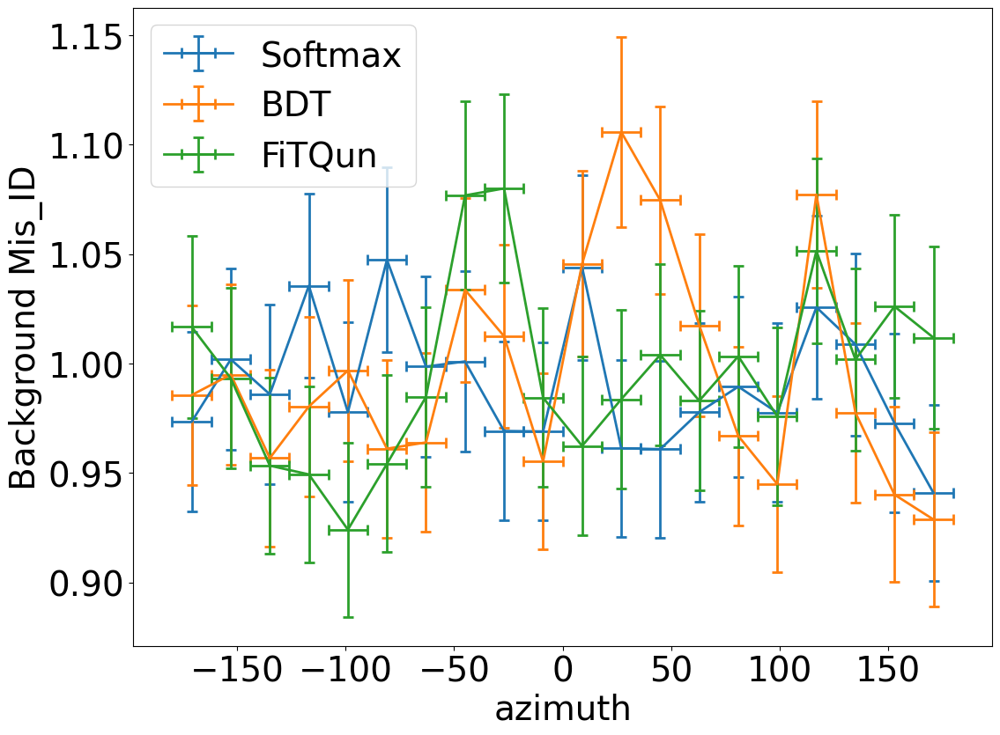

In [39]:
# Plotting efficiency profile using binned muon rejection of 0.99 over reco mom, before applying preselection using cuts

plot.efficiency_profile(df, 1, mom_binning, algorithms, cut_array=binned_rejection_cuts, x_label='True mom', y_label='signal efficiency')
plot.efficiency_profile(df, 1, reco_mom_e_binning, algorithms, cut_array=binned_rejection_cuts, x_label='Reco electron mom', y_label='signal efficiency')
plot.efficiency_profile(df, 1, dwall_binning, algorithms, cut_array=binned_rejection_cuts, x_label='True dwall', y_label='signal efficiency')
plot.efficiency_profile(df, 1, reco_dwall_binning, algorithms, cut_array=binned_rejection_cuts, x_label='Reco dwall', y_label='signal efficiency')
plot.efficiency_profile(df, 1, towall_binning, algorithms, cut_array=binned_rejection_cuts, x_label='True towall', y_label='signal efficiency')
plot.efficiency_profile(df, 1, reco_towall_binning, algorithms, cut_array=binned_rejection_cuts, x_label='Reco towall', y_label='signal efficiency')
plot.efficiency_profile(df, 1, cos_zenith_binning, algorithms, cut_array=binned_rejection_cuts, x_label='cos zenith', y_label='signal efficiency')
plot.efficiency_profile(df, 1, azimuth_binning, algorithms, cut_array=binned_rejection_cuts, x_label='azimuth', y_label='signal efficiency')

plot.efficiency_profile(df, 2, mom_binning, algorithms, cut_array=binned_rejection_cuts, x_label='True mom', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, reco_mom_e_binning, algorithms, cut_array=binned_rejection_cuts, x_label='Reco electron mom', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, dwall_binning, algorithms, cut_array=binned_rejection_cuts, x_label='True dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, reco_dwall_binning, algorithms, cut_array=binned_rejection_cuts, x_label='Reco dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, towall_binning, algorithms, cut_array=binned_rejection_cuts, x_label='True towall', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, reco_towall_binning, algorithms, cut_array=binned_rejection_cuts, x_label='Reco towall', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, cos_zenith_binning, algorithms, cut_array=binned_rejection_cuts, x_label='cos zenith', y_label='Background Mis_ID')
plot.efficiency_profile(df, 2, azimuth_binning, algorithms, cut_array=binned_rejection_cuts, x_label='azimuth', y_label='Background Mis_ID')

(<Figure size 1200x900 with 1 Axes>,
 <AxesSubplot: xlabel='azimuth', ylabel='Background Mis_ID'>)

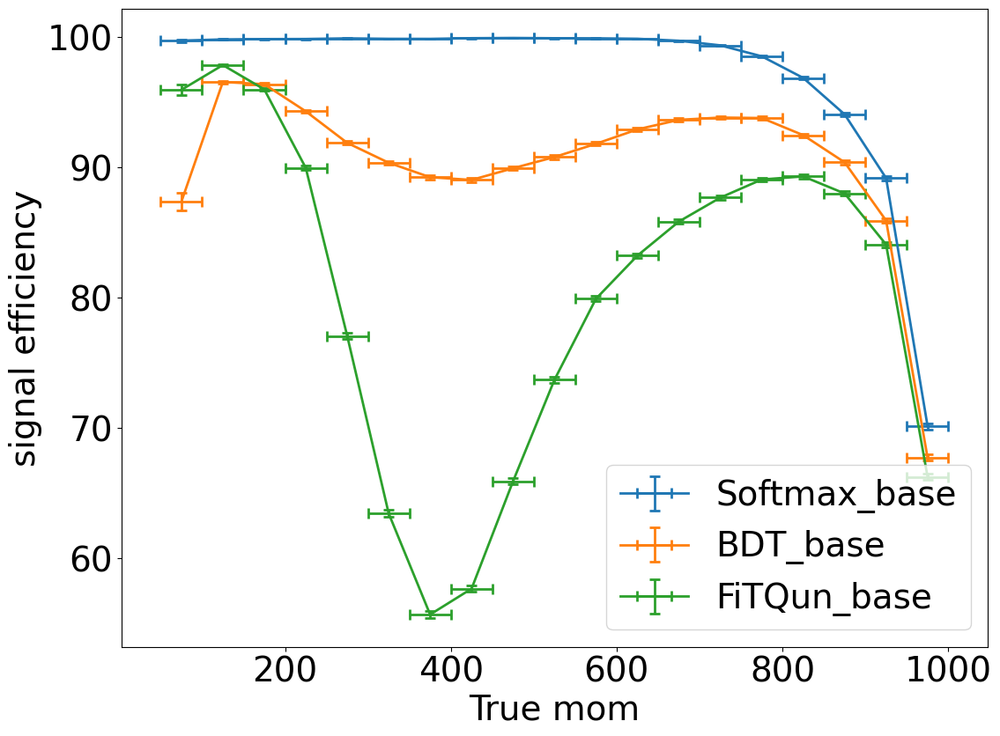

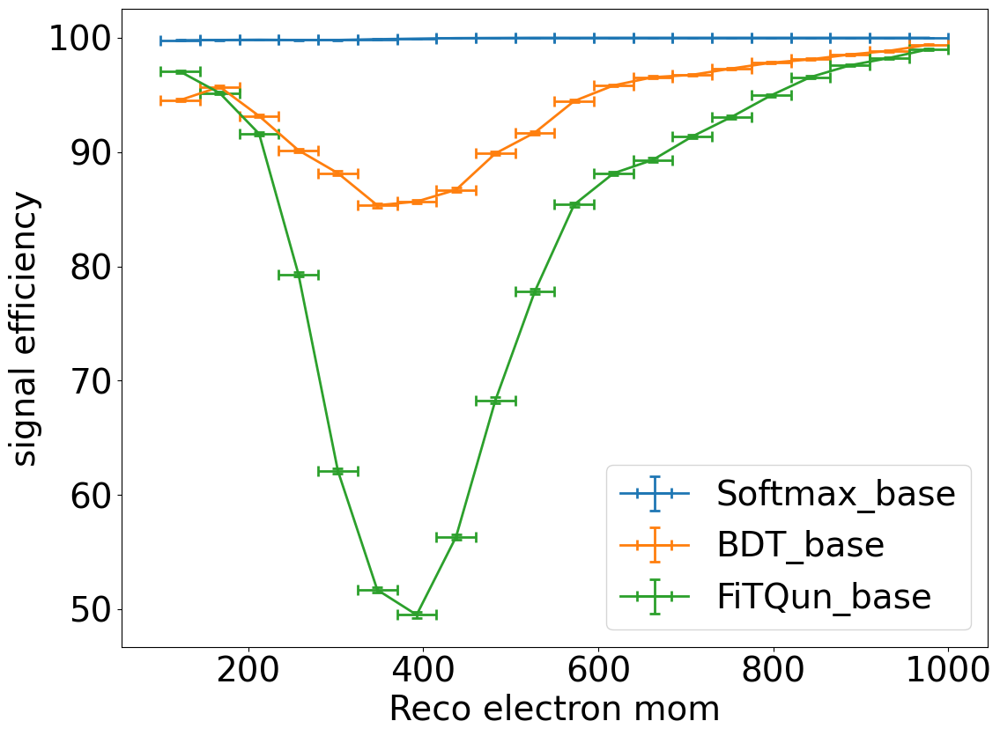

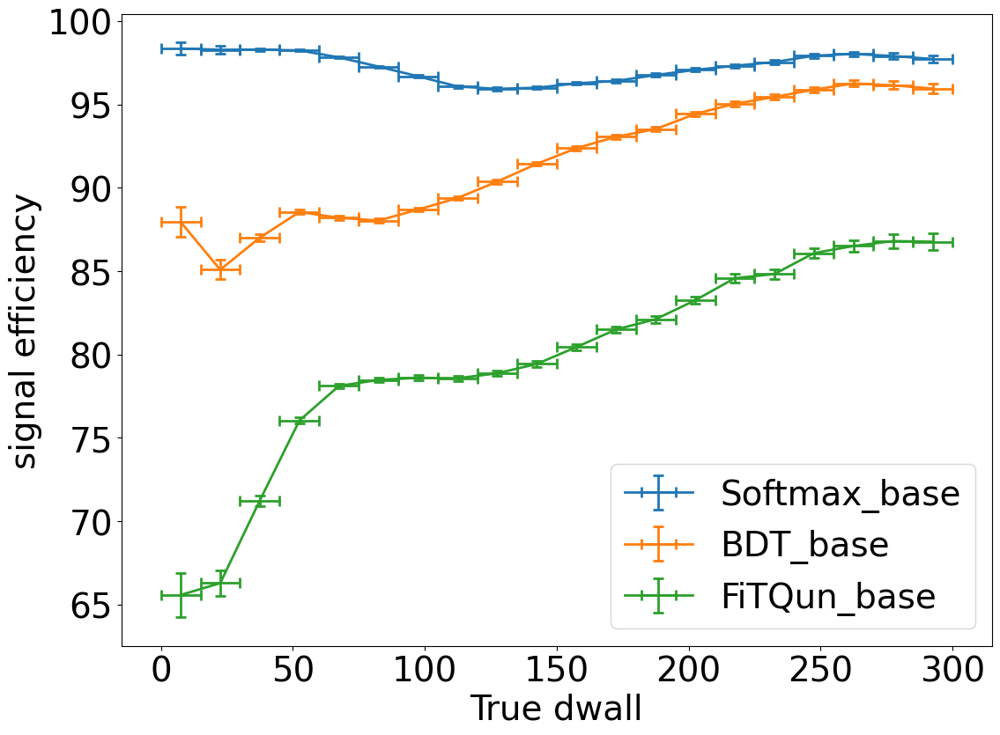

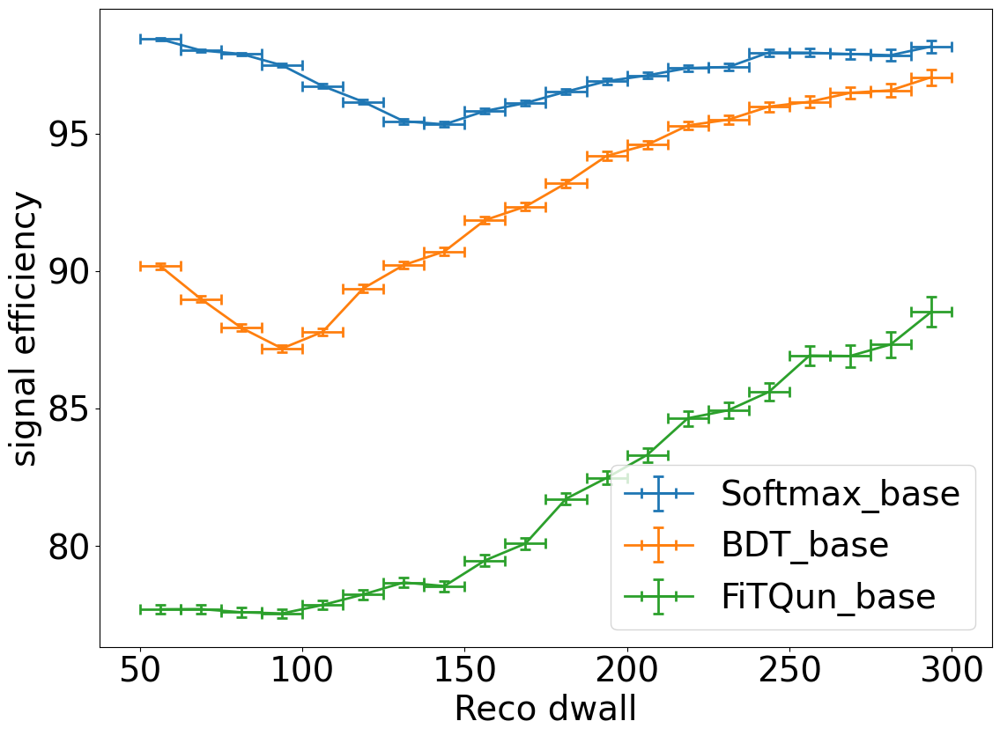

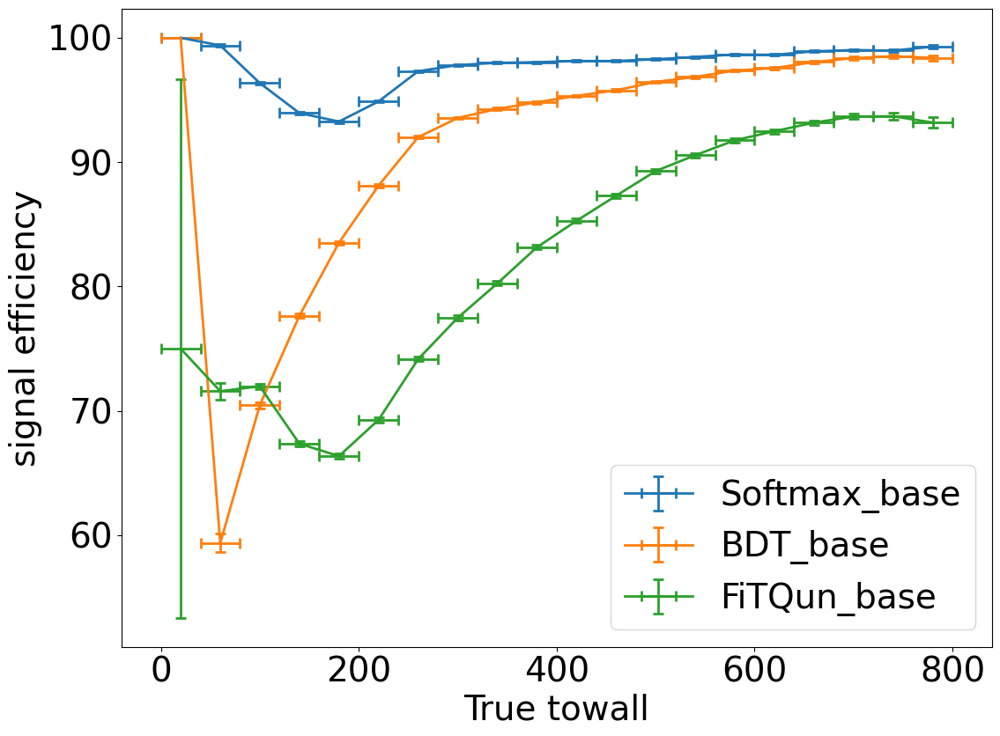

...

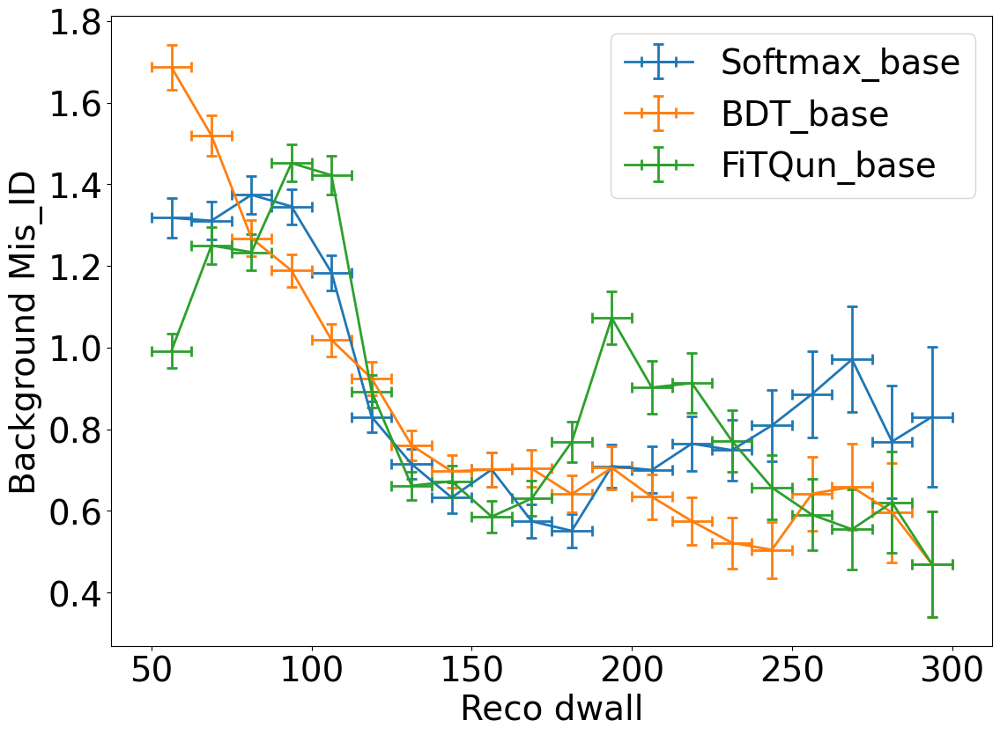

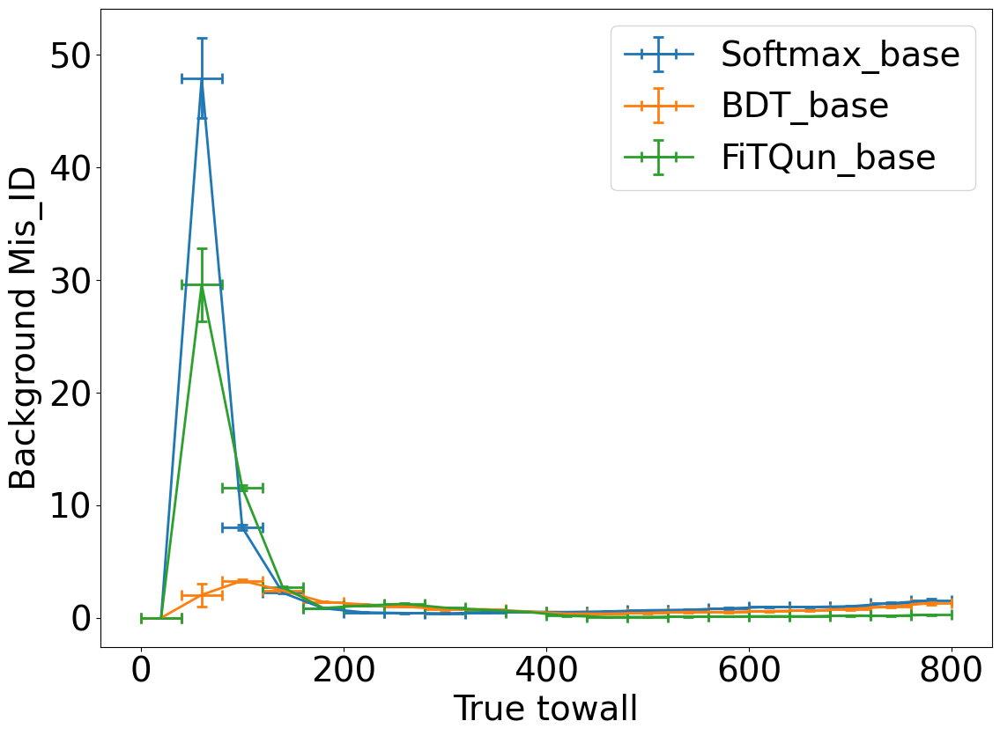

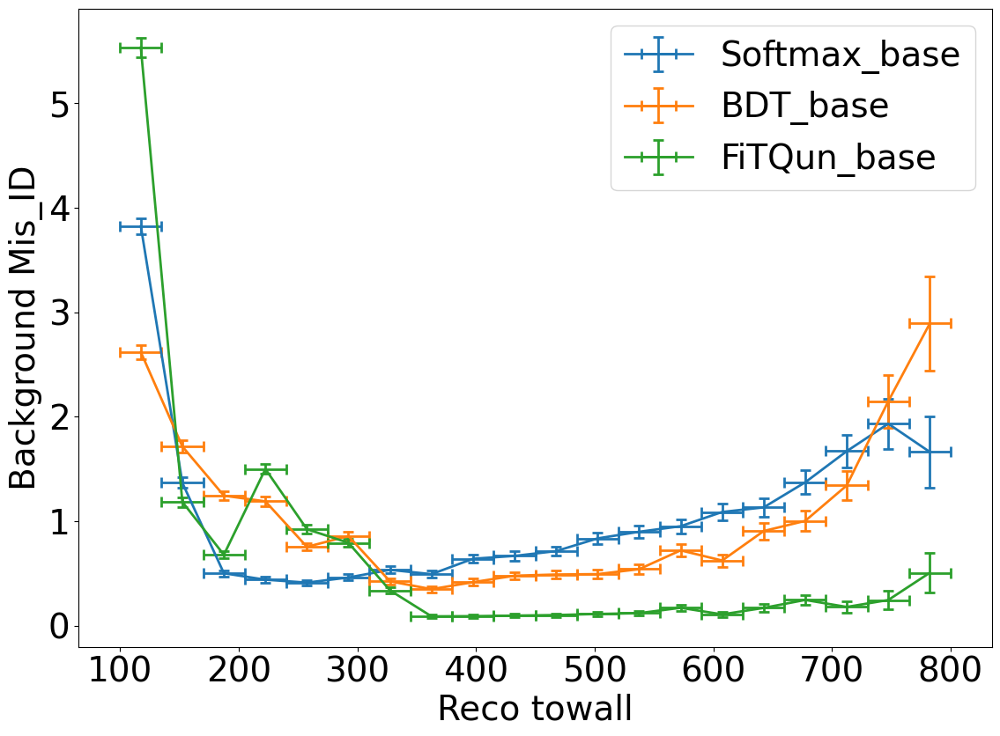

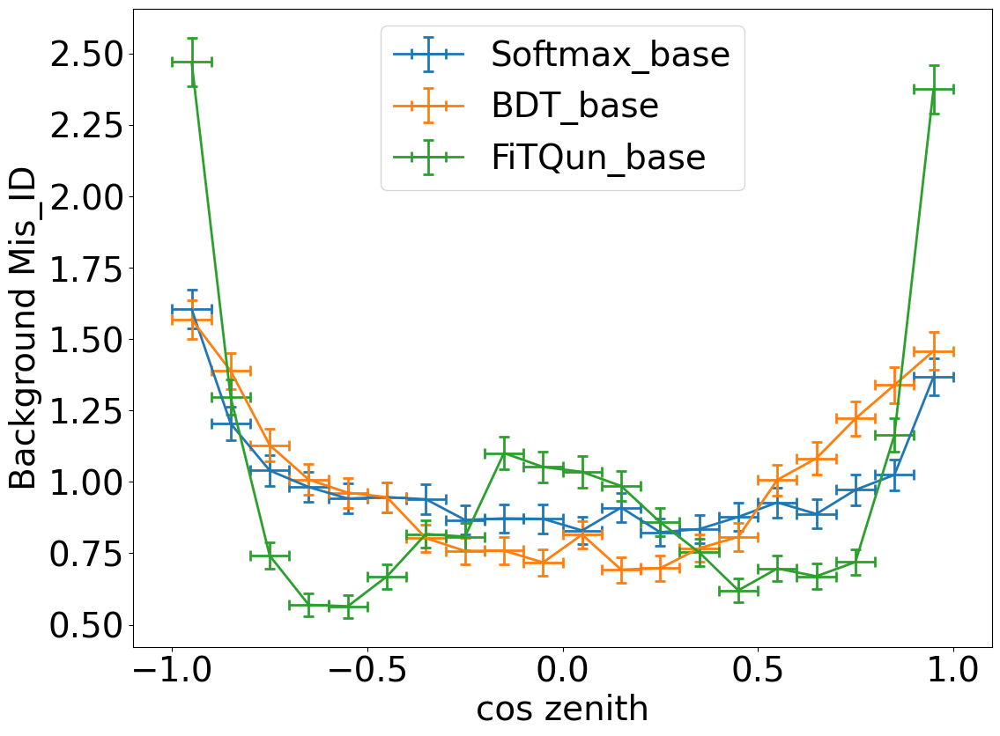

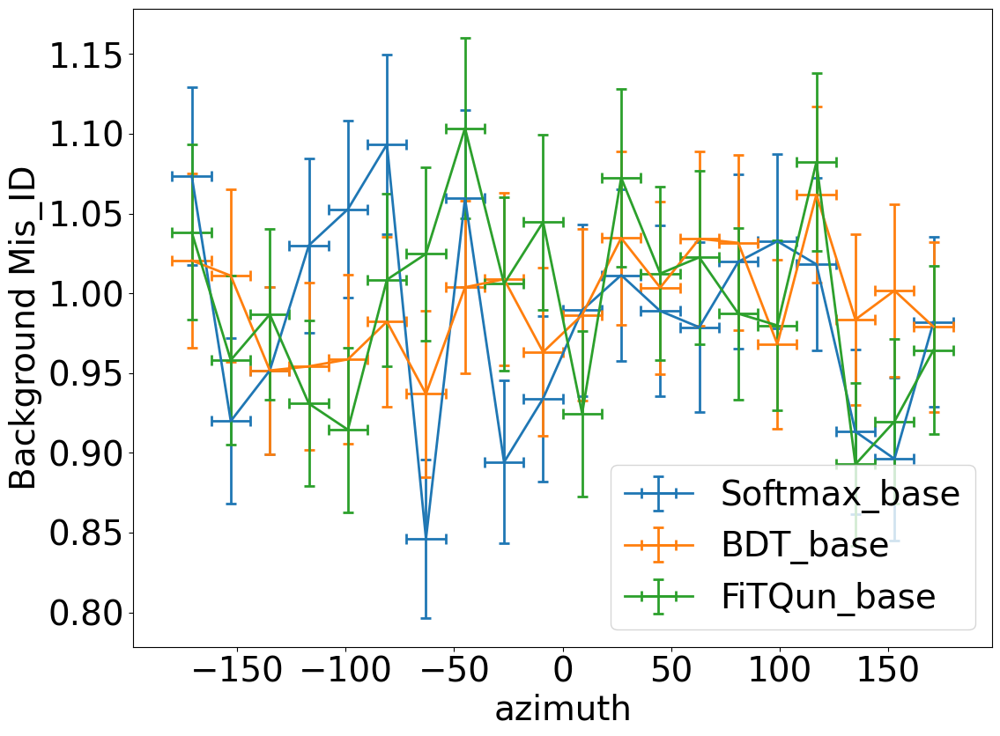

In [40]:
# Plotting efficiency profile using binned muon rejection of 0.99 over reco mom, after applying preselection using cuts

plot.efficiency_profile(df_base, 1, mom_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='True mom', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, reco_mom_e_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='Reco electron mom', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, dwall_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='True dwall', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, reco_dwall_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='Reco dwall', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, towall_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='True towall', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, reco_towall_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='Reco towall', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, cos_zenith_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='cos zenith', y_label='signal efficiency')
plot.efficiency_profile(df_base, 1, azimuth_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='azimuth', y_label='signal efficiency')

plot.efficiency_profile(df_base, 2, mom_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='True mom', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, reco_mom_e_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='Reco electron mom', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, dwall_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='True dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, reco_dwall_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='Reco dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, towall_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='True towall', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, reco_towall_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='Reco towall', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, cos_zenith_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='cos zenith', y_label='Background Mis_ID')
plot.efficiency_profile(df_base, 2, azimuth_binning_base, algorithms_base, cut_array=binned_rejection_cuts_base, x_label='azimuth', y_label='Background Mis_ID')

(<Figure size 1200x900 with 1 Axes>,
 <AxesSubplot: xlabel='azimuth', ylabel='Background Mis_ID'>)

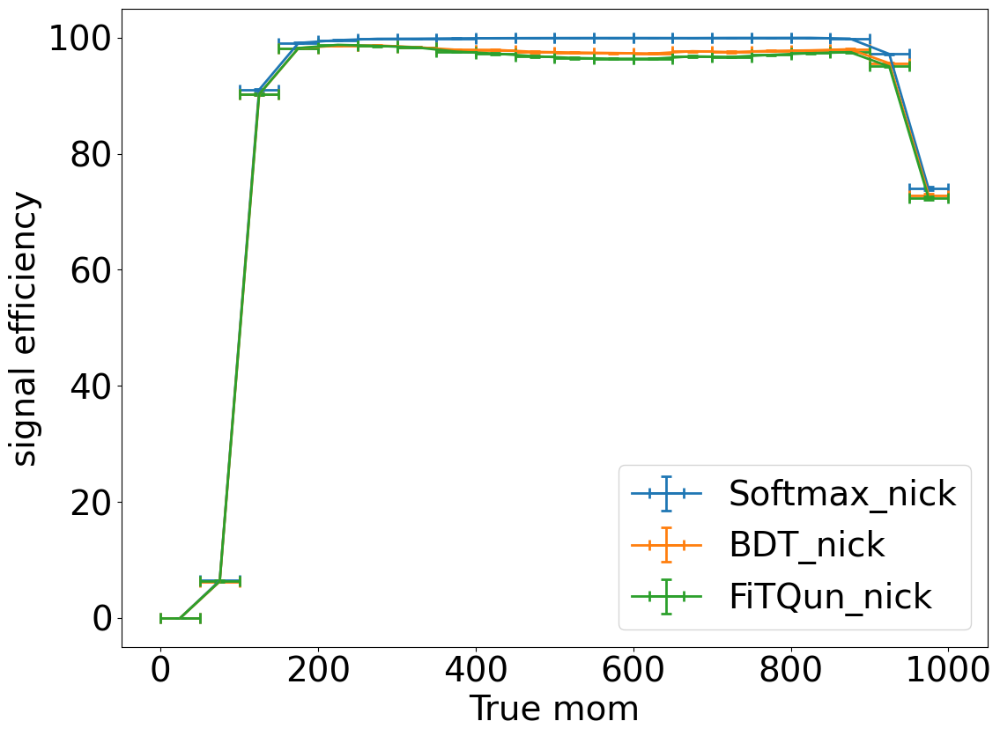

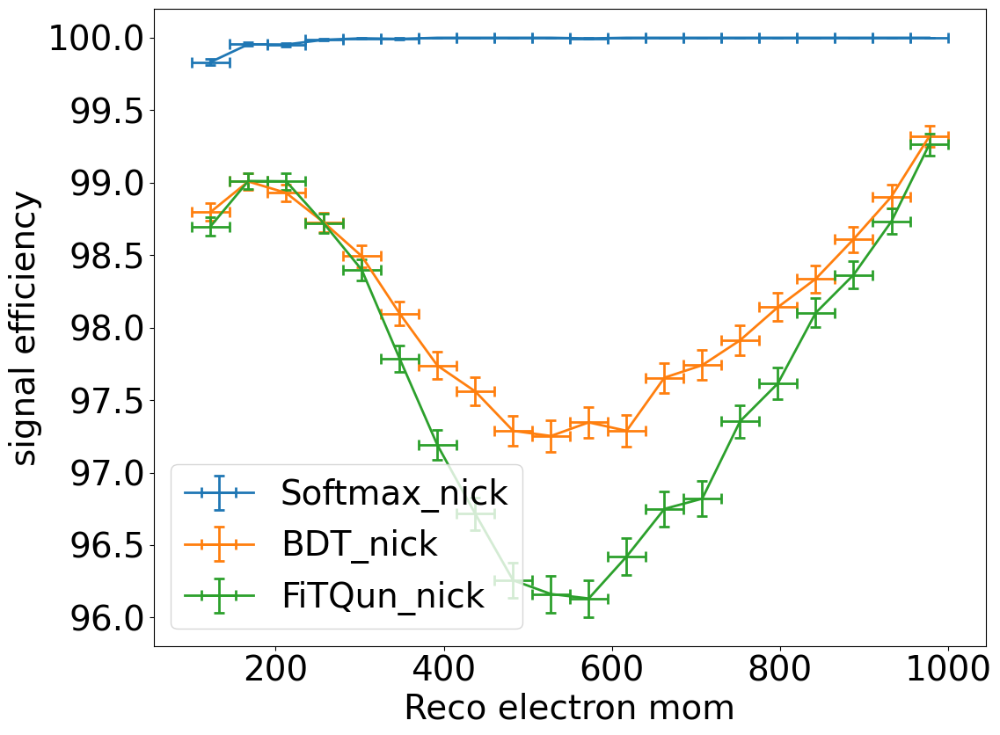

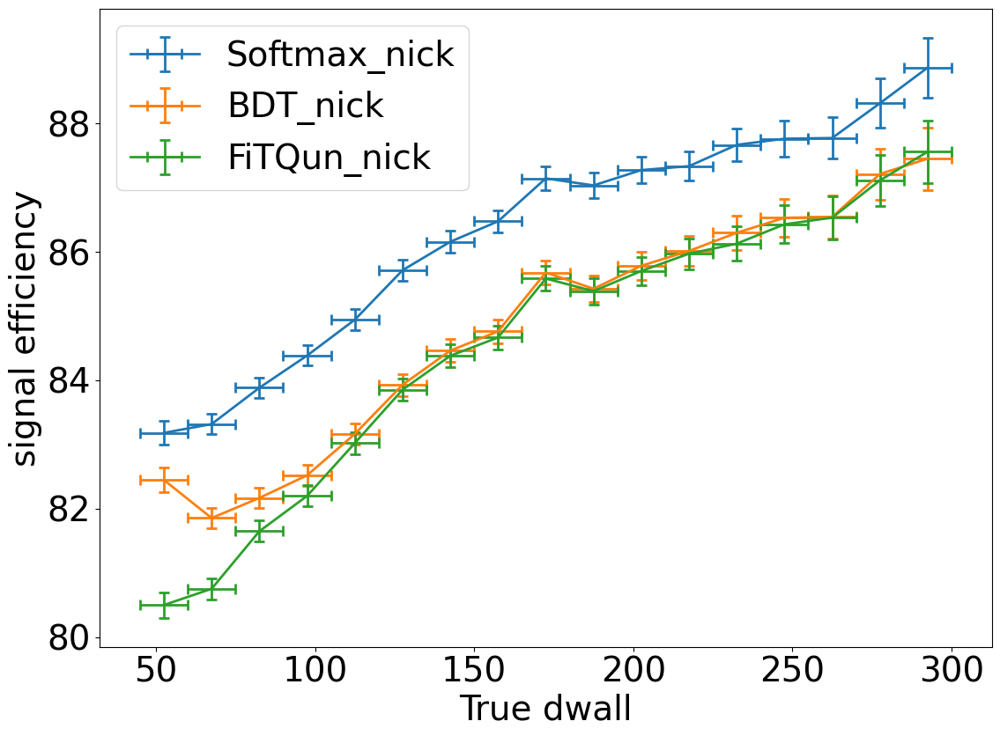

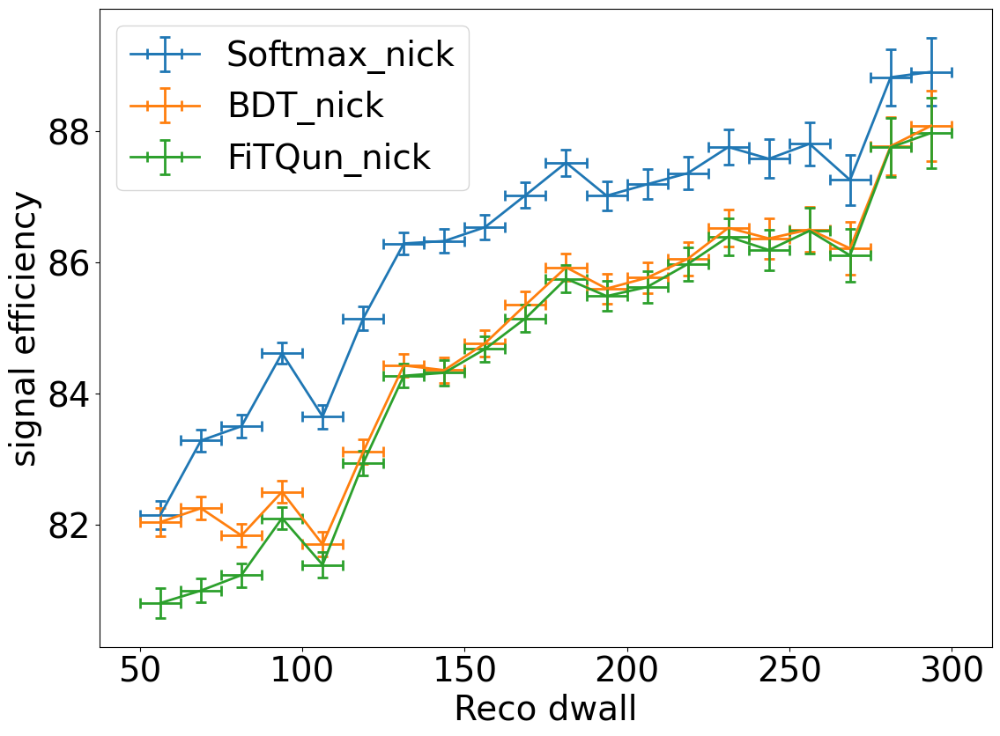

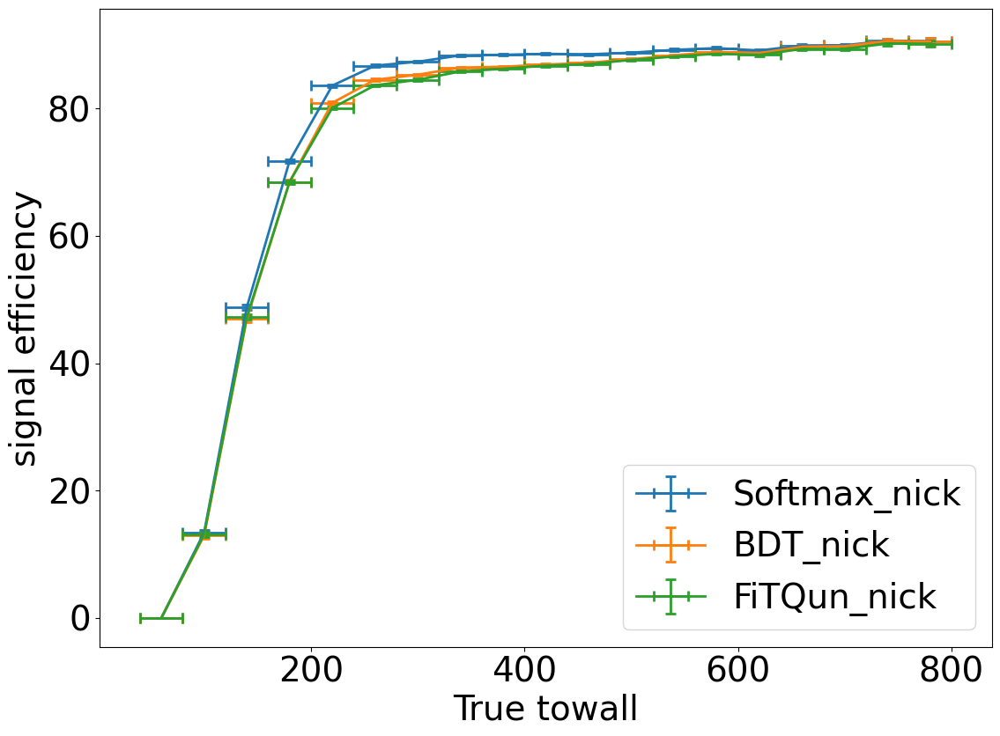

...

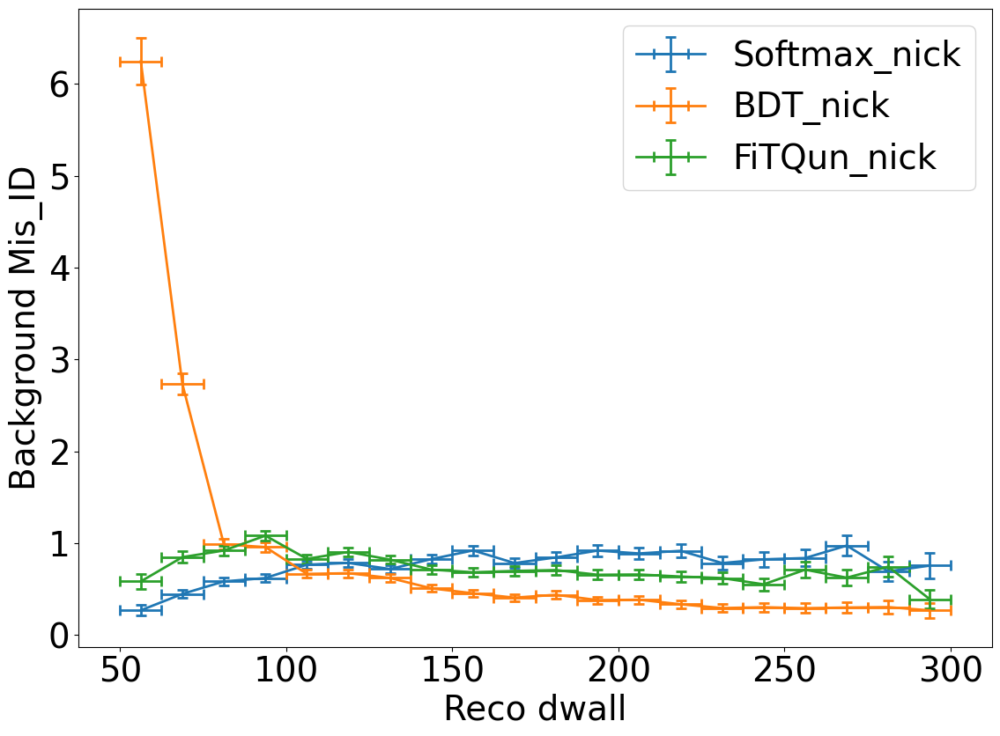

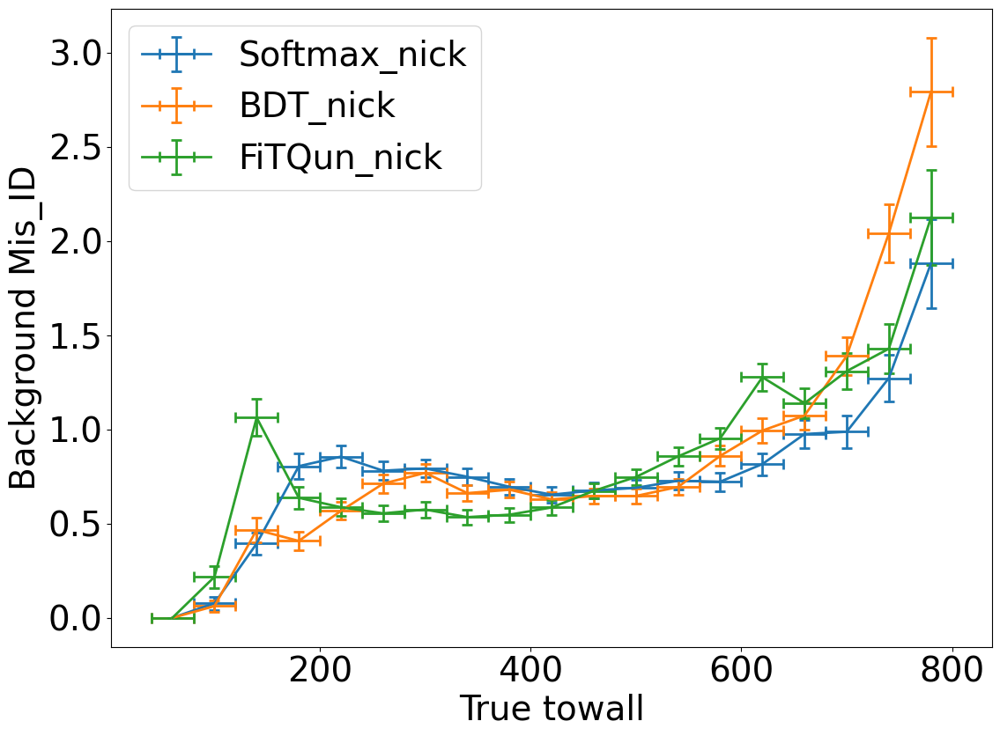

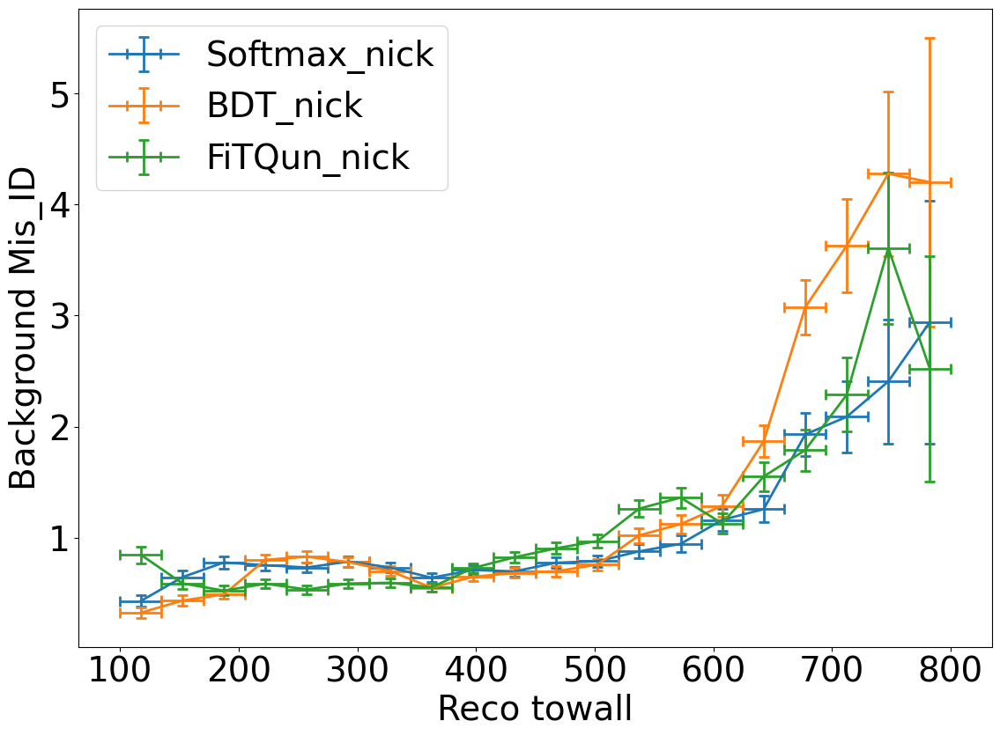

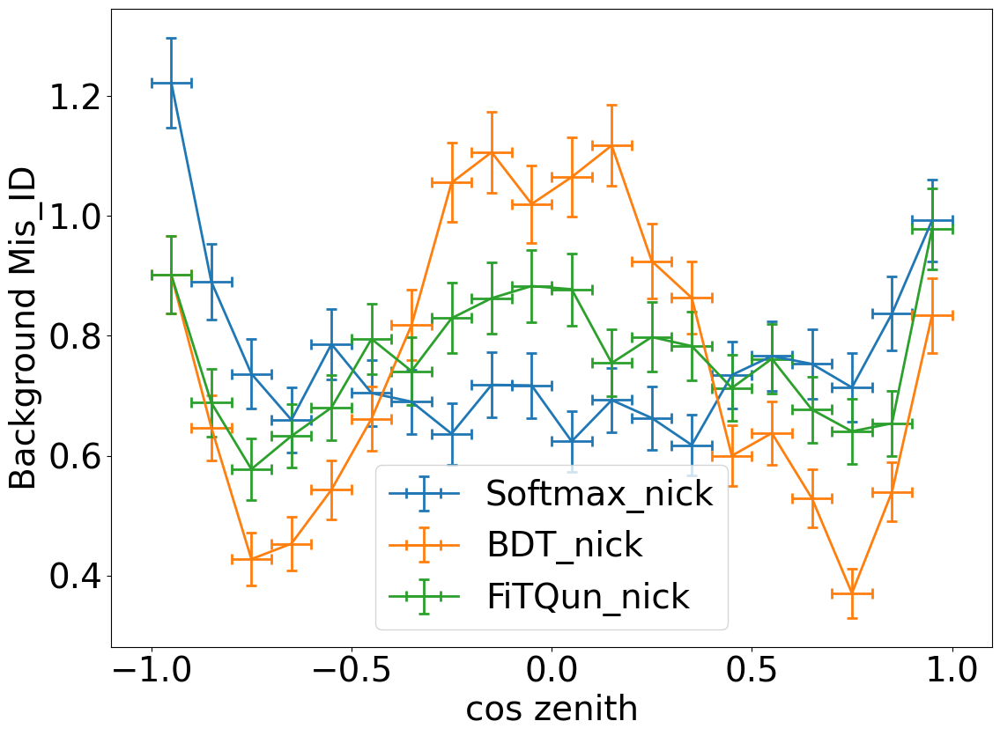

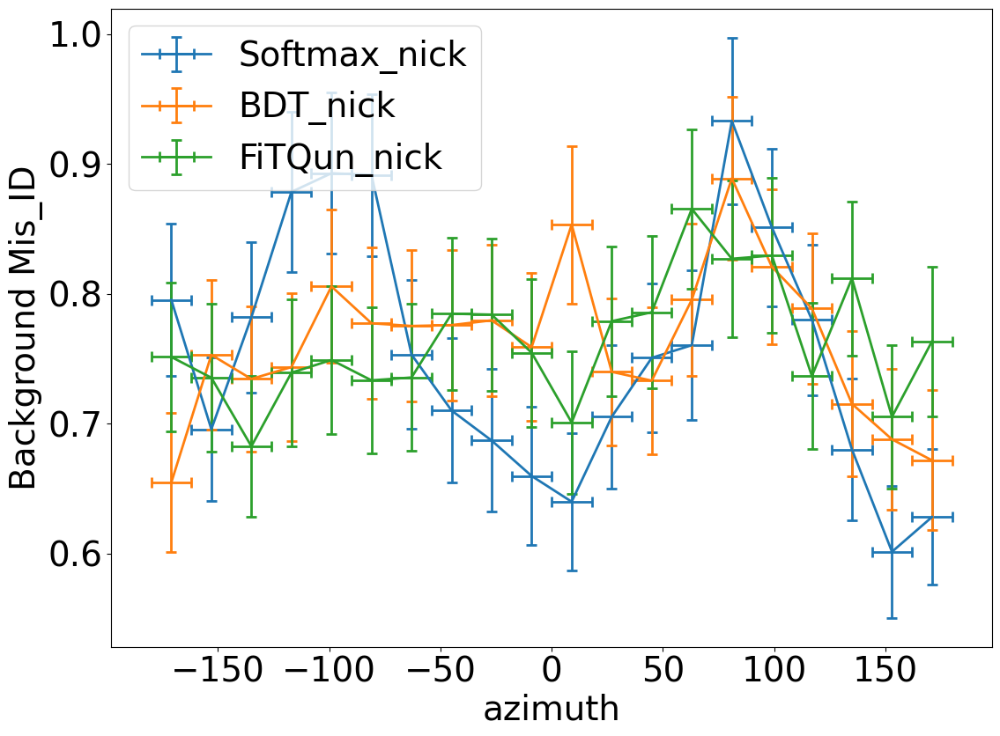

In [41]:
plot.efficiency_profile(df_nick, 1, mom_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='True mom', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, reco_mom_e_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='Reco electron mom', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, dwall_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='True dwall', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, reco_dwall_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='Reco dwall', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, towall_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='True towall', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, reco_towall_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='Reco towall', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, cos_zenith_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='cos zenith', y_label='signal efficiency')
plot.efficiency_profile(df_nick, 1, azimuth_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='azimuth', y_label='signal efficiency')

plot.efficiency_profile(df_nick, 2, mom_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='True mom', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, reco_mom_e_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='Reco electron mom', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, dwall_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='True dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, reco_dwall_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='Reco dwall', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, towall_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='True towall', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, reco_towall_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='Reco towall', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, cos_zenith_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='cos zenith', y_label='Background Mis_ID')
plot.efficiency_profile(df_nick, 2, azimuth_binning_nick, algorithms_nick, cut_array=binned_rejection_cuts_nick, x_label='azimuth', y_label='Background Mis_ID')

In [42]:
# Getting the signal efficiency and background rejection for all different binned rejection cuts before and after applying preselection
# by defining cuts using threshold which rejects 99% muons over reco mom bins

# First finding efficiency and rejection over cuts 
sig_eff = classification_metrics.sg_eff(df['true_sig'], binned_rejection_cuts)
bg_rej = classification_metrics.bg_rej(df['true_sig'], binned_rejection_cuts)

for i in range(len(sig_eff)):
    print(f"The signal count and background count for {algorithms[i]} cuts is : {np.sum(df['h5_labels'][binned_rejection_cuts[i]] == 1)}, {np.sum(df['h5_labels'][binned_rejection_cuts[i]] == 2)}")
    print(f'The signal efficiency  and background rejection for {algorithms[i]} cuts is : {round(sig_eff[i], 3)}, {round(bg_rej[i], 3)}')
    
print('\n')

sig_eff_base = classification_metrics.sg_eff(df_base['true_sig'], binned_rejection_cuts_base)
bg_rej_base = classification_metrics.bg_rej(df_base['true_sig'], binned_rejection_cuts_base)

for i in range(len(sig_eff_base)):
    print(f"The signal count and background count for {algorithms_base[i]} cuts is : {np.sum(df_base['h5_labels'][binned_rejection_cuts_base[i]] == 1)}, {np.sum(df_base['h5_labels'][binned_rejection_cuts_base[i]] == 2)}")
    print(f'The signal efficiency  and background rejection for {algorithms_base[i]} cuts is : {round(sig_eff_base[i], 3)}, {round(bg_rej_base[i], 3)}')
    
print('\n')

# Now, defining metrics using thresholds:

bins = [mom_binning, reco_mom_e_binning, dwall_binning, towall_binning]
bins_name = ['True_mom', 'reco_mom', 'true_dwall', 'true_towall']
bins_base = [mom_binning_base, reco_mom_e_binning_base, dwall_binning_base, towall_binning_base]
bins_name_base = ['True_mom_base', 'reco_mom_base', 'true_dwall_base', 'true_towall_base']


for j in range(len(bins)):
    cuts_binned = []
    cuts_binned_base = []
    for i in range(len(probs)):
        cuts_binned.append(probs[i] > binned_rejection_thresholds[i][bins[j][1]])
        cuts_binned_base.append(probs_base[i] > binned_rejection_thresholds_base[i][bins_base[j][1]])
    
    sig_eff = classification_metrics.sg_eff(df['true_sig'], cuts_binned)
    bg_rej = classification_metrics.bg_rej(df['true_sig'], cuts_binned)

    for i in range(len(sig_eff)):
        print(f'The signal efficiency  and background rejection for {algorithms[i]} cuts using {bins_name[j]} binning is : {round(sig_eff[i], 3)}, {round(bg_rej[i], 3)}')

    print('\n')

    sig_eff_base = classification_metrics.sg_eff(df_base['true_sig'], cuts_binned_base)
    bg_rej_base = classification_metrics.bg_rej(df_base['true_sig'], cuts_binned_base)

    for i in range(len(sig_eff_base)):
        print(f'The signal efficiency  and background rejection for {algorithms_base[i]} cuts using {bins_name_base[j]} binning is : {round(sig_eff_base[i], 3)}, {round(bg_rej_base[i], 3)}')
    
    print('\n')

The signal count and background count for Softmax cuts is : 1052210, 11492
The signal efficiency  and background rejection for Softmax cuts is : 0.895, 0.99
The signal count and background count for BDT cuts is : 789049, 11551
The signal efficiency  and background rejection for BDT cuts is : 0.671, 0.99
The signal count and background count for FiTQun cuts is : 584331, 11551
The signal efficiency  and background rejection for FiTQun cuts is : 0.497, 0.99


The signal count and background count for Softmax_base cuts is : 665654, 6720
The signal efficiency  and background rejection for Softmax_base cuts is : 0.97, 0.99
The signal count and background count for BDT_base cuts is : 621366, 6785
The signal efficiency  and background rejection for BDT_base cuts is : 0.905, 0.99
The signal count and background count for FiTQun_base cuts is : 545193, 6785
The signal efficiency  and background rejection for FiTQun_base cuts is : 0.794, 0.99


The signal efficiency  and background rejection for S

In [43]:
font = {'family' : 'DejaVu Sans',
        'weight' : 'normal',
        'size'   : 10}
mpl.rc('font', **font)
mpl.rcParams['figure.figsize'] = (6.4, 4.8)
mpl.rcParams["figure.autolayout"] = True

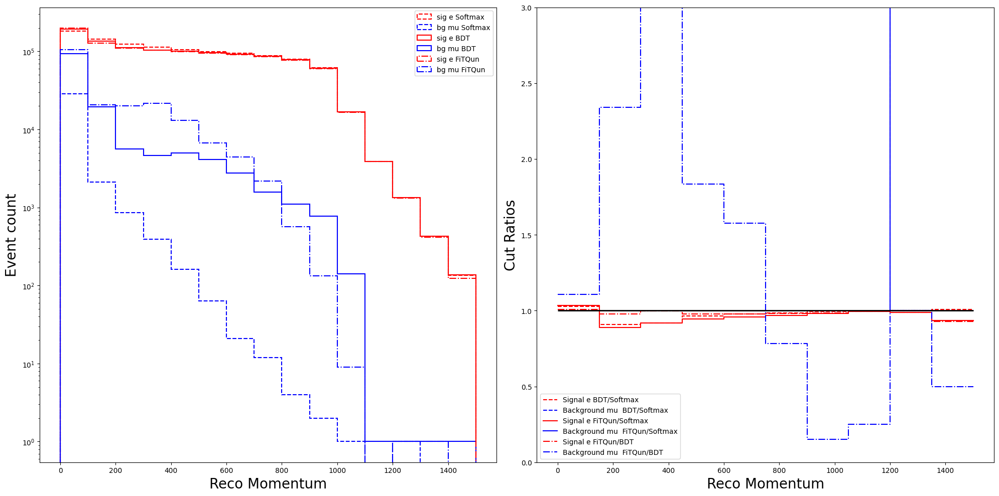

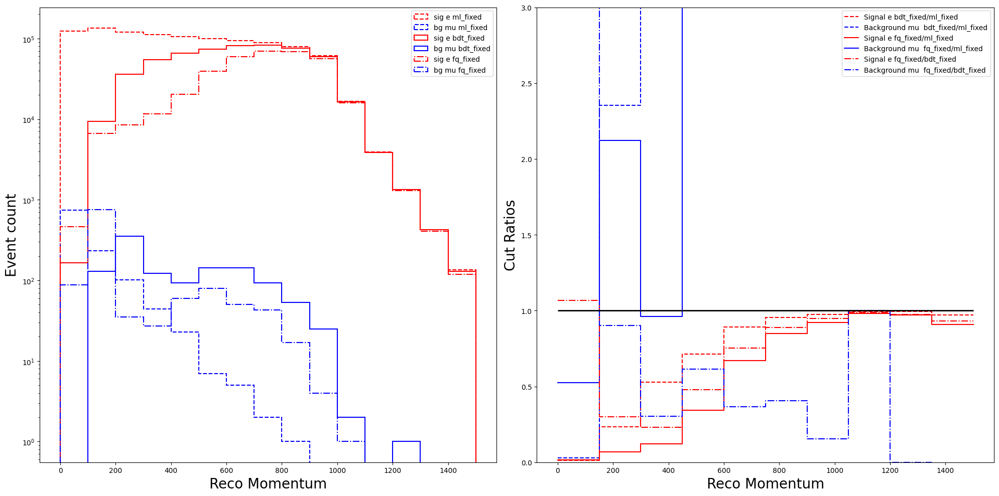

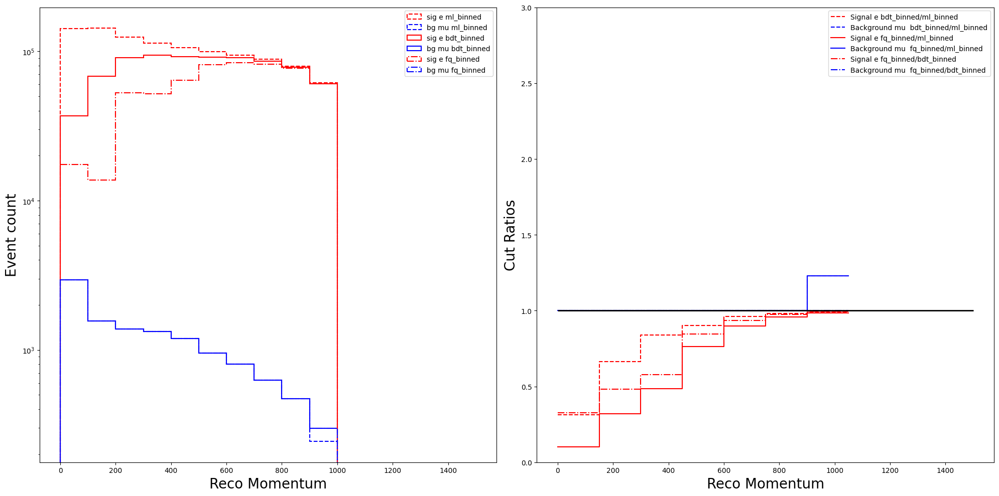

(<Figure size 2000x1000 with 2 Axes>,
 array([<AxesSubplot: xlabel='Reco Momentum', ylabel='Event count'>,
        <AxesSubplot: xlabel='Reco Momentum', ylabel='Cut Ratios'>],
       dtype=object))

In [44]:
# Plotting selection comparison histograms for different selected cuts:

plot.sel_comp(df, 1, 2, cuts, algorithms)
plot.sel_comp(df, 1, 2, fixed_rejection_cuts, ['ml_fixed', 'bdt_fixed', 'fq_fixed'])
plot.sel_comp(df, 1, 2, binned_rejection_cuts, ['ml_binned', 'bdt_binned', 'fq_binned'])


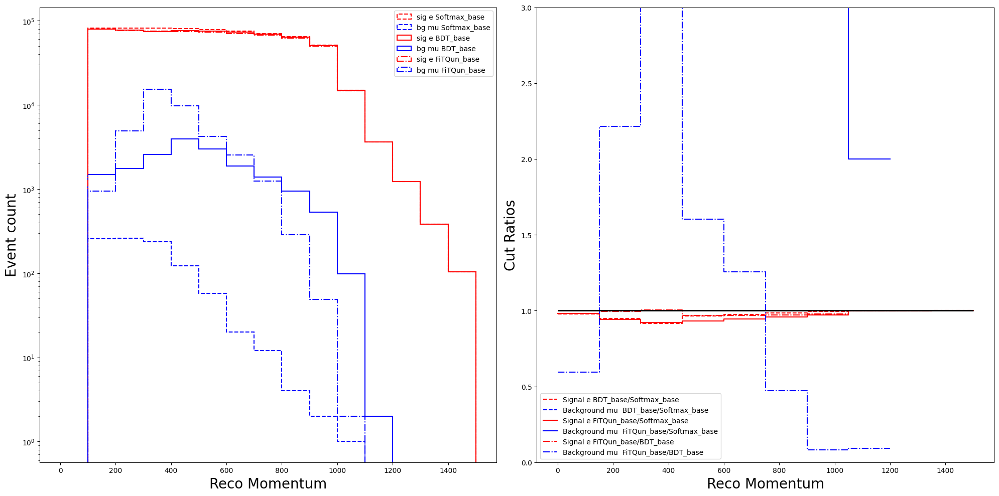

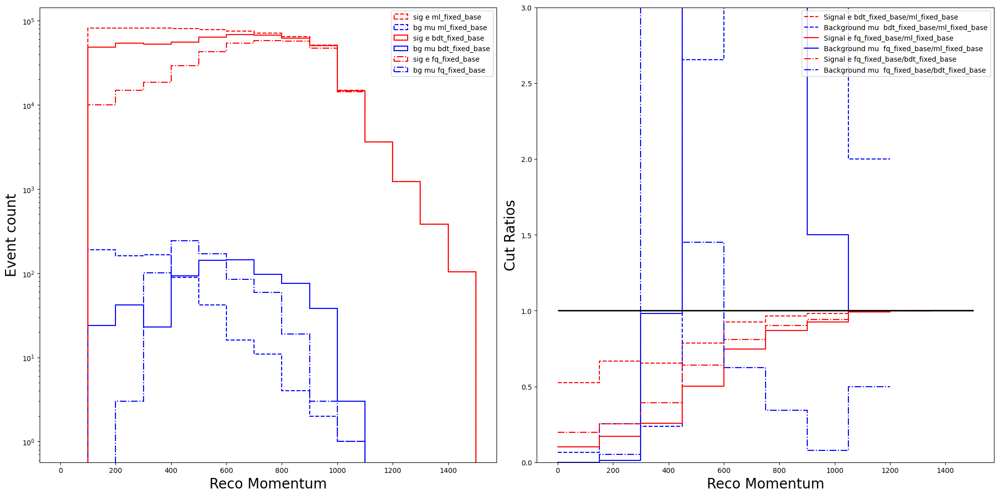

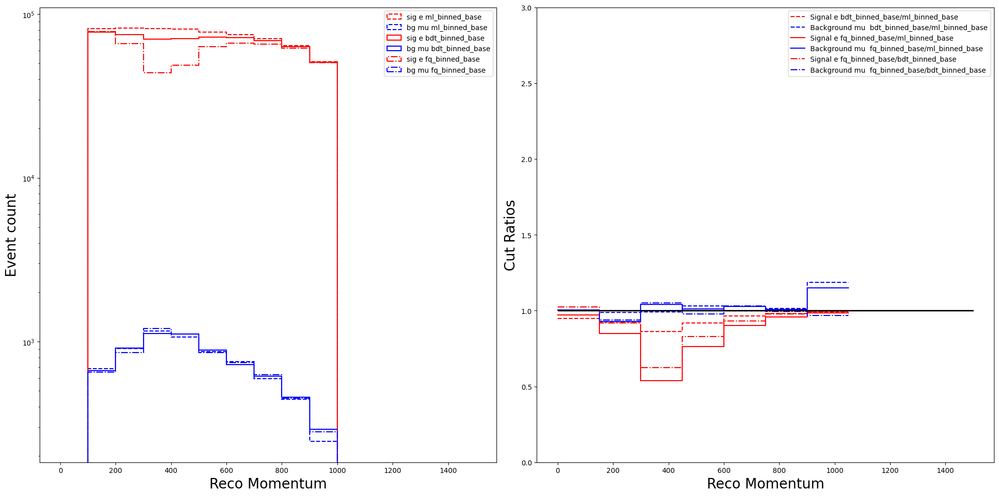

(<Figure size 2000x1000 with 2 Axes>,
 array([<AxesSubplot: xlabel='Reco Momentum', ylabel='Event count'>,
        <AxesSubplot: xlabel='Reco Momentum', ylabel='Cut Ratios'>],
       dtype=object))

In [45]:
plot.sel_comp(df_base, 1, 2, cuts_base, algorithms_base)
plot.sel_comp(df_base, 1, 2, fixed_rejection_cuts_base, ['ml_fixed_base', 'bdt_fixed_base', 'fq_fixed_base'])
plot.sel_comp(df_base, 1, 2, binned_rejection_cuts_base, ['ml_binned_base', 'bdt_binned_base', 'fq_binned_base'])


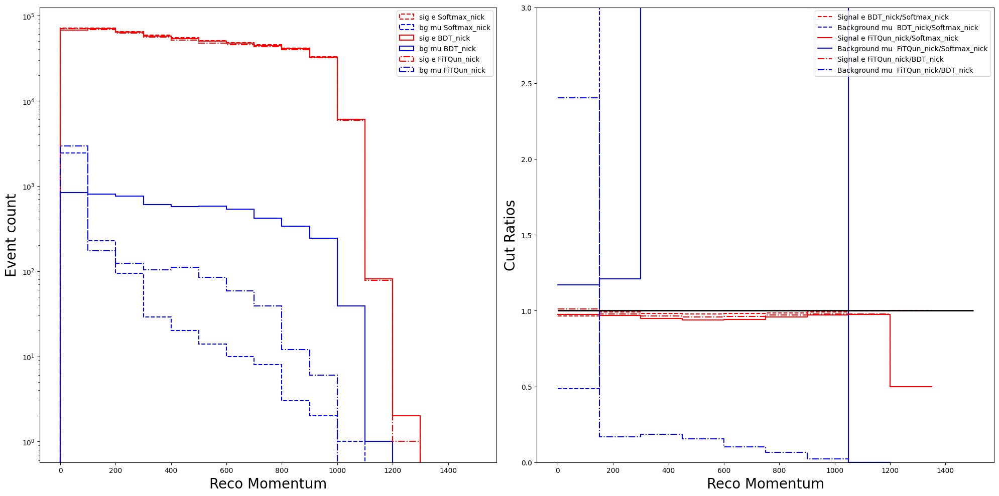

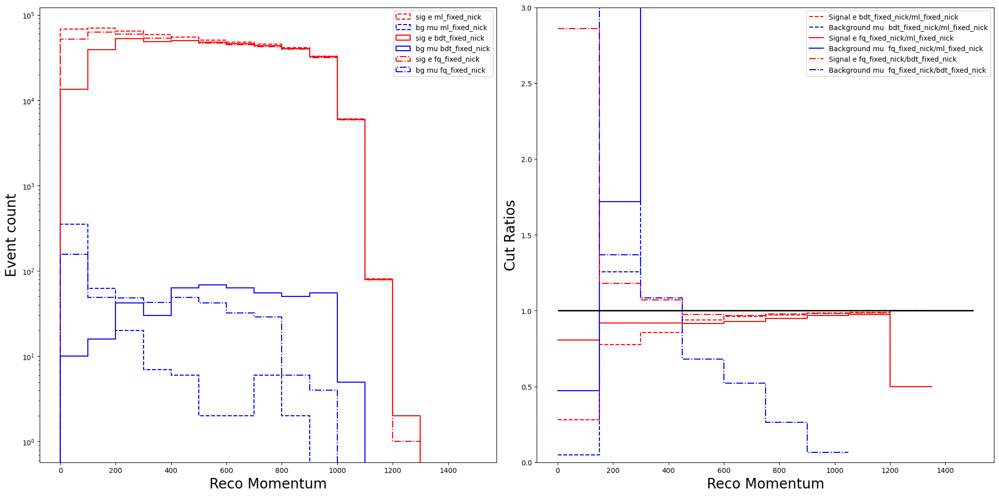

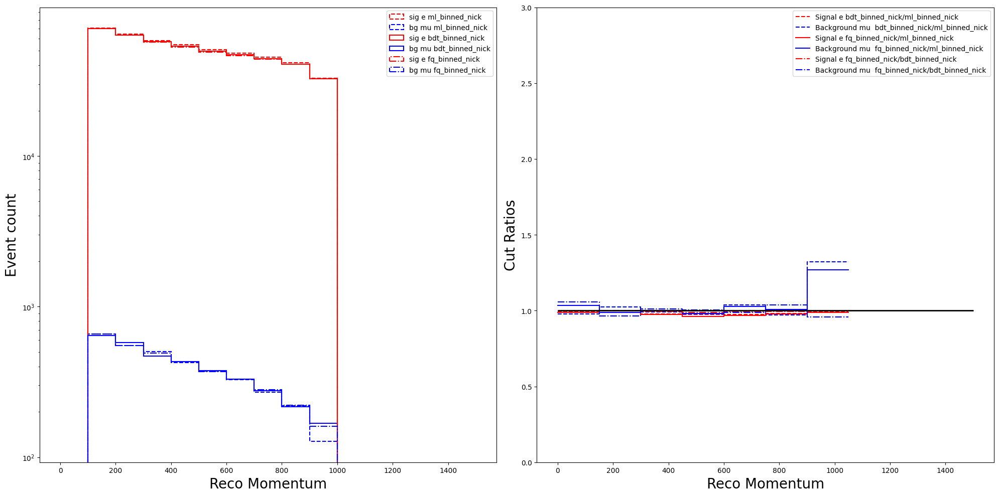

(<Figure size 2000x1000 with 2 Axes>,
 array([<AxesSubplot: xlabel='Reco Momentum', ylabel='Event count'>,
        <AxesSubplot: xlabel='Reco Momentum', ylabel='Cut Ratios'>],
       dtype=object))

In [46]:
plot.sel_comp(df_nick, 1, 2, cuts_nick, algorithms_nick)
plot.sel_comp(df_nick, 1, 2, fixed_rejection_cuts_nick, ['ml_fixed_nick', 'bdt_fixed_nick', 'fq_fixed_nick'])
plot.sel_comp(df_nick, 1, 2, binned_rejection_cuts_nick, ['ml_binned_nick', 'bdt_binned_nick', 'fq_binned_nick'])